---
**Installing important libraries:**
* xarray netCDF -> to read data from .nc files
* cartopy -> to plot map based plot using matplotlib
* imageio -> to create a gif for different frames of plots
---


In [1]:
!pip install xarray netCDF4
!pip install cartopy
!pip install imageio
!pip install pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.1/9.1 MB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 65.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 84.1 MB/s eta 0:00:00


In [2]:
# importing required functions to implement scivis
import pandas as pd
import xarray as xr
import dask.array as da
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature
from matplotlib.colors import Normalize,  ListedColormap
import matplotlib.cm as cm
from scipy.interpolate import griddata
import matplotlib.quiver as mquiver
import matplotlib.animation as animation
import imageio
from PIL import Image
import cartopy.feature as cfeature

Reading datasets:

In [3]:
vs = xr.open_dataset("vs_2019.nc")
th = xr.open_dataset("th_2019.nc")
tmmn = xr.open_dataset("tmmn_2019.nc")
tmmx = xr.open_dataset("tmmx_2019.nc")
rmax = xr.open_dataset("rmax_2019.nc")
rmin = xr.open_dataset("rmin_2019.nc")
pr = xr.open_dataset("pr_2019.nc")
sph = xr.open_dataset("sph_2019.nc")
fm_100 = xr.open_dataset("fm100_2019.nc")
vpd = xr.open_dataset("vpd_2019.nc")
pdsi = xr.open_dataset("permanent_gridmetPDSI_20190701.nc")
fm100 = xr.open_dataset("fm100_2019.nc")

/usr/local/lib/python3.10/dist-packages/xarray/coding/times.py:1001: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/usr/local/lib/python3.10/dist-packages/xarray/core/indexing.py:516: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(self.get_duck_array(), dtype=dtype)


---
**Overall overview of major function used**
---

This provides a overview of major functions used to plot various plots:  

1. Coordinate Reference Systems (CRS)
ccrs.PlateCarree(): Used as the projection in Cartopy when working with simple latitude/longitude data (i.e., a Plate Carree projection). Often a good default for regional or global maps where lat/lon coordinates are mapped directly.
2. Map Extent
ax.set_extent([west, east, south, north], crs=ccrs.PlateCarree()): Sets the displayed region of the map. Useful for focusing on specific areas (e.g., [-125, -67, 25, 50] for the contiguous United States).
3. Geographic Features
ax.coastlines(): Adds coastlines to the map, helping to frame the geographical area.
ax.add_feature(cfeature.BORDERS): Adds country borders to the map, useful for political or regional boundaries.
4. Raster and Image Plotting
imshow:
ax.imshow(data, extent=[lon_min, lon_max, lat_min, lat_max], origin='upper', cmap='BrBG', alpha=0.8, transform=ccrs.PlateCarree()):
Used to overlay raster-type data (e.g., drought indices or other gridded data) on the map. Key options include:
extent: Specifies the geographic limits.
origin: Aligns the data origin (upper or lower).
cmap: Sets the colormap, such as 'BrBG' for brown-green to highlight drought severity.
alpha: Controls transparency.
transform: Ensures data aligns correctly with the map projection.
5. Contour Plots
contourf:
ax.contourf(lon, lat, data, levels=15, cmap='coolwarm', alpha=0.5, transform=ccrs.PlateCarree()):
Used for filled contour plots to represent scalar fields like temperature.
levels: Sets the number of contour intervals.
cmap: Defines color gradients (e.g., 'coolwarm' for temperature).
alpha: Controls layer transparency.
6. Vector Field Plotting (Wind)
quiver:
ax.quiver(lon, lat, u, v, transform=ccrs.PlateCarree()): Plots wind direction and speed as arrows.
u and v are vector components derived from wind speed and direction.
streamplot:
ax.streamplot(lon, lat, u, v, color='blue', linewidth=0.5, density=1, transform=ccrs.PlateCarree()):
Creates continuous streamlines to represent fluid flow (e.g., wind).
color: Sets streamline color.
linewidth: Adjusts line thickness.
density: Controls streamline density.
7. Colorbars
fig.colorbar(): Adds a color legend, usually necessary to interpret plotted values.
Can be tied to each visual layer (e.g., temperature, drought indices) for clarity.
8. Gridlines
ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5, color='gray'):
Adds latitude and longitude gridlines, with customization options:
draw_labels: Enables axis labels.
linestyle: Sets line style (e.g., '--' for dashed).
alpha: Adjusts transparency.
9. Titles and Labels
ax.set_title(), ax.set_xlabel(), ax.set_ylabel(): Customize the map title and axis labels to convey additional information.
10. Saving the Plot
plt.savefig(filename, bbox_inches='tight', dpi=50): Saves the figure with a specific filename and resolution. bbox_inches='tight' ensures the image tightly fits around the content.
11. Image.open(filename)
Opens an image file and loads it as a Pillow Image object.
12. imageio.mimsave(output_filename, images, duration=1)
Creates an animated GIF from a list of image arrays.
duration sets the time each frame is displayed (in seconds).



Point to note:
*    One can change number of grid bins like longitude, latitude, can change value of scale, colormap, linewidth, density, alpha timestamps as needed, and dpi quality to get quality of image as required.
*   Some plots may give error in plotting or take time to upload, as some uses animation to save files to save as mp4.


In [4]:
#merging wind direction and speed data
wind_ft = xr.merge([vs, th])

In [6]:
mask = (wind_ft['day'] >= pd.Timestamp('2019-07-01')) & (wind_ft['day'] <= pd.Timestamp('2019-09-30'))


---
Wind Plot:
---

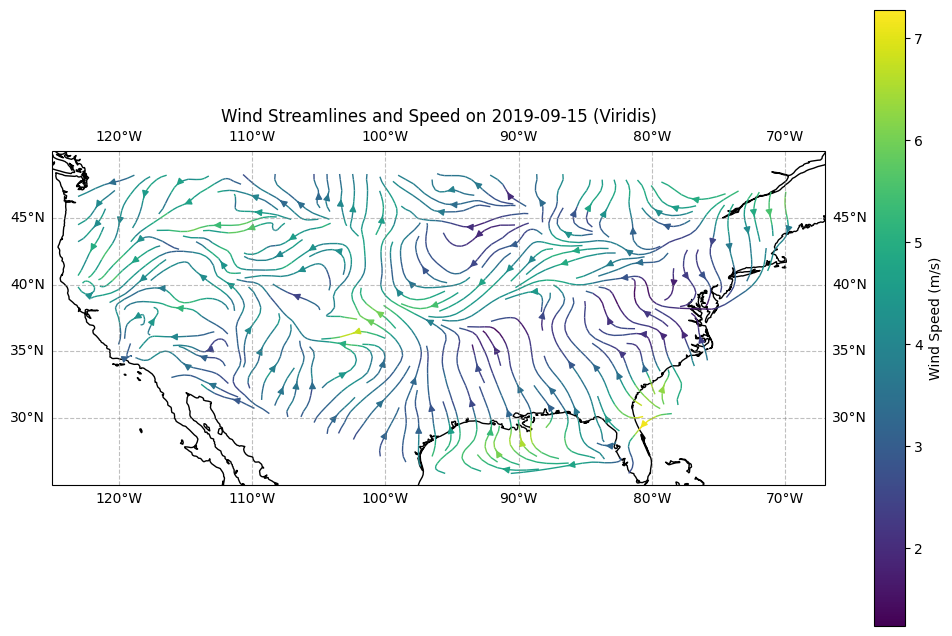

In [ ]:

fig = plt.figure(figsize=(14, 8))
gs = fig.add_gridspec(1, 2, width_ratios=[5, 0.1])
ax = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())

ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

ax.coastlines()

day_to_plot = '2019-09-15'
wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
lat_values = wind_speed_day.lat.values
lon_values = wind_speed_day.lon.values
valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

lon_valid = valid_lons[valid_mask]
lat_valid = valid_lats[valid_mask]
wind_speed_valid = wind_speed_day.values[valid_mask]
wind_direction_valid = wind_direction_day.values[valid_mask]

lon_min, lon_max = wind_ft['lon'].min().values, wind_ft['lon'].max().values
lat_min, lat_max = wind_ft['lat'].min().values, wind_ft['lat'].max().values
lon_grid = np.linspace(lon_min, lon_max, 40) # 40 points in longitude range
lat_grid = np.linspace(lat_min, lat_max, 35) # 35 points in latitude range
lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

u = grid_speed * np.cos(np.deg2rad(grid_direction))
v = grid_speed * np.sin(np.deg2rad(grid_direction))

strm = ax.streamplot(
    lon_grid, lat_grid, u, v,
    color=grid_speed,
    linewidth=1,
    cmap='viridis',
    density=2
)

cbar = plt.colorbar(strm.lines, ax=ax, orientation='vertical')
cbar.set_label('Wind Speed (m/s)')
gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
gl.xlabels_top = False
gl.ylabels_right = False

plt.title(f'Wind Streamlines and Speed on {day_to_plot} (Viridis)')
plt.savefig(f'Wind Streamlines and Speed on {day_to_plot} (Viridis)', bbox_inches='tight', dpi=50)
plt.show()

In [ ]:
def plot_streamlines_for_day(day, ax):
    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_min, lon_max = wind_ft['lon'].min().values, wind_ft['lon'].max().values
    lat_min, lat_max = wind_ft['lat'].min().values, wind_ft['lat'].max().values
    lon_grid = np.linspace(lon_min, lon_max, 40)
    lat_grid = np.linspace(lat_min, lat_max, 35)
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    strm = ax.streamplot(
        lon_grid, lat_grid, u, v,
        color='darkblue',
        linewidth=1,
        density=2
    )

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    ax.set_title(f'Wind Streamlines and Speed on {day_to_plot}')

    return strm

dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15']
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS)

def animate(i):
    ax.clear()
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)
    plot_streamlines_for_day(dates_to_plot[i], ax)

ani = animation.FuncAnimation(fig, animate, frames=len(dates_to_plot), interval=1000, repeat=True)
ani.save("wind_streamline_animation.mp4", writer="ffmpeg", dpi=150)

plt.show()


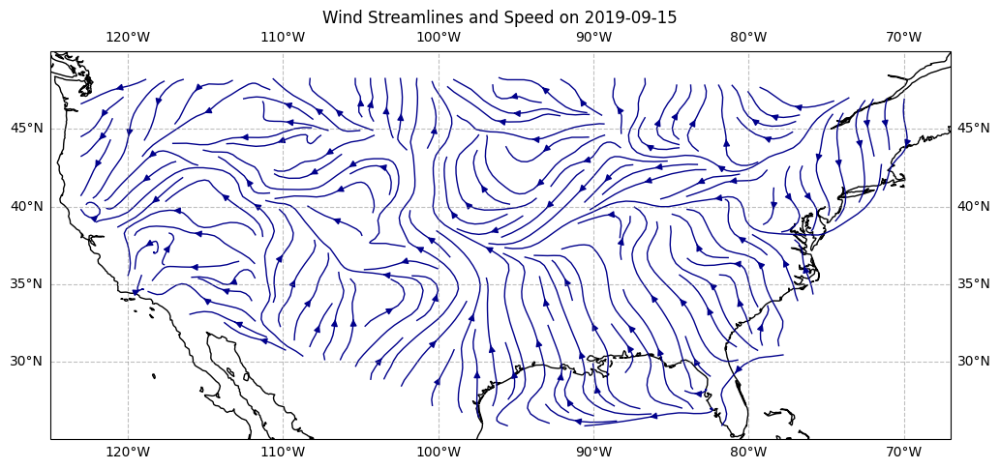

In [ ]:
def streamline_plot(day, filename):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()

    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_min, lon_max = wind_ft['lon'].min().values, wind_ft['lon'].max().values
    lat_min, lat_max = wind_ft['lat'].min().values, wind_ft['lat'].max().values
    lon_grid = np.linspace(lon_min, lon_max, 40)  # 40 points in longitude range
    lat_grid = np.linspace(lat_min, lat_max, 35)   # 35 points in latitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    strm = ax.streamplot(
        lon_grid, lat_grid, u, v,
        color='lightblue',
        linewidth=1,
        density=2
    )

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    plt.title(f'Wind Streamlines and Speed on {day_to_plot}')
    plt.savefig(filename, bbox_inches='tight', dpi=100)
    plt.show()

dates = ['2019-07-01', '2019-07-15', '2019-08-01','2019-08-15','2019-09-01', '2019-09-15']
for date in dates:
    streamline_plot(date, f'wind_streamlines_{date}_viridis.png')

In [ ]:
def streamline_plot(day, filename):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

    ax.coastlines()

    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]


    lon_min, lon_max = wind_ft['lon'].min().values, wind_ft['lon'].max().values
    lat_min, lat_max = wind_ft['lat'].min().values, wind_ft['lat'].max().values
    lon_grid = np.linspace(lon_min, lon_max, 40)  # 40 points in longitude range
    lat_grid = np.linspace(lat_min, lat_max, 35)   # 35 points in latitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    strm = ax.streamplot(
        lon_grid, lat_grid, u, v,
        color='darkblue',
        linewidth=1,
        density=2
    )
    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    plt.title(f'Wind Streamlines and Speed on {day_to_plot}')
    plt.savefig(filename, bbox_inches='tight', dpi=100)
    plt.show()

dates = ['2019-07-01', '2019-07-15', '2019-08-01','2019-08-15','2019-09-01', '2019-09-15']
for date in dates:
    streamline_plot(date, f'wind_streamlines_{date}_viridis.png')

<ipython-input-51-42605d39dae9>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  viridis = cm.get_cmap('viridis', num_categories)  # Create a colormap with discrete segments


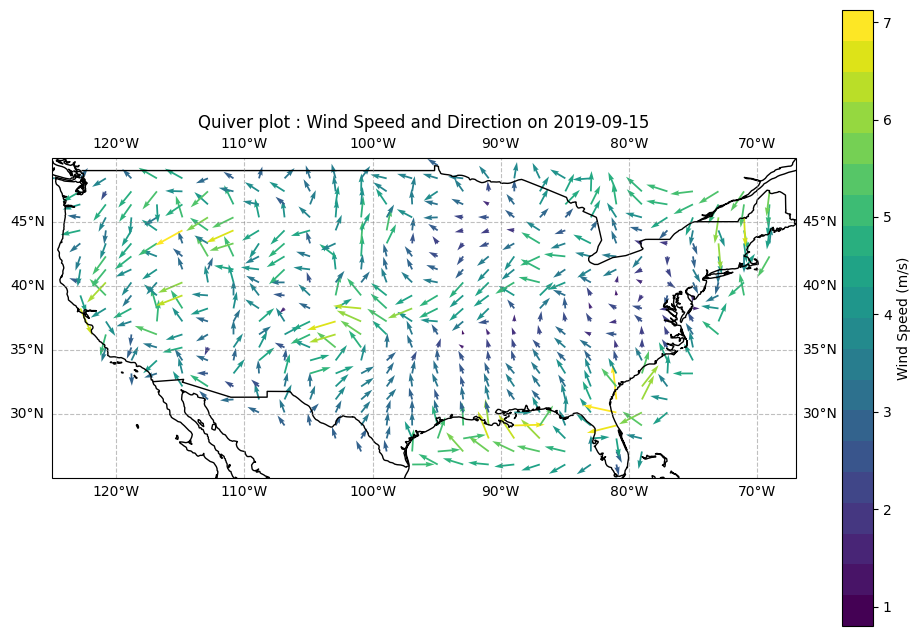

In [ ]:

fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS)

day_to_plot = '2019-09-15'
wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
lat_values = wind_speed_day.lat.values
lon_values = wind_speed_day.lon.values
valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

lon_valid = valid_lons[valid_mask]
lat_valid = valid_lats[valid_mask]
wind_speed_valid = wind_speed_day.values[valid_mask]
wind_direction_valid = wind_direction_day.values[valid_mask]
lon_min, lon_max = wind_ft['lon'].min().values, wind_ft['lon'].max().values
lat_min, lat_max = wind_ft['lat'].min().values, wind_ft['lat'].max().values

lon_grid = np.linspace(lon_min, lon_max, 30)  # 30 points in longitude range
lat_grid = np.linspace(lat_min, lat_max, 25)  # 25 points in latitude range
lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)
min_wind_speed = wind_speed_valid.min()
max_wind_speed = wind_speed_valid.max()
num_categories = 20
categories = np.linspace(min_wind_speed, max_wind_speed, num_categories + 1)  # Create edges for 20 bins

viridis = cm.get_cmap('viridis', num_categories)
colors = viridis(np.linspace(0, 1, num_categories))

cmap = ListedColormap(colors)

grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

vmin = wind_speed_day.min().values
vmax = wind_speed_day.max().values*0.75

norm = Normalize(vmin=vmin, vmax=vmax)
arrow_colors = plt.cm.viridis(norm(grid_speed))
arrow_colors = np.dstack([arrow_colors[:, :, :3], np.ones_like(grid_speed)])

u = grid_speed * np.cos(np.deg2rad(grid_direction))
v = grid_speed * np.sin(np.deg2rad(grid_direction))

q = ax.quiver(
    lon_grid, lat_grid, u, v,
    color=arrow_colors.reshape(-1, 4),
    scale=170  # Adjust the scale
)

cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, orientation='vertical')
cbar.set_label('Wind Speed (m/s)')
gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
gl.xlabels_top = False
gl.ylabels_right = False
plt.title(f'Quiver plot : Wind Speed and Direction on {day_to_plot}')
plt.savefig(f'Wind Speed and Direction on {day_to_plot}', bbox_inches='tight', dpi=100)
plt.show()


Discrete

<ipython-input-54-1aab8e30848f>:41: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  viridis = cm.get_cmap('viridis', num_categories)  # Create a colormap with discrete segments
<ipython-input-54-1aab8e30848f>:41: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  viridis = cm.get_cmap('viridis', num_categories)  # Create a colormap with discrete segments


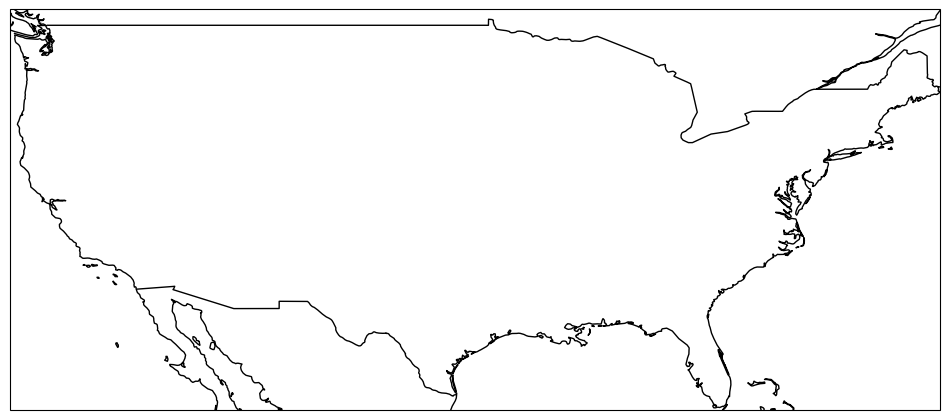

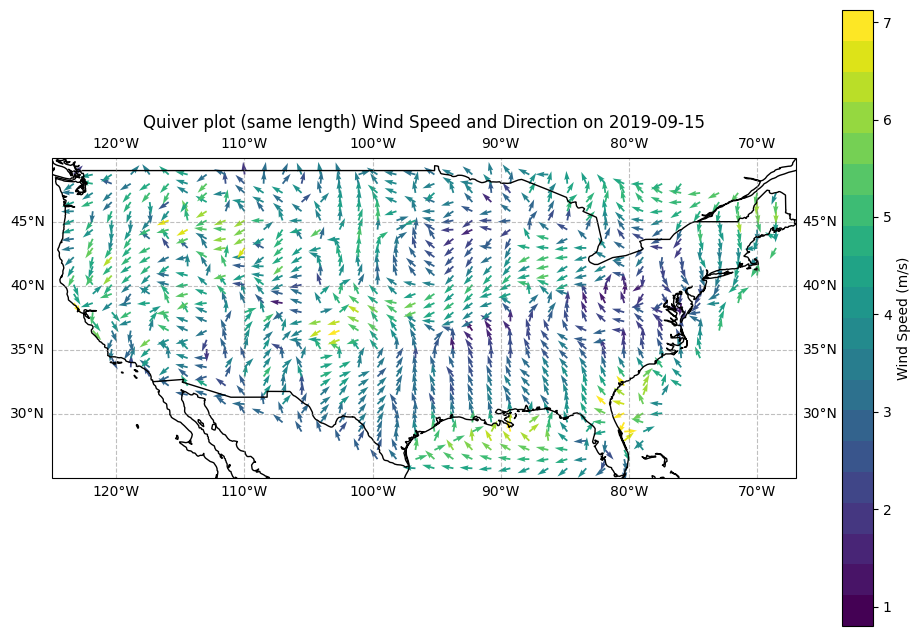

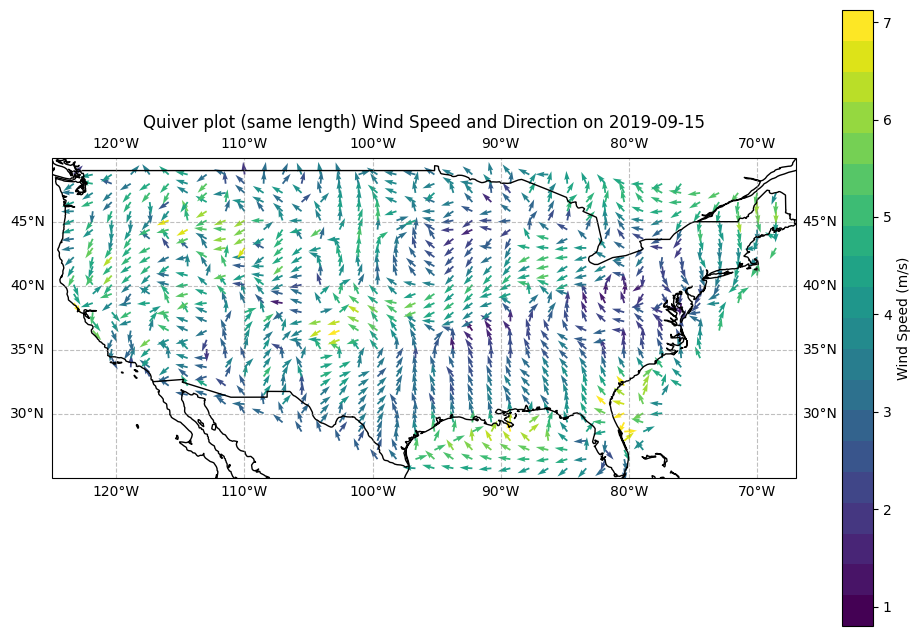

In [ ]:
def plot_wind_for_day(day):
  fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

  ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
  ax.coastlines()
  ax.add_feature(cartopy.feature.BORDERS)

  day_to_plot = day
  wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
  wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

  valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
  lat_values = wind_speed_day.lat.values
  lon_values = wind_speed_day.lon.values
  valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

  lon_valid = valid_lons[valid_mask]
  lat_valid = valid_lats[valid_mask]
  wind_speed_valid = wind_speed_day.values[valid_mask]
  wind_direction_valid = wind_direction_day.values[valid_mask]
  lon_min, lon_max = wind_ft['lon'].min().values, wind_ft['lon'].max().values
  lat_min, lat_max = wind_ft['lat'].min().values, wind_ft['lat'].max().values

  lon_grid = np.linspace(lon_min, lon_max, 40)  # 40 points in longitude range
  lat_grid = np.linspace(lat_min, lat_max, 35)  # 30 points in latitude range
  lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)
  min_wind_speed = wind_speed_valid.min()
  max_wind_speed = wind_speed_valid.max()
  num_categories = 20
  categories = np.linspace(min_wind_speed, max_wind_speed, num_categories + 1)  # Create edges for 20 bins

  viridis = cm.get_cmap('viridis', num_categories)
  colors = viridis(np.linspace(0, 1, num_categories))

  cmap = ListedColormap(colors)

  grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
  grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

  vmin = wind_speed_day.min().values
  vmax = wind_speed_day.max().values*0.75

  norm = Normalize(vmin=vmin, vmax=vmax)
  arrow_colors = plt.cm.viridis(norm(grid_speed))

  arrow_colors = np.dstack([arrow_colors[:, :, :3], np.ones_like(grid_speed)])

  u = np.cos(np.deg2rad(grid_direction))
  v = np.sin(np.deg2rad(grid_direction))

  q = ax.quiver(
      lon_grid, lat_grid, u, v,
      color=arrow_colors.reshape(-1, 4),
      scale_units='xy',
      scale= 1  # Adjust the scale
  )

  cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, orientation='vertical')
  cbar.set_label('Wind Speed (m/s)')
  gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
  gl.xlabels_top = False
  gl.ylabels_right = False
  plt.title(f'Wind Speed and Direction on {day_to_plot}')
  plt.savefig(f'wind_plot_{day}', bbox_inches='tight', dpi=100)

dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15']
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())  # Set extent once
ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS)

def animate(i):
    plot_wind_for_day(dates_to_plot[i])

ani = animation.FuncAnimation(fig, animate, frames=len(dates_to_plot), interval=1000, repeat=True)
ani.save("wind_climate_animation.mp4", writer="ffmpeg", dpi=150)

plt.show()

continuous

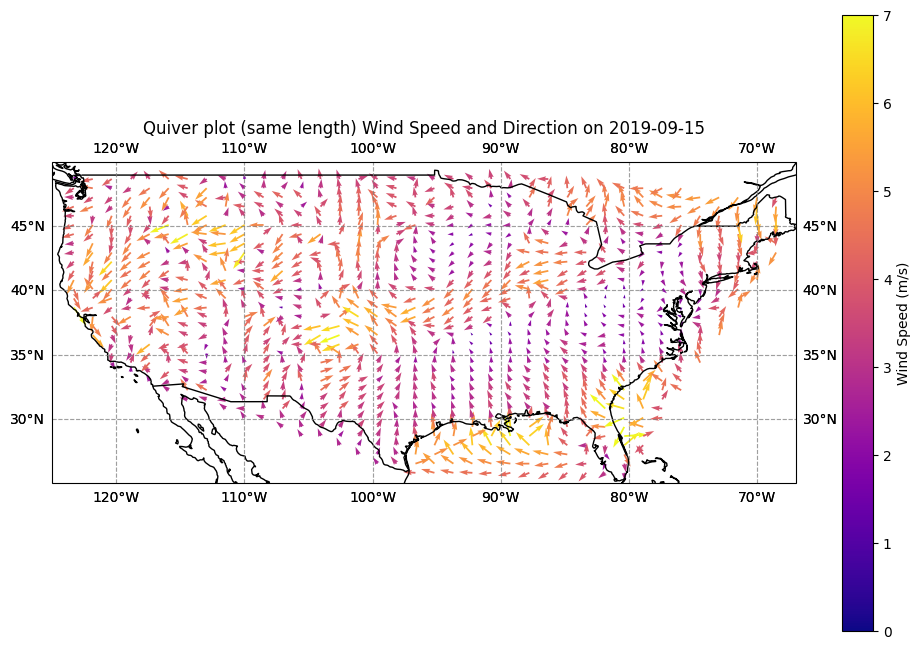

In [ ]:
from matplotlib.quiver import Quiver

cmap = cm.plasma
norm = Normalize(vmin=0, vmax=7)  # Set the range manually from seeing from preprocessing and seeing different maps

mappable = cm.ScalarMappable(norm=norm, cmap=cmap)
mappable.set_array([])

def plot_wind_for_day(day, ax):
    for artist in ax.get_children():
        if isinstance(artist, Quiver):
            artist.remove()

    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(lon_valid.min(), lon_valid.max(), 40) # 40 points in longitude range
    lat_grid = np.linspace(lat_valid.min(), lat_valid.max(), 35) # 35 points in latitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    arrow_colors = mappable.to_rgba(grid_speed)

    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    ax.quiver(
        lon_grid, lat_grid, u, v,
        color=arrow_colors.reshape(-1, 4),
        scale=250  # set scale as required
    )

    if hasattr(ax, 'cbar'):
        mappable.set_array(grid_speed.flatten())
    else:
        cbar = plt.colorbar(mappable, ax=ax, orientation='vertical')
        cbar.set_label('Wind Speed (m/s)')
        ax.cbar = cbar

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False
    ax.set_title(f'Wind Speed and Direction on {day_to_plot}')
    plt.savefig(f'wind_plot_{day}', bbox_inches='tight', dpi=100)

dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15']
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS)

def animate(i):
    plot_wind_for_day(dates_to_plot[i], ax)

ani = animation.FuncAnimation(fig, animate, frames=len(dates_to_plot), interval=1000, repeat=True)
ani.save("wind_climate_animation.mp4", writer="ffmpeg", dpi=150)

plt.show()

black

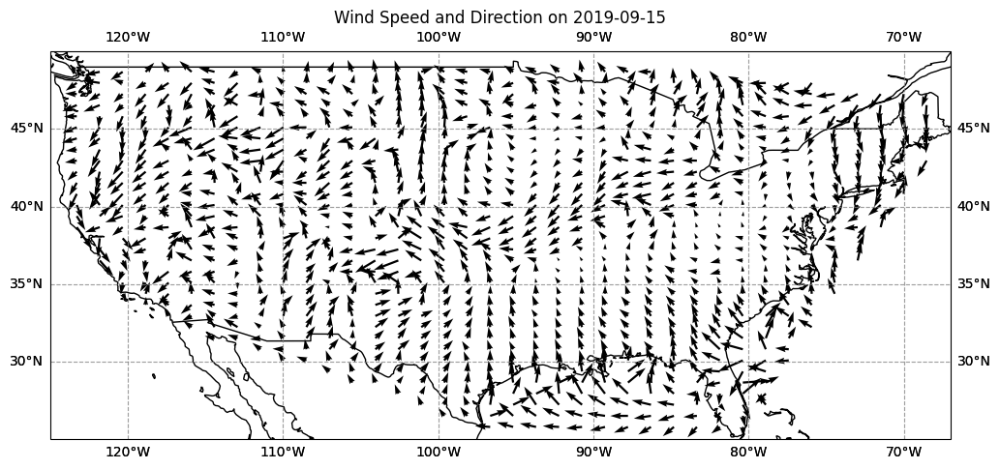

In [ ]:
from matplotlib.quiver import Quiver
def plot_wind_for_day(day, ax):
    for artist in ax.get_children():
        if isinstance(artist, Quiver):
            artist.remove()

    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(lon_valid.min(), lon_valid.max(), 40) # 40 points in longitude range
    lat_grid = np.linspace(lat_valid.min(), lat_valid.max(), 35) # 35 points in latitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    ax.quiver(
        lon_grid, lat_grid, u, v,
        color='black',  # Set the color of all arrows to black
        scale=250 # Set scale as required
    )

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False
    ax.set_title(f'Wind Speed and Direction on {day_to_plot}')
    plt.savefig(f"wind_plot_black_{day_to_plot}.png", dpi=100)

dates_to_plot = [ '2019-09-15']
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS)

def animate(i):
    plot_wind_for_day(dates_to_plot[i], ax)

ani = animation.FuncAnimation(fig, animate, frames=len(dates_to_plot), interval=1000, repeat=True)
ani.save("wind_climate_black_animation.mp4", writer="ffmpeg", dpi=150)

plt.show()

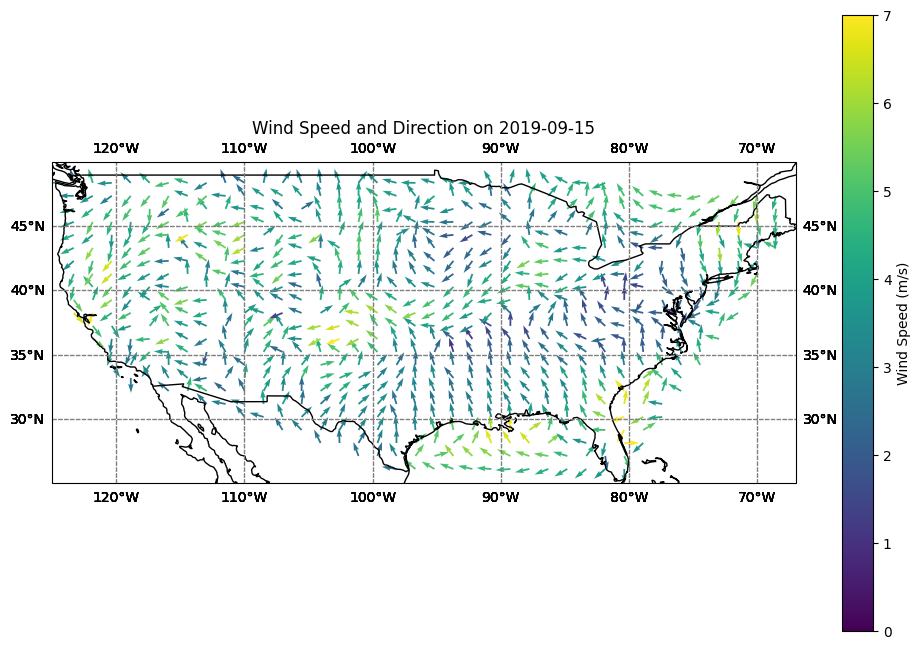

In [ ]:
from matplotlib.quiver import Quiver
cmap = cm.viridis
norm = Normalize(vmin=0, vmax=7)  # Set a limit manually by preprocessing and plotting maps

mappable = cm.ScalarMappable(norm=norm, cmap=cmap)
mappable.set_array([])

def plot_wind_for_day(day, ax):
    for artist in ax.get_children():
        if isinstance(artist, Quiver):
            artist.remove()

    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(lon_valid.min(), lon_valid.max(), 40) # 40 points in longitude range
    lat_grid = np.linspace(lat_valid.min(), lat_valid.max(), 25) # 25 points in latitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = np.cos(np.deg2rad(grid_direction))
    v = np.sin(np.deg2rad(grid_direction))

    arrow_colors = mappable.to_rgba(grid_speed)

    ax.quiver(
        lon_grid, lat_grid, u, v,
        color=arrow_colors.reshape(-1, 4),
        scale=50 # Set scale accordingly
    )

    if hasattr(ax, 'cbar'):
        mappable.set_array(grid_speed.flatten())
    else:
        cbar = plt.colorbar(mappable, ax=ax, orientation='vertical')
        cbar.set_label('Wind Speed (m/s)')
        ax.cbar = colorbar

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False
    ax.set_title(f'Wind Speed and Direction on {day_to_plot}')
    plt.savefig(f"wind_plot_{day_to_plot}.png", dpi=600)

dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15']
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS)

def animate(i):
    plot_wind_for_day(dates_to_plot[i], ax)

ani = animation.FuncAnimation(fig, animate, frames=len(dates_to_plot), interval=1000, repeat=True)
ani.save("wind_climate_same_animation.mp4", writer="ffmpeg", dpi=150)

plt.show()

In [ ]:
import matplotlib.animation as animation
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15']
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

def animate(i):
    plot_wind_for_day(dates_to_plot[i], ax)

ani = animation.FuncAnimation(fig, animate, frames=len(dates_to_plot), interval=1000, repeat=True)
plt.show()
ani.save("wind_climate_animation.mp4", writer="ffmpeg", dpi=150)

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01','2019-08-15','2019-09-01', '2019-09-15']
for day in dates_to_plot:
    plot_wind_for_day(wind_ft, day)

---
**Temperature (Hottest Month : July)**
---

local


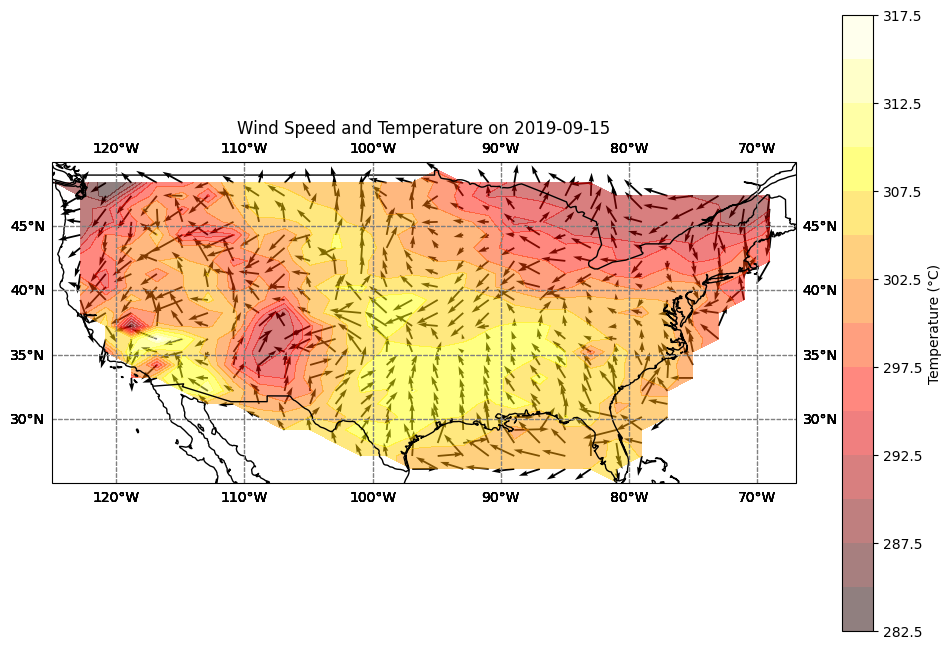

In [ ]:
from matplotlib.quiver import Quiver
from matplotlib import contour
def plot_wind_and_temp_for_day(day, ax, cbar=None):
    for artist in ax.get_children():
        if isinstance(artist, Quiver):
            artist.remove()
        elif isinstance(artist, contour.QuadContourSet):
            artist.remove()

    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    temp_day = tmmx['air_temperature'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(lon_valid.min(), lon_valid.max(), 30) # 30 points in longitude range
    lat_grid = np.linspace(lat_valid.min(), lat_valid.max(), 25) # 25 points in latitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    ax.quiver(
        lon_grid, lat_grid, u, v,
        color='black',  # Set the color of all arrows to black
        scale=150 # Set scale as required
    )

    temp_valid_mask = ~np.isnan(temp_day)
    temp_grid = griddata((lon_valid, lat_valid), temp_day.values[temp_valid_mask], (lon_grid, lat_grid), method='linear')

    temp_contour = ax.contourf(lon_grid, lat_grid, temp_grid, cmap='hot', alpha=0.5, levels=15)

    if cbar is None:
        cbar = plt.colorbar(temp_contour, ax=ax, orientation='vertical', label='Temperature (°C)')
    else:
        cbar.ax.clear()
        cbar = plt.colorbar(temp_contour, cax=cbar.ax, orientation='vertical', label='Temperature (°C)')

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False
    ax.set_title(f'Wind Speed and Temperature on {day_to_plot}')
    plt.savefig(f"temp_wind_plot_{day_to_plot}_local.png", dpi=600)
    return cbar

dates_to_plot = ['2019-07-01', '2019-07-21', '2019-07-22', '2019-07-23', '2019-08-01', '2019-09-15']
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
ax.coastlines()
ax.add_feature(cartopy.feature.BORDERS)

cbar = None

def animate(i):
    global cbar
    cbar = plot_wind_and_temp_for_day(dates_to_plot[i], ax, cbar)

ani = animation.FuncAnimation(fig, animate, frames=len(dates_to_plot), interval=1000, repeat=True)
ani.save("wind_temperature_animation.mp4", writer="ffmpeg", dpi=150)

plt.show()

Global

/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/50m_physical/ne_50m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/50m_cultural/ne_50m_admin_0_boundary_lines_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


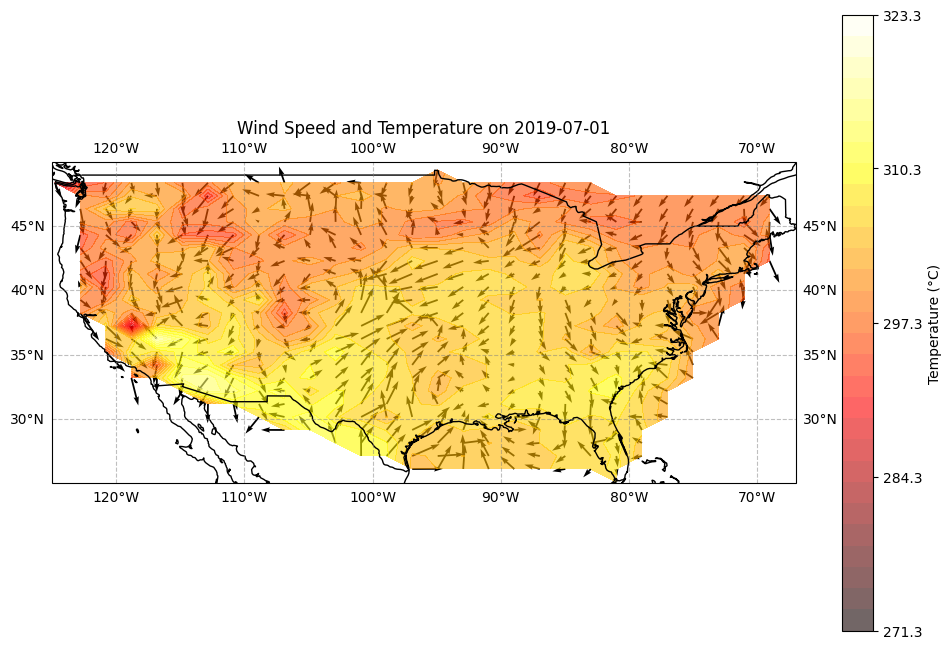

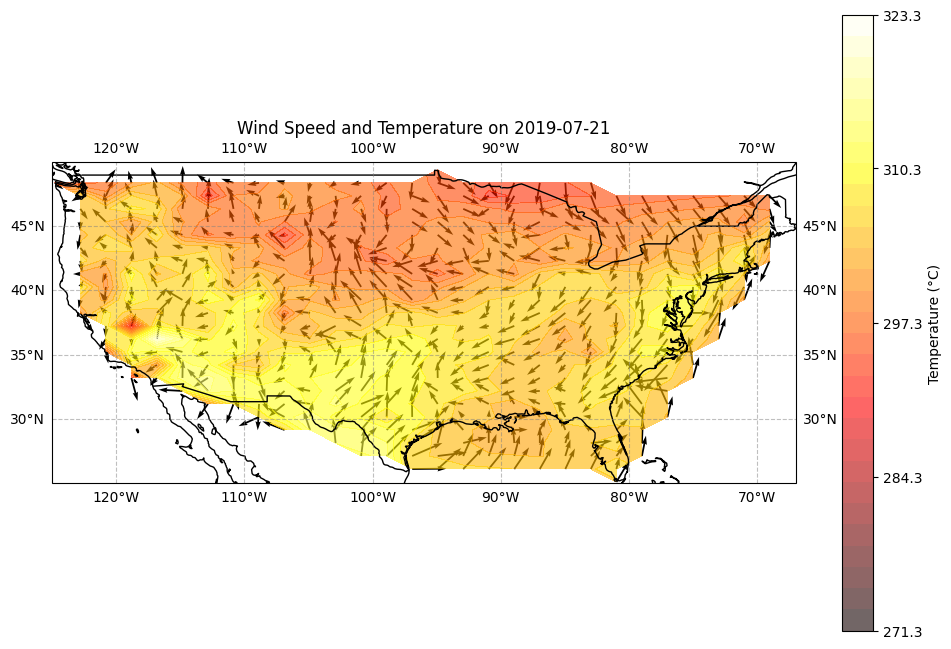

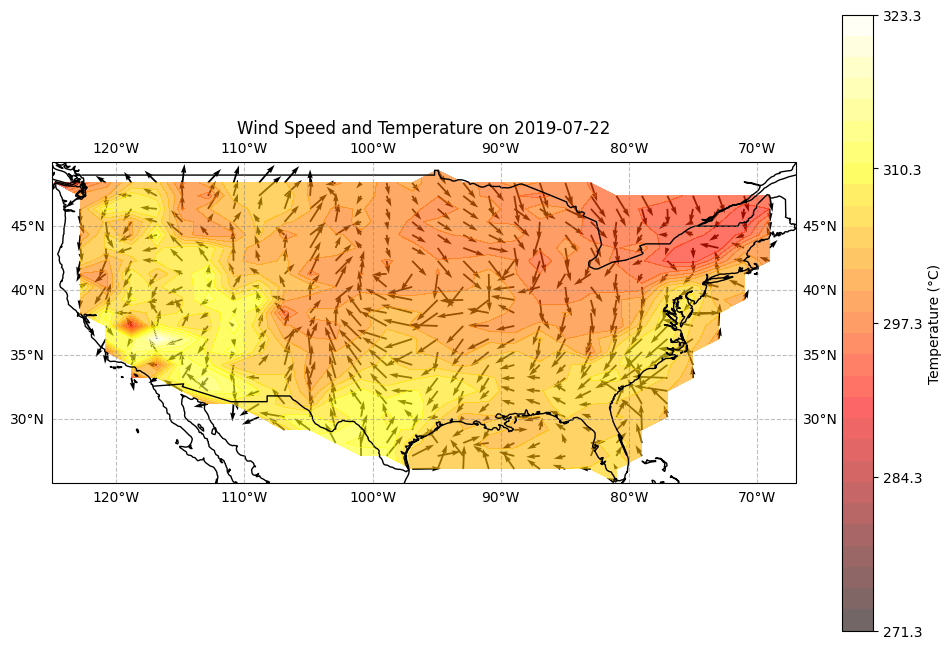

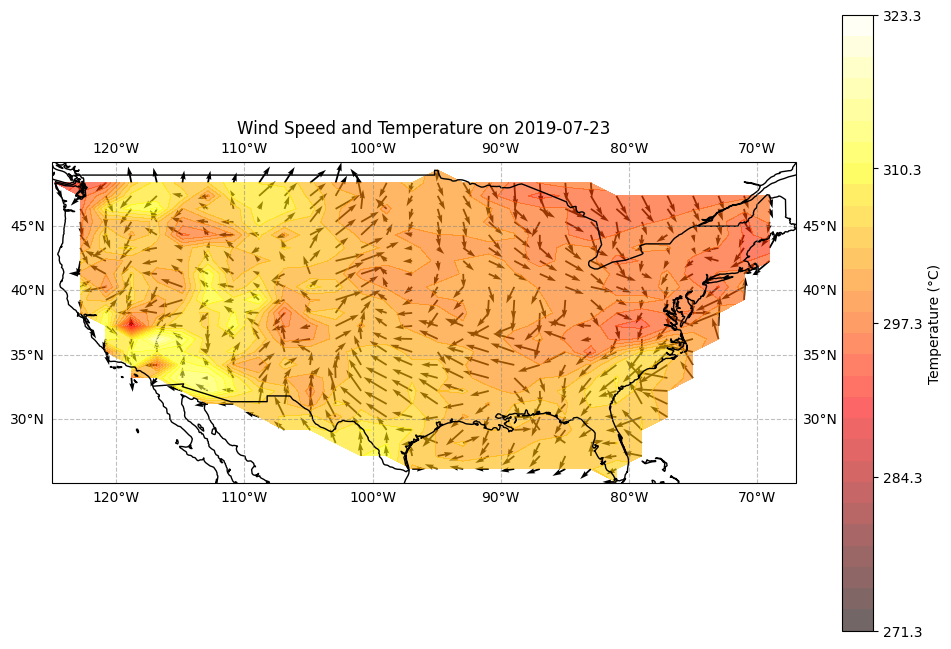

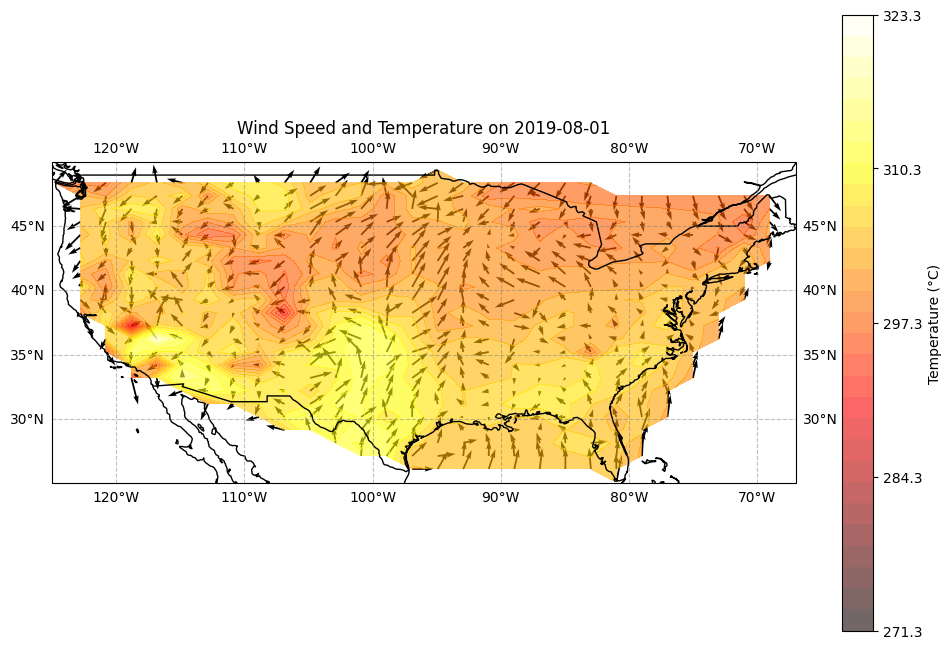

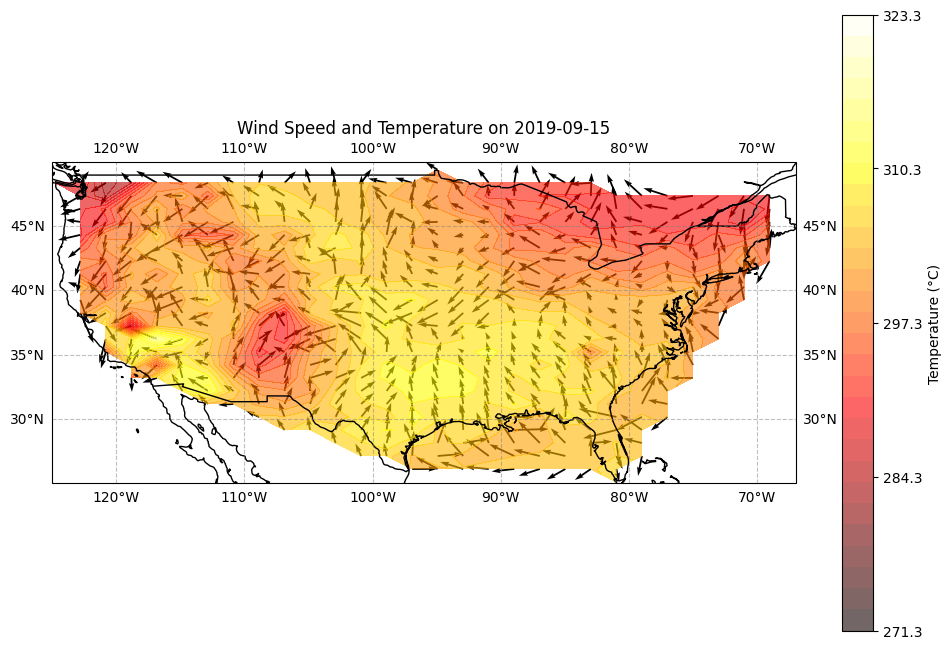

Plots saved successfully.


In [7]:
global_min_temp = float('inf')
global_max_temp = float('-inf')

# Dates to plot
dates_to_plot = ['2019-07-01', '2019-07-21', '2019-07-22', '2019-07-23', '2019-08-01', '2019-09-15']

for date in dates_to_plot:
    temp_day = tmmx['air_temperature'].sel(day=date)
    day_min = np.nanmin(temp_day)
    day_max = np.nanmax(temp_day)
    global_min_temp = min(global_min_temp, day_min)
    global_max_temp = max(global_max_temp, day_max)

def plot_wind_and_temp_for_day(day):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    wind_speed_day = wind_ft['wind_speed'].sel(day=day)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day)

    temp_day = tmmx['air_temperature'].sel(day=day)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(lon_valid.min(), lon_valid.max(), 30) # 30 points in longitude range
    lat_grid = np.linspace(lat_valid.min(), lat_valid.max(), 25) # 25 points in longitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    ax.quiver(
        lon_grid, lat_grid, u, v,
        color='black',  # Set the color of all arrows to black
        scale=150 # Set scale as required
    )

    temp_valid_mask = ~np.isnan(temp_day)
    temp_grid = griddata((lon_valid, lat_valid), temp_day.values[temp_valid_mask], (lon_grid, lat_grid), method='linear')

    temp_contour = ax.contourf(
        lon_grid, lat_grid, temp_grid, cmap='hot', alpha=0.6,
        levels=np.linspace(global_min_temp, global_max_temp, 30),
        vmin=global_min_temp, vmax=global_max_temp
    )

    cbar = plt.colorbar(temp_contour, ax=ax, orientation='vertical', label='Temperature (°C)')
    cbar.set_ticks(np.linspace(global_min_temp, global_max_temp, num=5))
    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    plt.title(f'Wind Speed and Temperature on {day}')
    plt.savefig(f"temp_wind_plot_{day}.png", dpi=50)
    plt.show()
    plt.close()

for date in dates_to_plot:
    plot_wind_and_temp_for_day(date)

print("Plots saved successfully.")


---
**Drought**
---

In [8]:
pdsi0720 = xr.open_dataset("permanent_gridmetPDSI_20190720.nc")
pdsi0801 = xr.open_dataset("permanent_gridmetPDSI_20190801.nc")
pdsi0820 = xr.open_dataset("permanent_gridmetPDSI_20190820.nc")
pdsi0901 = xr.open_dataset("permanent_gridmetPDSI_20190901.nc")
pdsi0920 = xr.open_dataset("permanent_gridmetPDSI_20190920.nc")


/usr/local/lib/python3.10/dist-packages/xarray/coding/times.py:1001: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/usr/local/lib/python3.10/dist-packages/xarray/core/indexing.py:516: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(self.get_duck_array(), dtype=dtype)
/usr/local/lib/python3.10/dist-packages/xarray/coding/times.py:1001: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/usr/local/lib/python3.10/dist-packages/xarray/core/indexing.py:516: SerializationWarning: Unable t

In [ ]:
print(type(pdsi0720))

<class 'xarray.core.dataset.Dataset'>


1. Based on only Pdsi
---



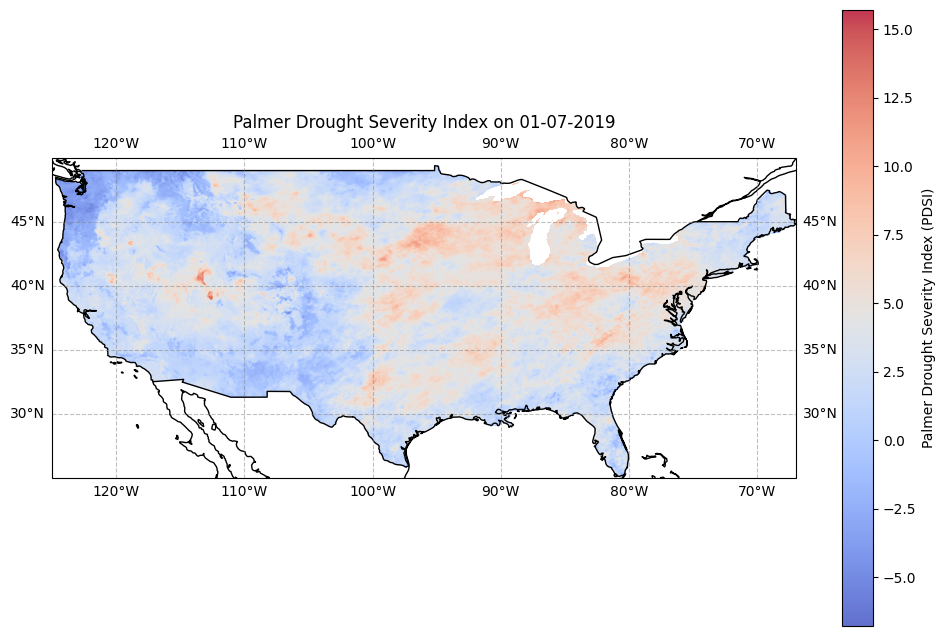

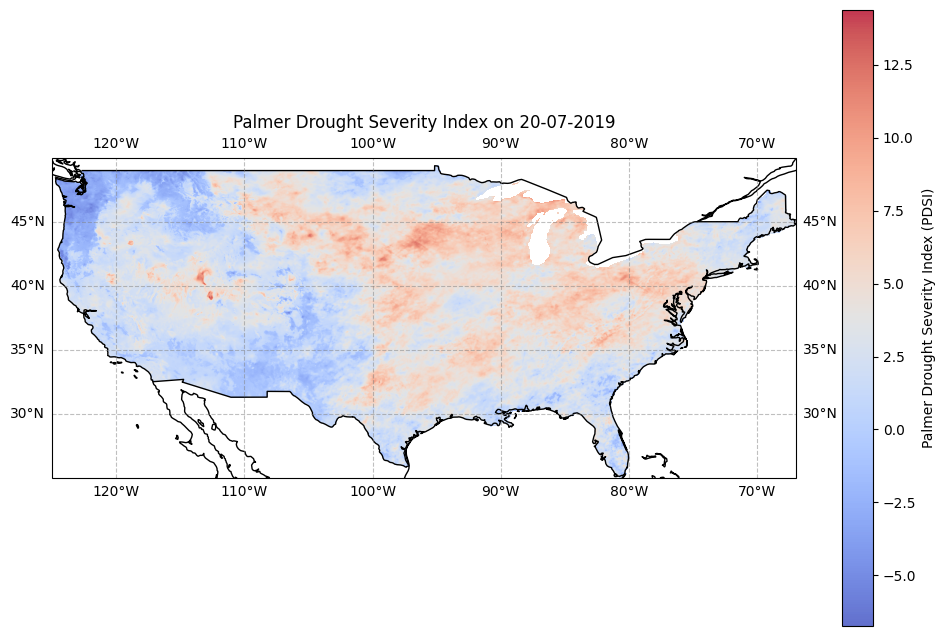

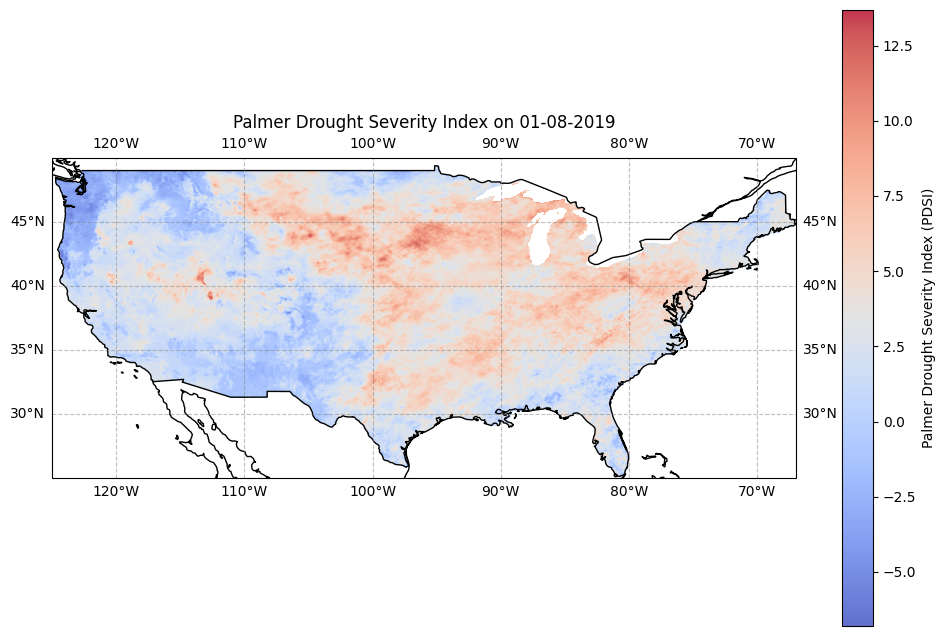

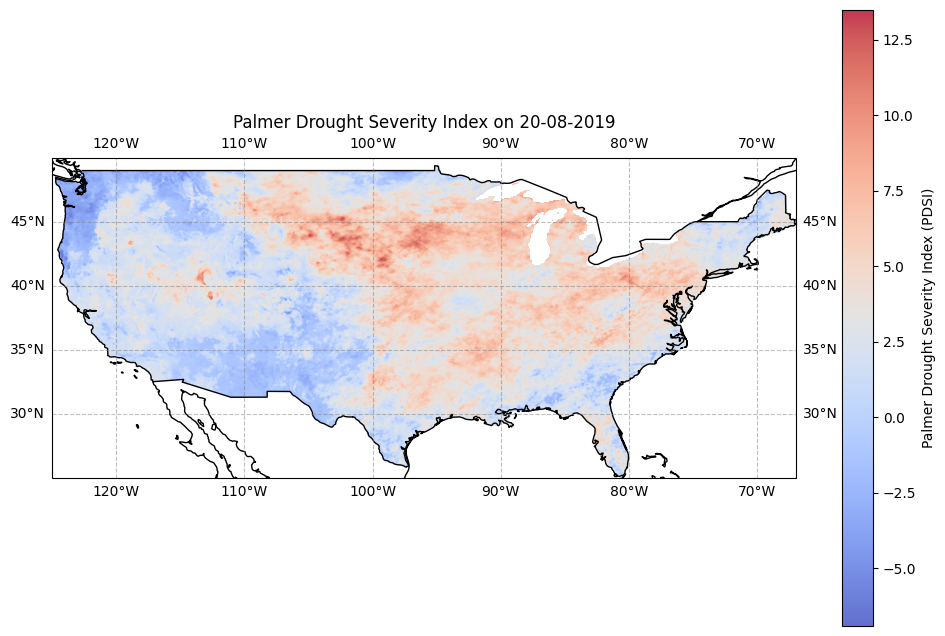

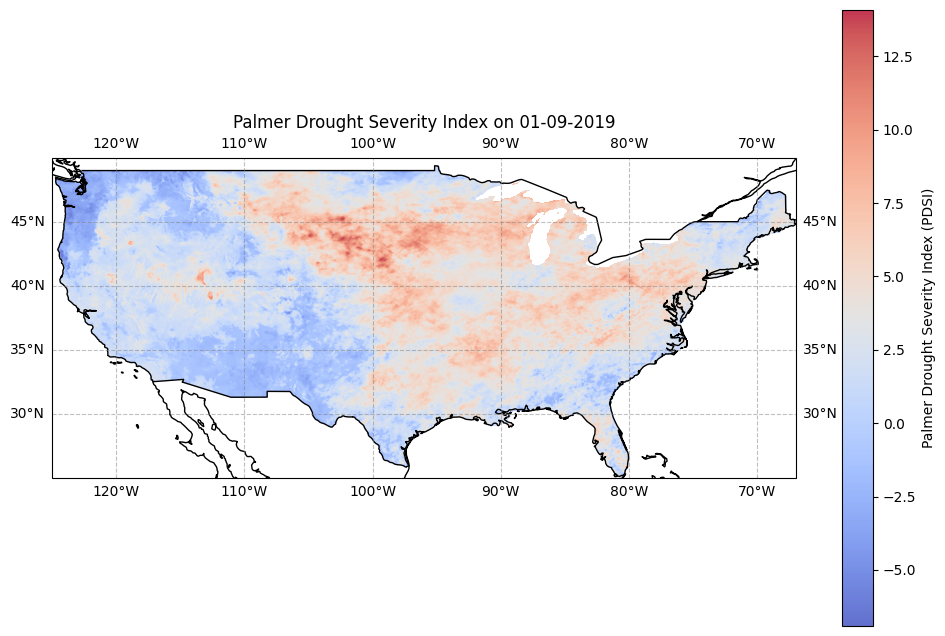

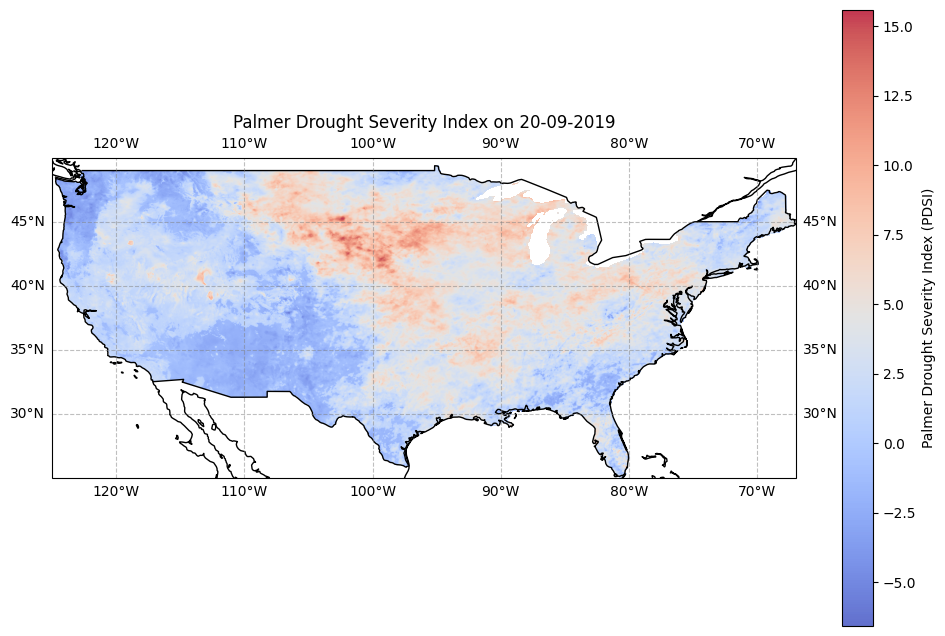

In [ ]:
import cftime
import datetime
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

def plot_pdsi(day):
    selected_day = day['palmer_drought_severity_index'].squeeze()

    cftime_date = day['day'].values[0]

    standard_date = datetime.datetime(cftime_date.year-1900, cftime_date.month, cftime_date.day-2)
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS)

    pdsi_plot = ax.imshow(
        selected_day,
        extent=[day['lon'].min(), day['lon'].max(),
                day['lat'].min(), day['lat'].max()],
        origin='upper',
        cmap='coolwarm', # set color
        alpha=0.8,
        transform=ccrs.PlateCarree()
    )

    fig.colorbar(pdsi_plot, ax=ax, label='Palmer Drought Severity Index (PDSI)')

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    ax.set_title("Palmer Drought Severity Index on " + standard_date.strftime('%d-%m-%Y'))
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    plt.savefig(f"pdsi_plot_{standard_date.strftime('%Y-%m-%d')}.png", dpi=600)
    plt.show()

dates = [pdsi,pdsi0720, pdsi0801, pdsi0820, pdsi0901, pdsi0920]

for day in dates:
    plot_pdsi(day)

In [ ]:
tmmx.head(10)

<xarray.Dataset> Size: 8kB
Dimensions:          (lon: 10, lat: 10, day: 10, crs: 1)
Coordinates:
  * lon              (lon) float64 80B -124.8 -124.7 -124.7 ... -124.4 -124.4
  * lat              (lat) float64 80B 49.4 49.36 49.32 ... 49.11 49.07 49.03
  * day              (day) datetime64[ns] 80B 2019-01-01 ... 2019-01-10
  * crs              (crs) uint16 2B 3
Data variables:
    air_temperature  (day, lat, lon) float64 8kB ...
Attributes: (12/19)
    geospatial_bounds_crs:      EPSG:4326
    Conventions:                CF-1.6
    geospatial_bounds:          POLYGON((-124.7666666333333 49.40000000000000...
    geospatial_lat_min:         25.066666666666666
    geospatial_lat_max:         49.40000000000000
    geospatial_lon_min:         -124.7666666333333
    ...                         ...
    date:                       26 April 2021
    note1:                      The projection information for this file is: ...
    note2:                      Citation: Abatzoglou, J.T., 2013, Development...
    note3:                      Data in slices after last_permanent_slice (1-...
    note4:                      Data in slices after last_provisional_slice (...
    note5:                      Days correspond approximately to calendar day...

2. Based on Pdsi and temperature
---

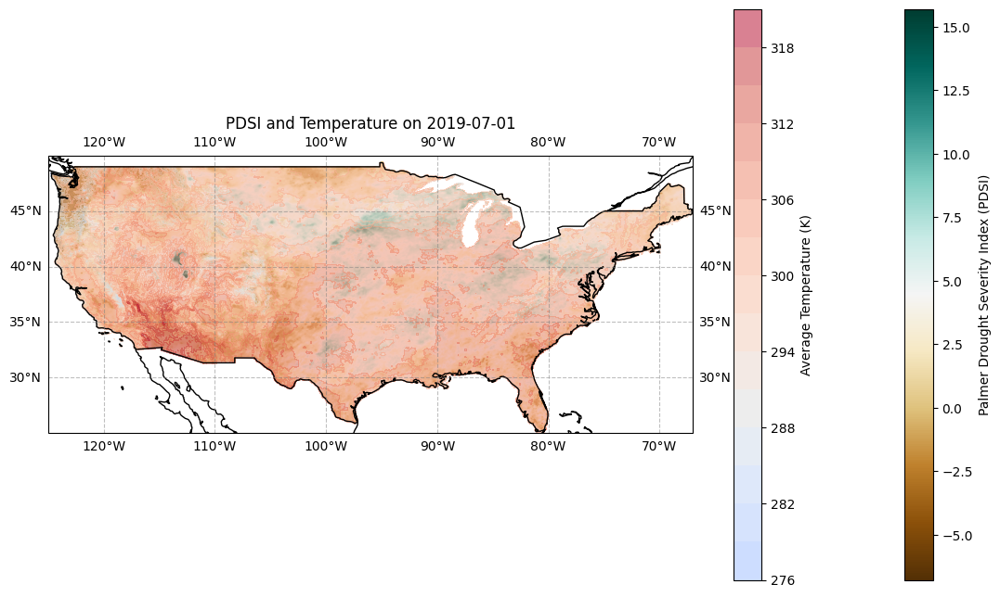

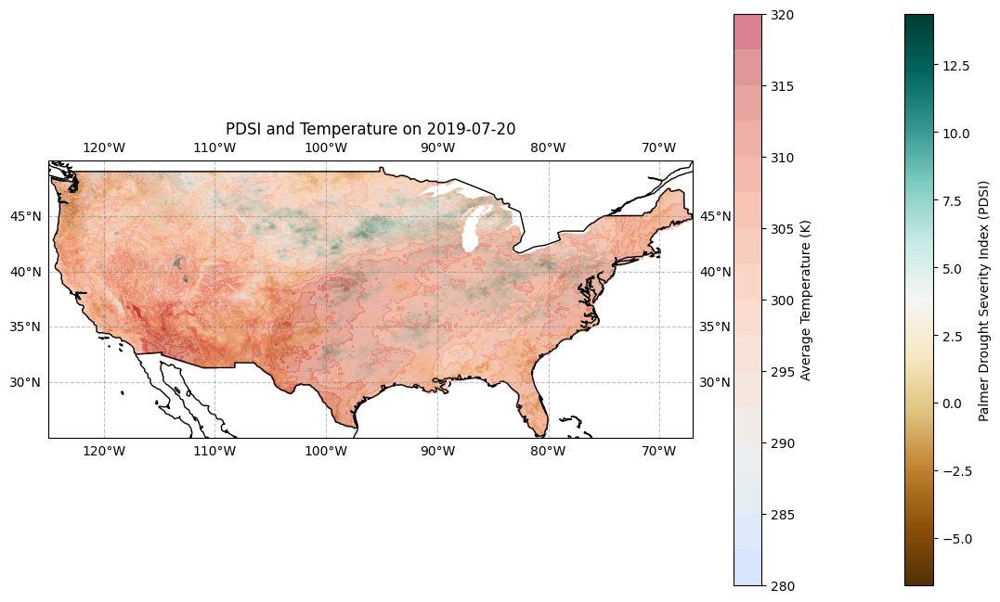

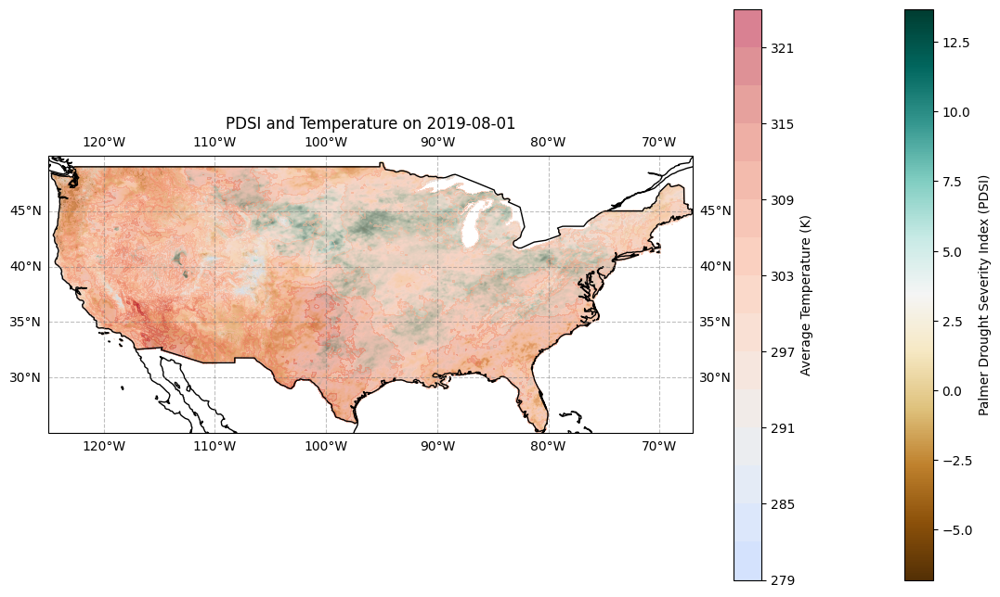

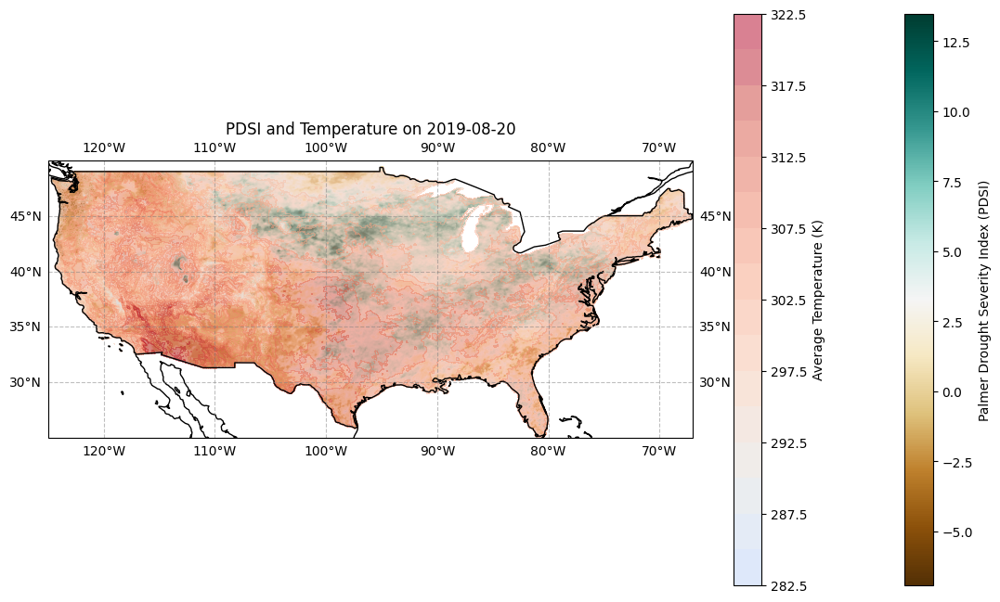

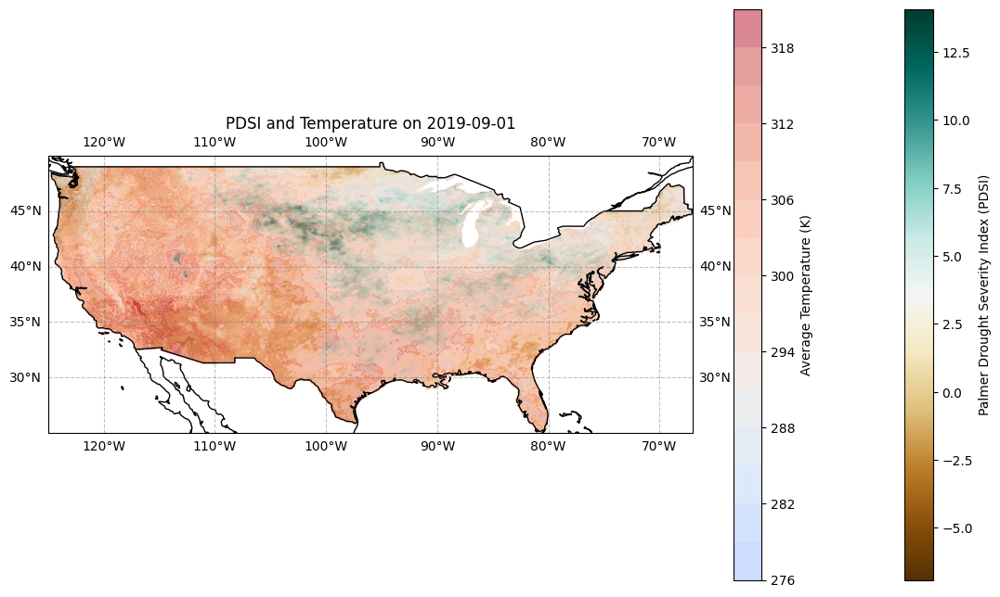

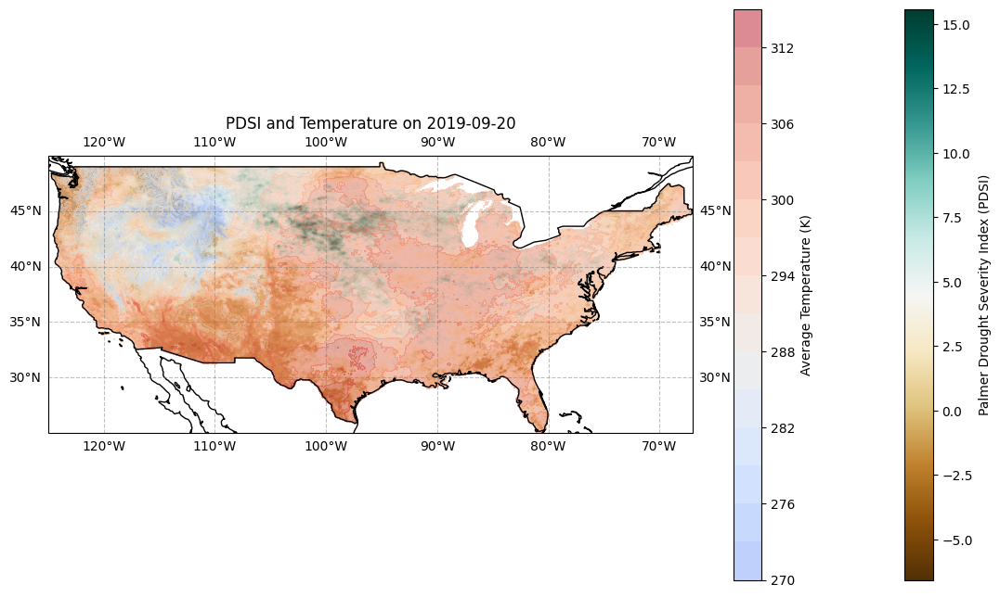

In [ ]:
import cftime
import datetime
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

def combined_plot(day_to_plot, d, save_path):
    day = day_to_plot
    selected_day = tmmx.sel(day=d)

    pdsi_selected = day['palmer_drought_severity_index'].squeeze()
    pdsi_lon = day['lon'].values
    pdsi_lat = day['lat'].values

    temp_min = 260  # Set manually by preprocessing and plotting maps
    temp_max = selected_day['air_temperature'].max().values

    fig = plt.figure(figsize=(14, 8))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS)

    pdsi_plot = ax.imshow(
        pdsi_selected,
        extent=[pdsi_lon.min(), pdsi_lon.max(),
                pdsi_lat.min(), pdsi_lat.max()],
        origin='upper',
        cmap='BrBG', # set color
        alpha=1,
        transform=ccrs.PlateCarree()
    )

    temp_contour = ax.contourf(
        selected_day['lon'],
        selected_day['lat'],
        selected_day['air_temperature'],
        levels=15,
        cmap='coolwarm', # set color
        vmin=temp_min,
        vmax=temp_max,
        alpha=0.5
    )

    cbar_pdsi = fig.colorbar(pdsi_plot, ax=ax, label='Palmer Drought Severity Index (PDSI)')
    cbar_temp = fig.colorbar(temp_contour, ax=ax, label='Average Temperature (K)')
    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    ax.set_title("PDSI and Temperature on " + str(d))
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

    plt.savefig(f"PDSI_Temperature_{d}.png", bbox_inches='tight')
    plt.show()

dates = [pdsi, pdsi0720, pdsi0801, pdsi0820, pdsi0901, pdsi0920]
dates1 = ['2019-07-01', '2019-07-20', '2019-08-01', '2019-08-20', '2019-09-01', '2019-09-20']
save_path = './plots'

for i in range(len(dates)):
    combined_plot(dates[i], dates1[i], save_path)

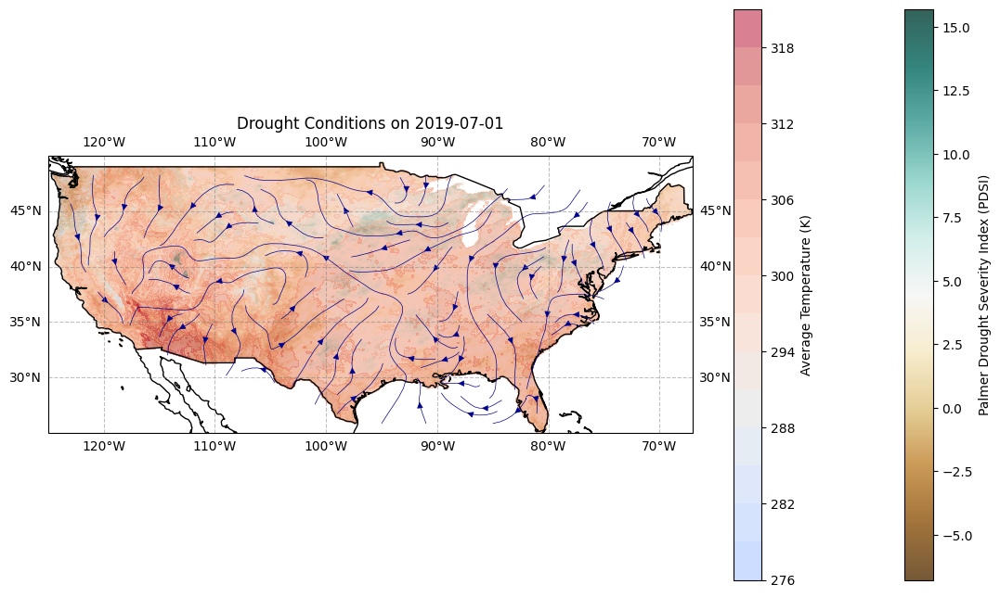

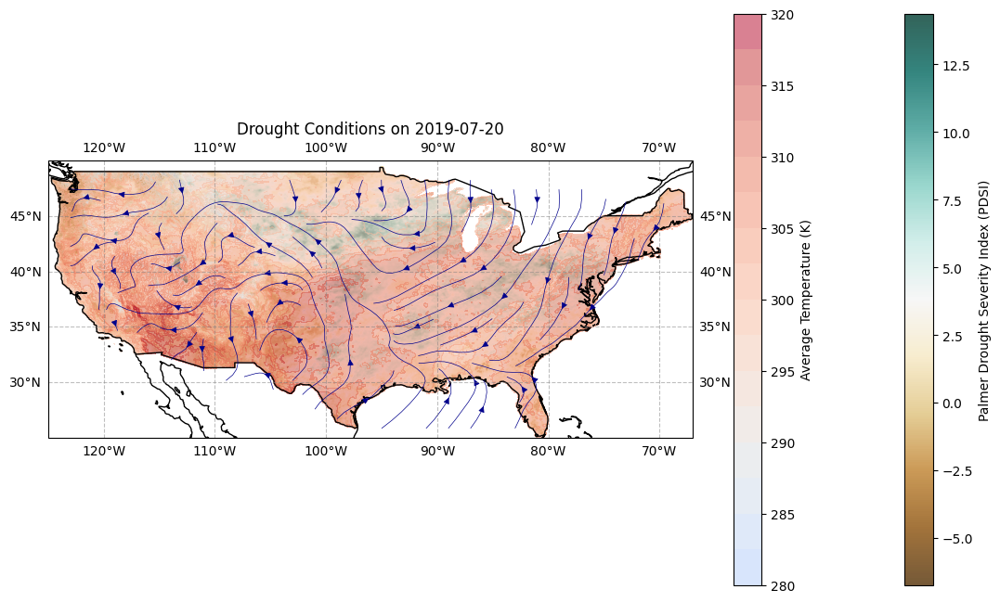

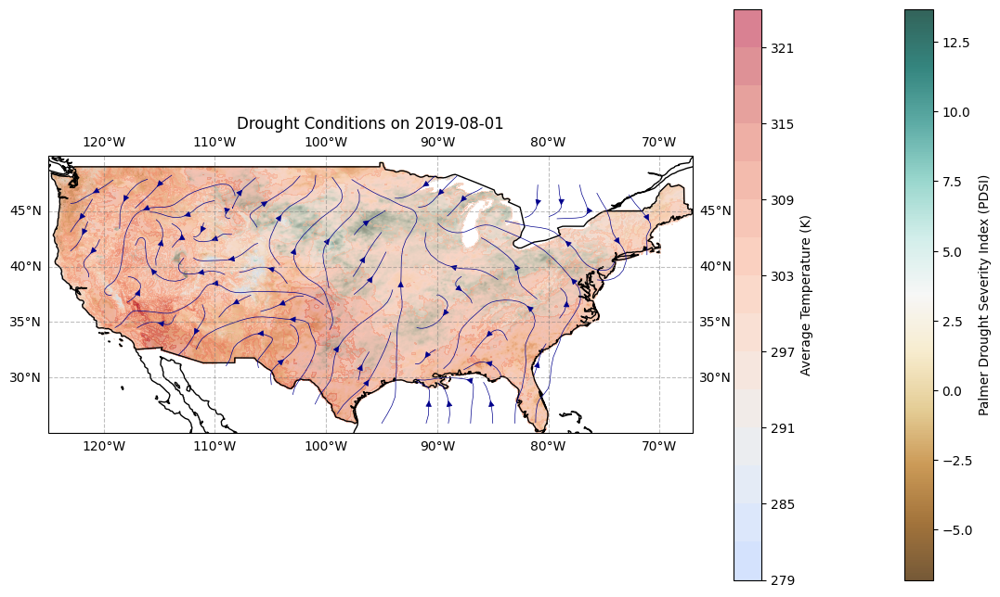

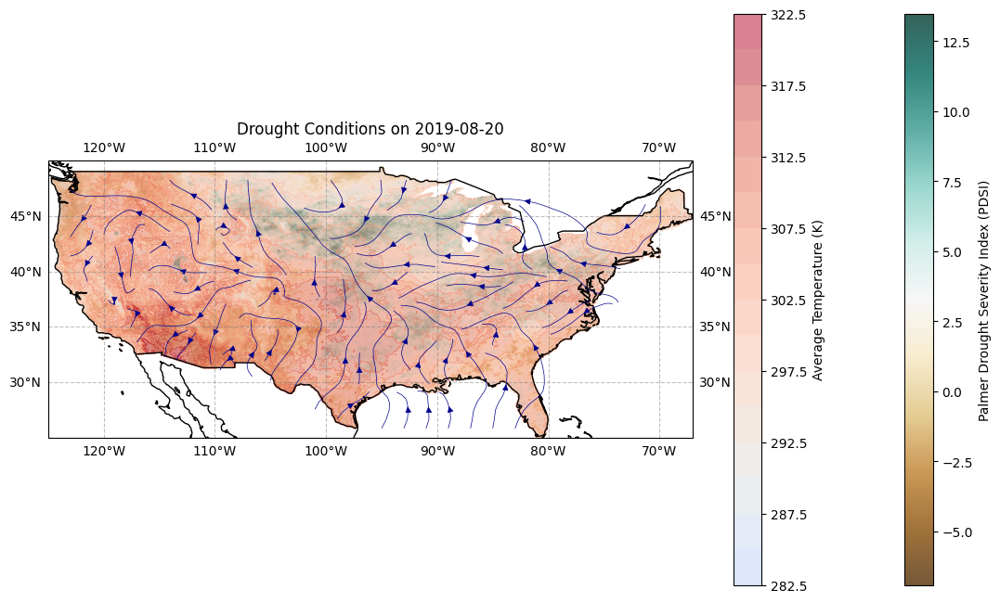

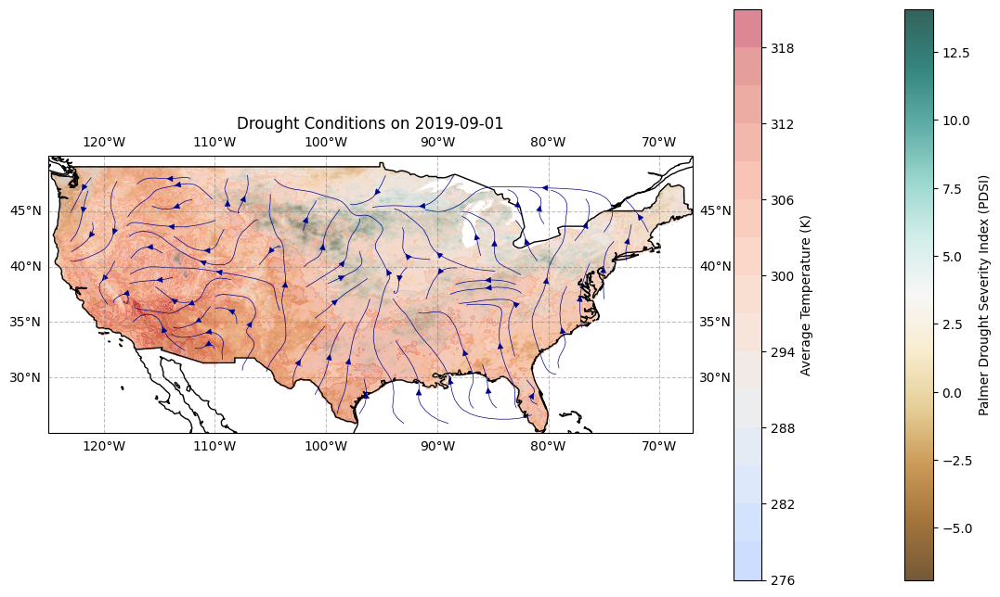

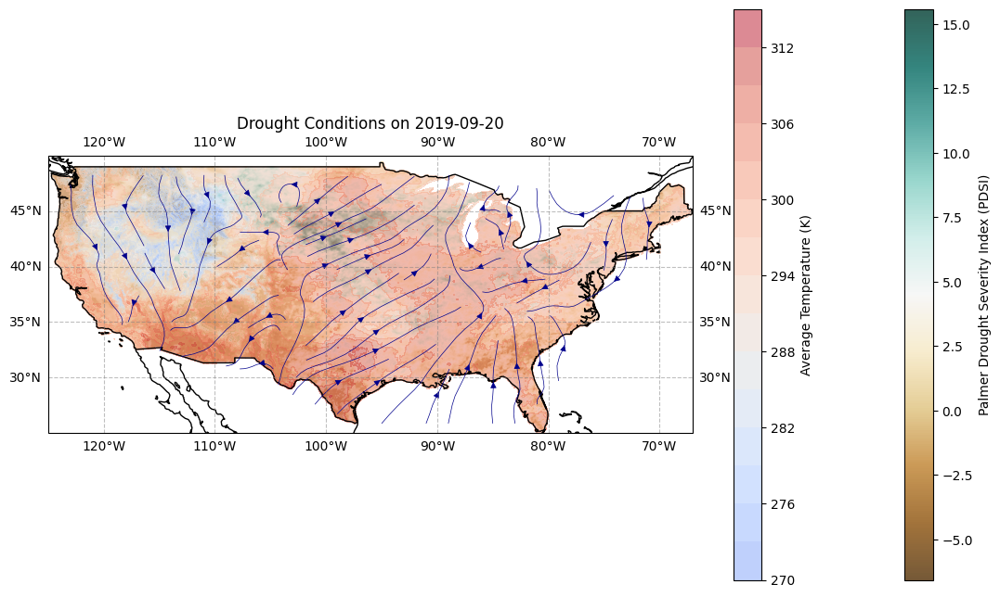

In [ ]:

import cartopy.feature as cfeature
def drought_plot(day_to_plot, pdsi_data, temp_data, wind_data, filename):

    selected_day = temp_data.sel(day=day_to_plot)
    pdsi_selected = pdsi_data['palmer_drought_severity_index'].squeeze()
    wind_speed_day = wind_data['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_data['wind_from_direction'].sel(day=day_to_plot)

    fig = plt.figure(figsize=(14, 8))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS)

    pdsi_plot = ax.imshow(
        pdsi_selected,
        extent=[pdsi_data['lon'].min(), pdsi_data['lon'].max(),
                pdsi_data['lat'].min(), pdsi_data['lat'].max()],
        origin='upper',
        cmap='BrBG', # set color
        alpha=0.8,
        transform=ccrs.PlateCarree()
    )

    temp_min = 260  # Set manually by preprocessing and plotting maps
    temp_max = selected_day['air_temperature'].max().values
    temp_contour = ax.contourf(
        selected_day['lon'], selected_day['lat'],
        selected_day['air_temperature'],
        levels=15, cmap='coolwarm', vmin=temp_min, vmax=temp_max,
        alpha=0.5, transform=ccrs.PlateCarree()
    )

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')
    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(wind_data['lon'].min(), wind_data['lon'].max(), 40)
    lat_grid = np.linspace(wind_data['lat'].min(), wind_data['lat'].max(), 35)
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')
    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    ax.streamplot(lon_grid, lat_grid, u, v, color='darkblue', linewidth=0.5, density=1, transform=ccrs.PlateCarree())

    cbar_pdsi = fig.colorbar(pdsi_plot, ax=ax, label='Palmer Drought Severity Index (PDSI)')
    cbar_temp = fig.colorbar(temp_contour, ax=ax, label='Average Temperature (K)')
    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    ax.set_title(f"Drought Conditions on {day_to_plot}")
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

    plt.savefig(filename, bbox_inches='tight',dpi=50)
    plt.show()

dates = [pdsi, pdsi0720, pdsi0801, pdsi0820, pdsi0901, pdsi0920]
dates1 = ['2019-07-01', '2019-07-20', '2019-08-01', '2019-08-20', '2019-09-01', '2019-09-20']

for i in range(len(dates)):
    drought_plot(dates1[i], dates[i], tmmx, wind_ft, f'drought_plot_{dates1[i]}.png')

---
Hurricane Barry
---

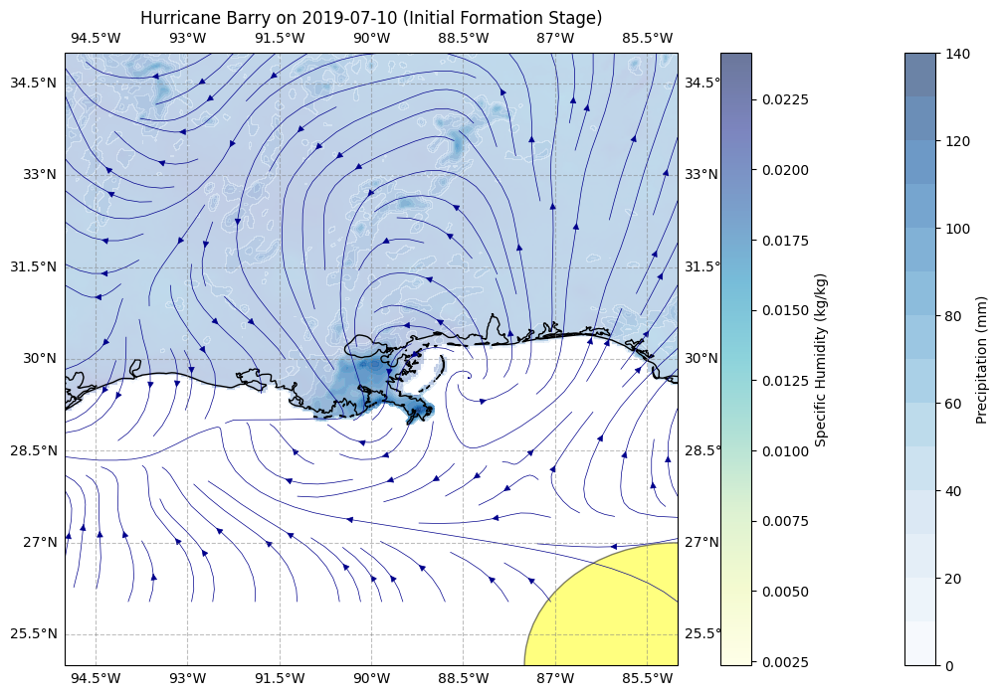

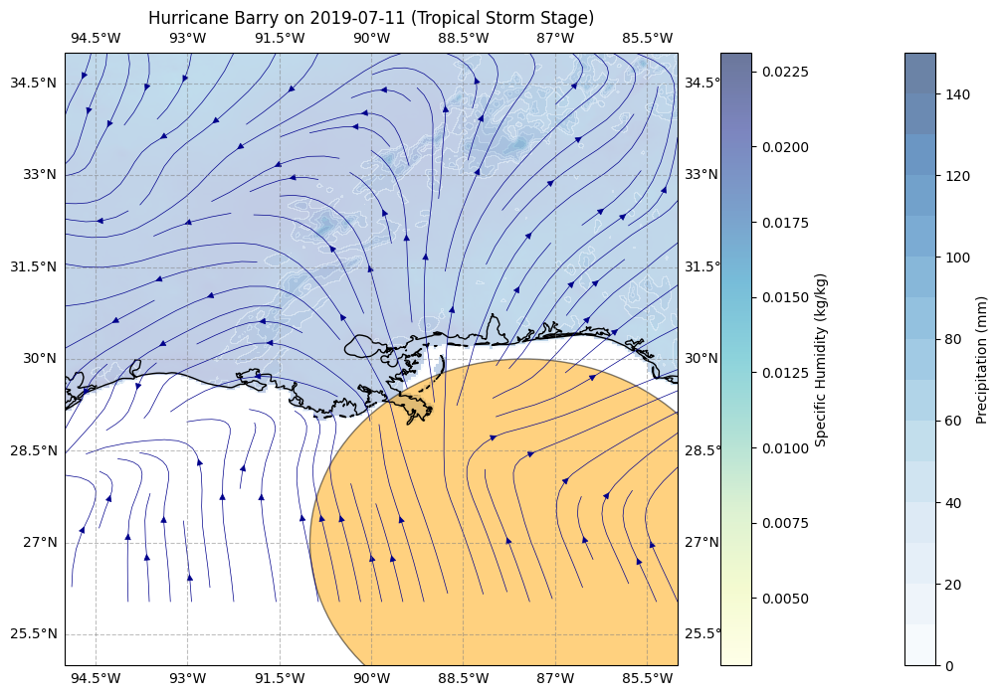

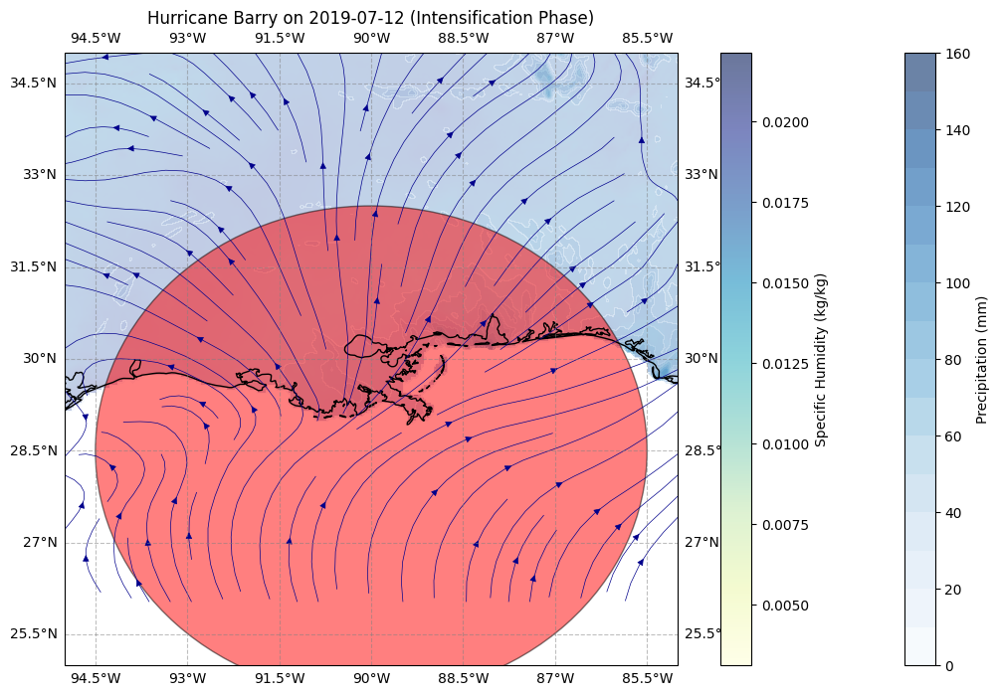

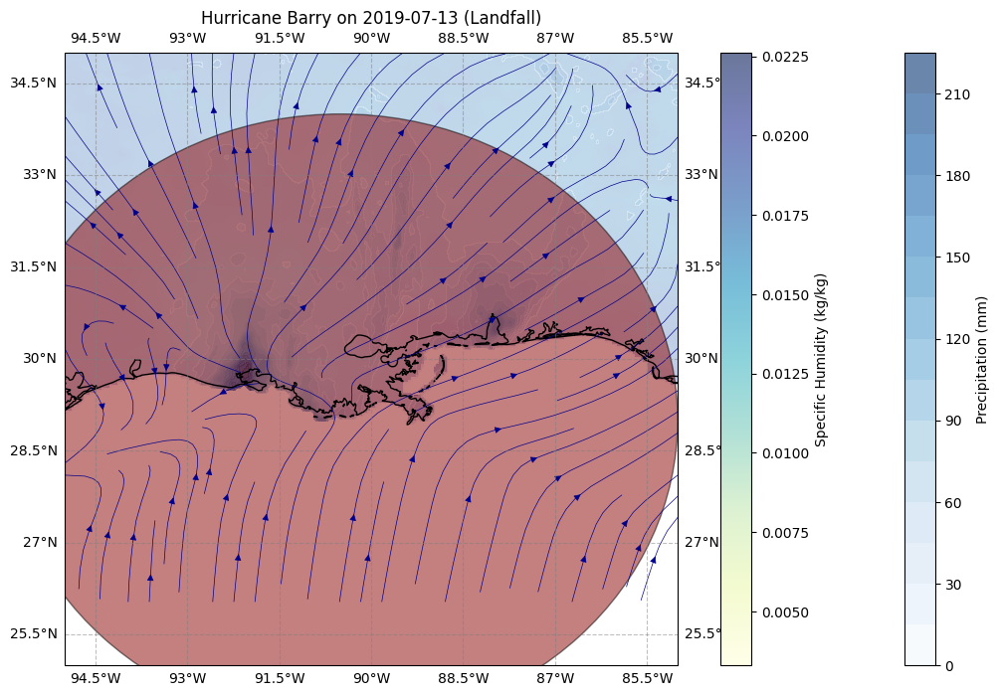

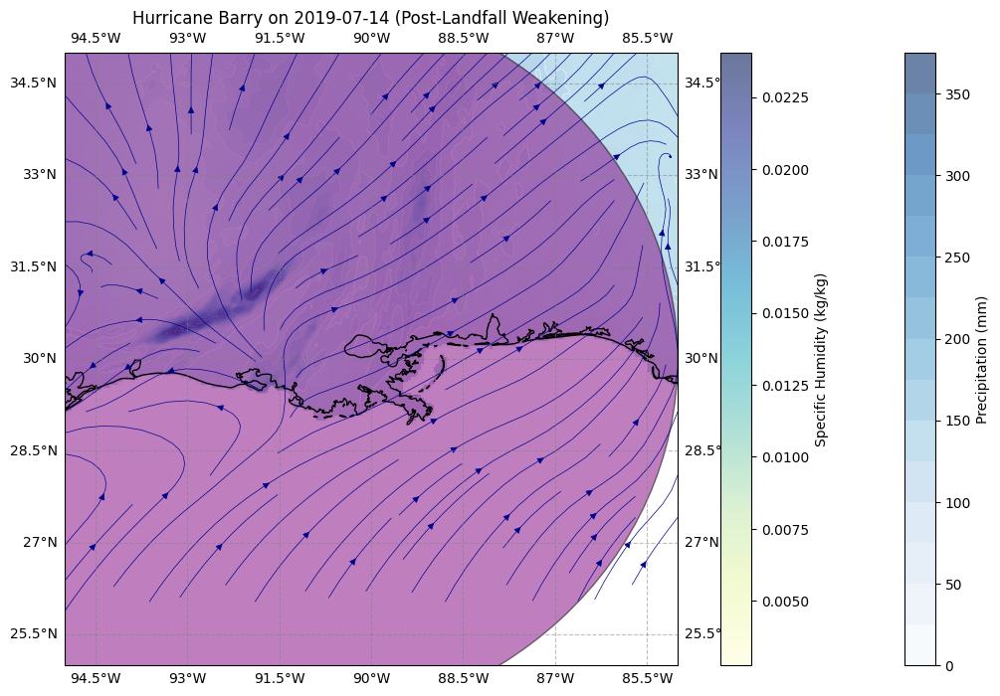

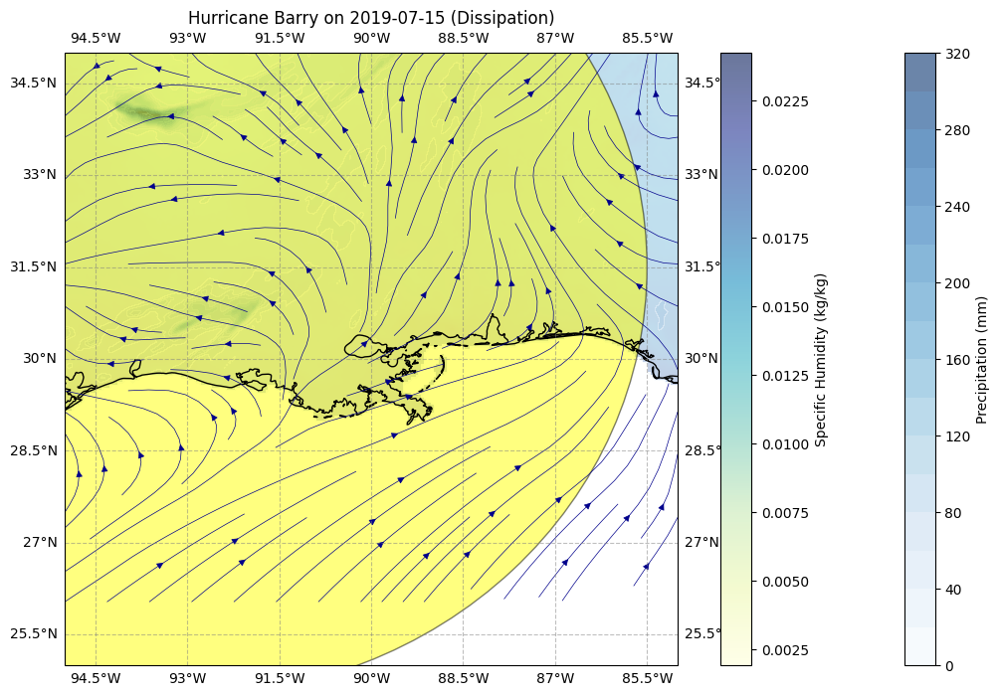

In [ ]:
from matplotlib.patches import Ellipse

def plot_affected_area(ax, center_lat, center_lon, radius_lat, radius_lon, color='yellow'):
    ellipse = Ellipse(
        xy=(center_lon, center_lat),
        width=2*radius_lon, height=2*radius_lat,
        edgecolor='black', facecolor=color, alpha=0.5
    )
    ax.add_patch(ellipse)

def combined_plot(day_to_plot, wind_ft, pr, sph, filename,t):
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)
    precipitation_day = pr['precipitation_amount'].sel(day=day_to_plot)
    humidity_day = sph['specific_humidity'].sel(day=day_to_plot)

    fig = plt.figure(figsize=(14, 8))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
    ax.set_extent([-95, -85, 25, 35], crs=ccrs.PlateCarree()) # zoom extent to observe designated area
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')
    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(wind_ft['lon'].min(), wind_ft['lon'].max(), 40) # 40 points in longitude range
    lat_grid = np.linspace(wind_ft['lat'].min(), wind_ft['lat'].max(), 35) # 35 points in latitudee range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')
    u = grid_speed * np.cos(np.deg2rad(grid_direction))
    v = grid_speed * np.sin(np.deg2rad(grid_direction))

    ax.streamplot(lon_grid, lat_grid, u, v, color='darkblue', linewidth=0.5, density=1, transform=ccrs.PlateCarree())

    precip_min = precipitation_day.min().values
    precip_max = precipitation_day.max().values
    precipitation_contour = ax.contourf(
        precipitation_day['lon'], precipitation_day['lat'],
        precipitation_day,
        levels=15,
        cmap='Blues',
        vmin=precip_min,
        vmax=precip_max,
        alpha=0.6,
        transform=ccrs.PlateCarree()
    )

    humidity_plot = ax.imshow(
        humidity_day,
        extent=[sph['lon'].min(), sph['lon'].max(),
                sph['lat'].min(), sph['lat'].max()],
        origin='upper',
        cmap='YlGnBu',
        alpha=0.6,
        transform=ccrs.PlateCarree()
    )

    cbar_precip = fig.colorbar(precipitation_contour, ax=ax, label='Precipitation (mm)')
    cbar_humidity = fig.colorbar(humidity_plot, ax=ax, label='Specific Humidity (kg/kg)')
    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    ax.set_title(f"Hurricane Barry on {day_to_plot} ({t})")
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

    # Plot the affected areas at each stage of the hurricane
    # Initial Formation Stage (July 10, 2019)
    if day_to_plot == '2019-07-10':
        plot_affected_area(ax, 25.0, -85.0, 2.0, 2.5, color='yellow')

    # Tropical Storm Stage (July 11, 2019)
    elif day_to_plot == '2019-07-11':
        plot_affected_area(ax, 27.0, -87.5, 3.0, 3.5, color='orange')

    # Intensification Phase (July 12, 2019)
    elif day_to_plot == '2019-07-12':
        plot_affected_area(ax, 28.5, -90.0, 4.0, 4.5, color='red')

    # Landfall (July 13, 2019)
    elif day_to_plot == '2019-07-13':
        plot_affected_area(ax, 29.0, -90.5, 5.0, 5.5, color='darkred')

    # Post-Landfall Weakening (July 14, 2019)
    elif day_to_plot == '2019-07-14':
        plot_affected_area(ax, 30.0, -91.5, 6.0, 6.5, color='purple')

    # Dissipation (July 15, 2019)
    elif day_to_plot == '2019-07-15':
        plot_affected_area(ax, 31.5, -93.0, 7.0, 7.5, color='yellow')

    plt.savefig(filename, bbox_inches='tight', dpi=50)
    plt.show()

dates = ['2019-07-10', '2019-07-11', '2019-07-12', '2019-07-13', '2019-07-14', '2019-07-15']
terms = ['Initial Formation Stage','Tropical Storm Stage','Intensification Phase','Landfall', 'Post-Landfall Weakening','Dissipation']
for i in range (len(dates)):
    combined_plot(dates[i], wind_ft, pr, sph, f'hurricane_plot_{dates[i]}.png',terms[i])

---
Forest Fire: Plotting quiver for wind, vapour pressure deficit as contourf, dead fuel moisture as heatmap
---

in the below code one needs to comment down respective (i.e Cow or Walker Wildfire location)coordinates of inspected polygon(i.e coordinates )

In [ ]:
import matplotlib.patches as patches
import cartopy.crs as ccrs
import matplotlib.pyplot as plt

def forestfire_plot(day,d):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([-125, -115, 35, 40], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    selected_vpd = vpd.sel(day=day)
    vpd_contour = ax.contourf(
        selected_vpd['lon'], selected_vpd['lat'],
        selected_vpd['mean_vapor_pressure_deficit'],
        transform=ccrs.PlateCarree(),
        cmap='OrRd',
        alpha=0.5,
        levels=20
    )

    selected_fm = fm100.sel(day=day)
    fm_image = ax.imshow(
        selected_fm['dead_fuel_moisture_100hr'],
        extent=[selected_fm['lon'].min(), selected_fm['lon'].max(),
                selected_fm['lat'].min(), selected_fm['lat'].max()],
        origin='upper',
        cmap='Greens',
        alpha=0.6,
        transform=ccrs.PlateCarree()
    )

    wind_speed_day = wind_ft['wind_speed'].sel(day=day)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day)

    lat_indices = np.linspace(0, len(wind_speed_day['lat']) - 1, 50, dtype=int) # 50 points in latitude range
    lon_indices = np.linspace(0, len(wind_speed_day['lon']) - 1, 75, dtype=int) # 75 points in longitude range

    u = np.cos(np.deg2rad(wind_direction_day[lat_indices, :][:, lon_indices])) * wind_speed_day[lat_indices, :][:, lon_indices]
    v = np.sin(np.deg2rad(wind_direction_day[lat_indices, :][:, lon_indices])) * wind_speed_day[lat_indices, :][:, lon_indices]

    lon_grid, lat_grid = np.meshgrid(wind_speed_day['lon'][lon_indices], wind_speed_day['lat'][lat_indices])

    ax.quiver(lon_grid, lat_grid, u, v, scale=70, color='black', alpha=0.6)

    #Here one can comment down the respective coordinates and polygon creation for respective wildfire visualization (can alternatively change between two)

    #cow_fire_coords = [(-119.7, 35.5), (-119.7, 35.4), (-119.5, 35.4), (-119.5, 35.5)]
    walker_fire_coords = [(-120.5, 39.4), (-120.5, 39.3), (-120.3, 39.3), (-120.3, 39.4)]

    # Create polygons for the fire-affected areas  (can alternatively change between two)

    # cow_fire_poly = patches.Polygon(cow_fire_coords, closed=True, color='blue', alpha=1, label='Cow Fire')
    # ax.add_patch(cow_fire_poly)

    walker_fire_poly = patches.Polygon(walker_fire_coords, closed=True, color='yellow', alpha=1, label='Walker Fire')
    ax.add_patch(walker_fire_poly)

    cbar_vpd = fig.colorbar(vpd_contour, ax=ax, orientation="vertical", fraction=0.03, pad=0.1)
    cbar_vpd.set_label("Vapor Pressure Deficit (hPa)", labelpad=5)

    cbar_fm = fig.colorbar(fm_image, ax=ax, orientation="vertical", fraction=0.03, pad=0.1)
    cbar_fm.set_label("Dead Fuel Moisture (%)", labelpad=5)

    plt.title(f"Walker Wildfire Plot for {day} ({d})")
    gl = ax.gridlines(draw_labels=True, linestyle="--", color="gray")
    gl.top_labels = gl.right_labels = False

    ax.legend()
    plt.savefig(f"walker_wildfire_plot_{day}.png", dpi=50)
    plt.show()




1.   Cow Wildfire dates



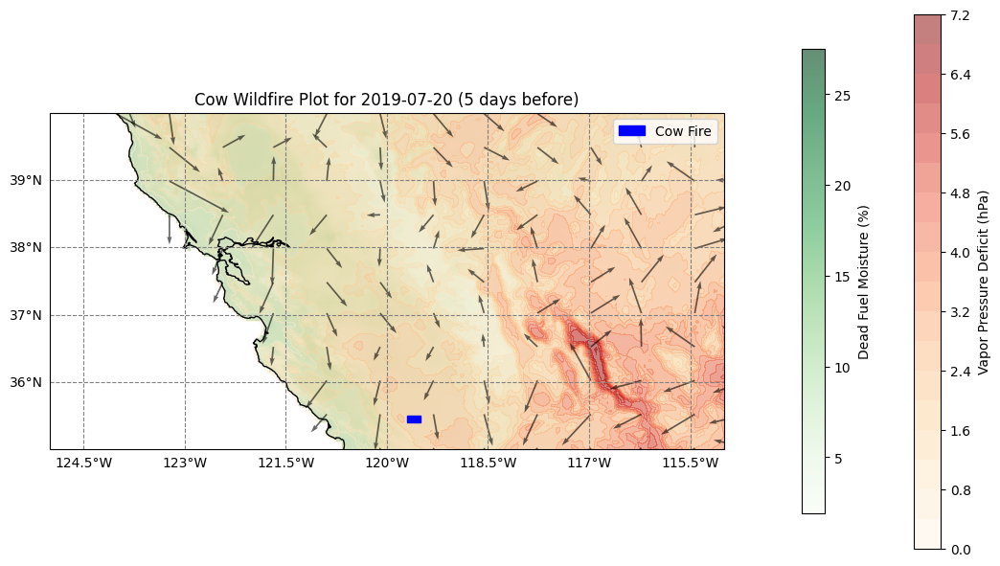

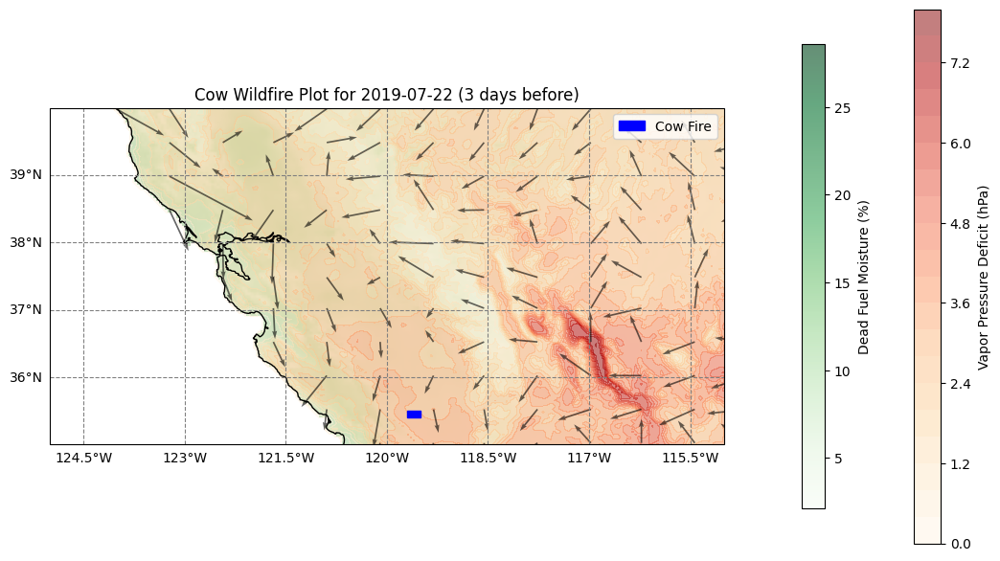

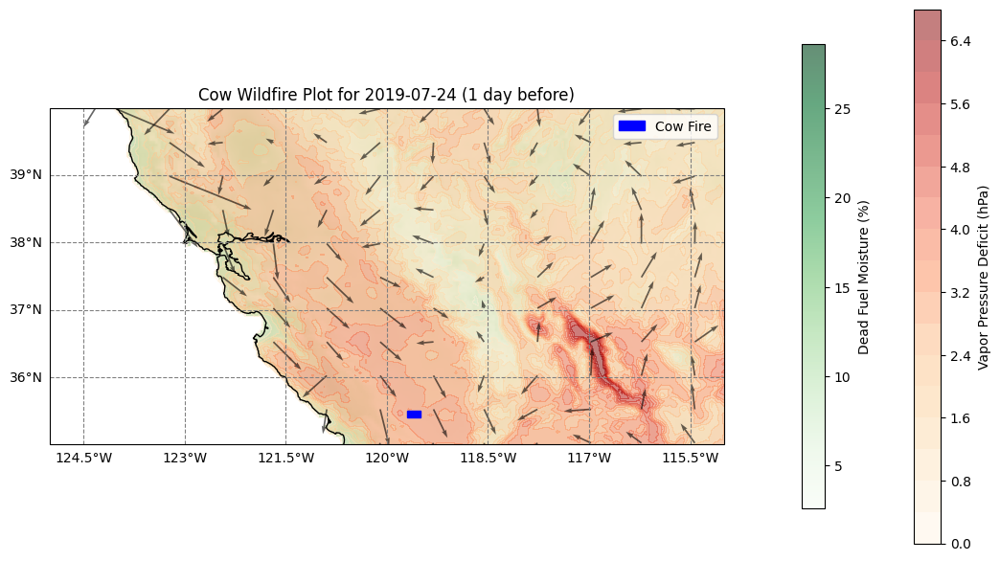

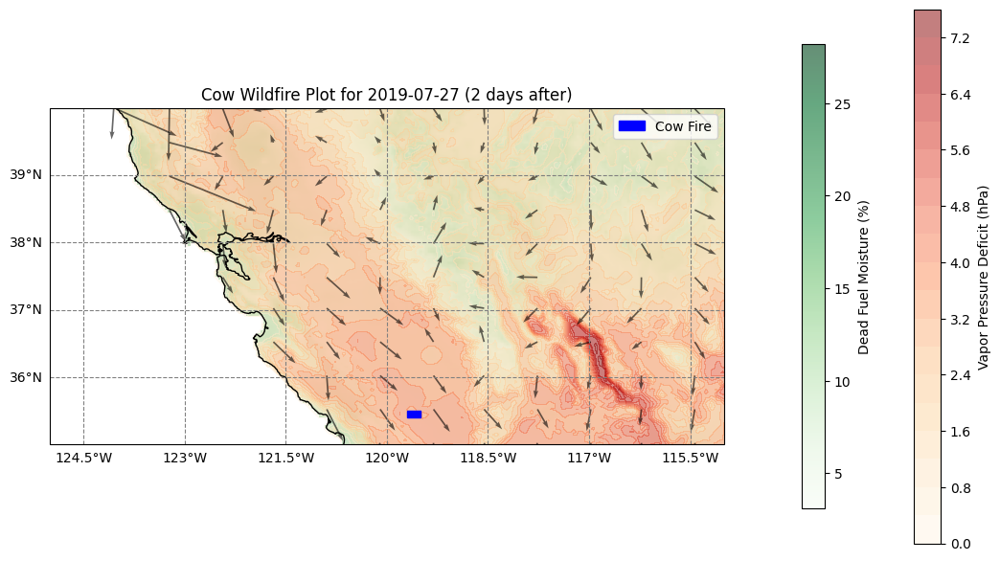

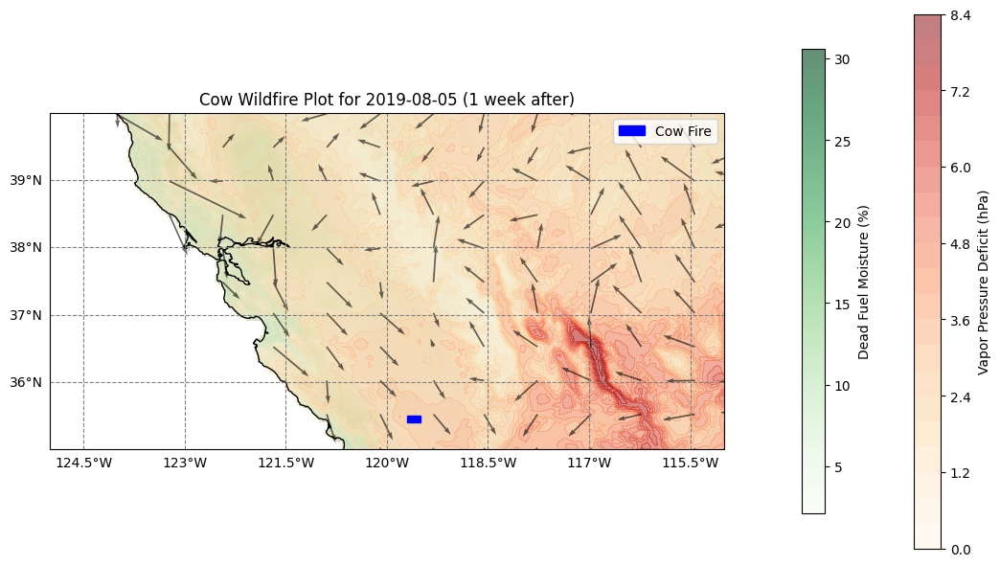

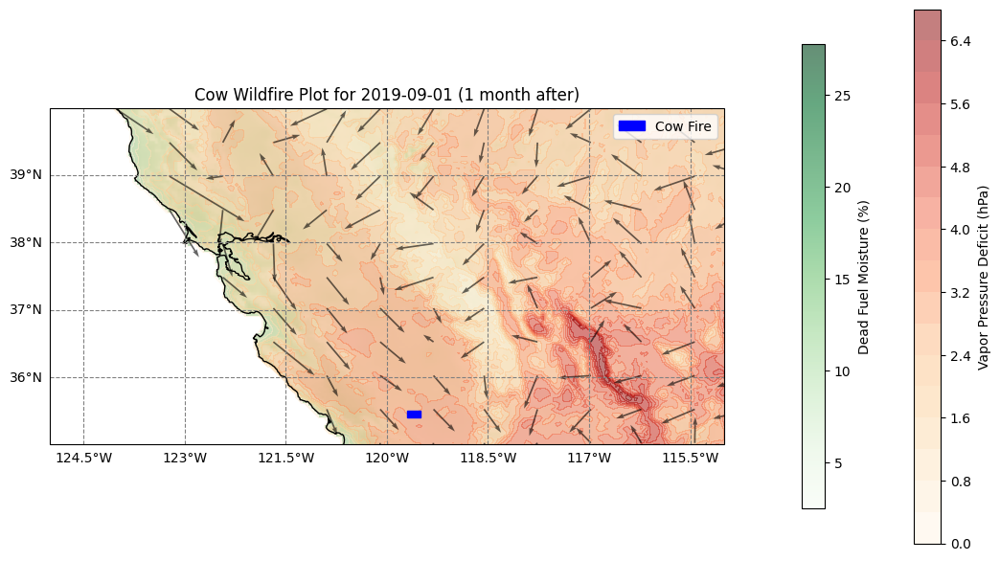

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']
cowFireDates = [
    "2019-07-20", # 5 days before
    "2019-07-22", # 3 days before
    "2019-07-24", # 1 day before
    "2019-07-27", # 2 days after
    "2019-08-05", # 1 week after
    "2019-09-01"  # 1 month after
];
days = [
    "5 days before",
   "3 days before",
    "1 day before",
    "2 days after",
    "1 week after",
    "1 month after"]
# Loop over each date and generate the plot
for i in range(len(days)):
    forestfire_plot(cowFireDates[i], days[i])

2. Walker Wildfire dates

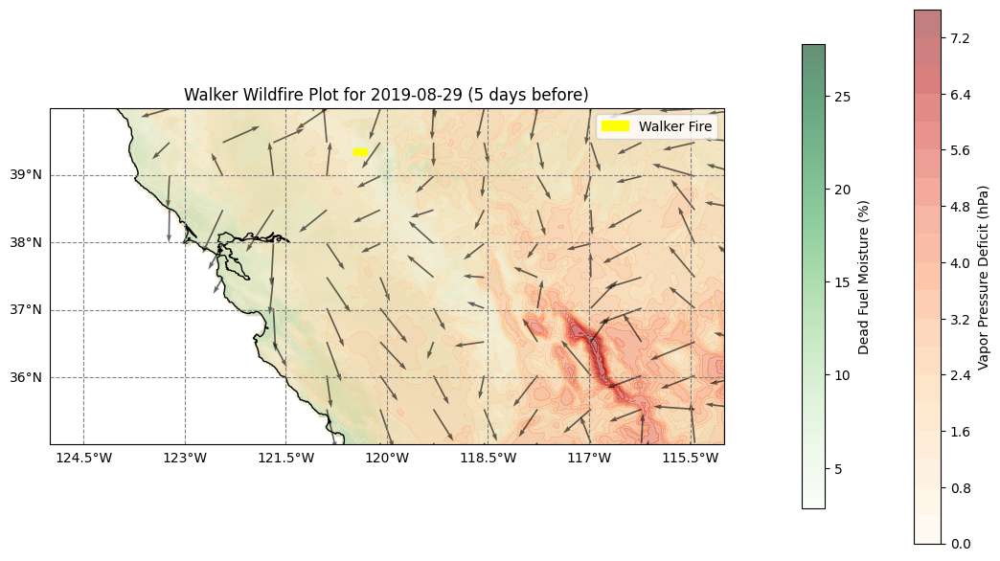

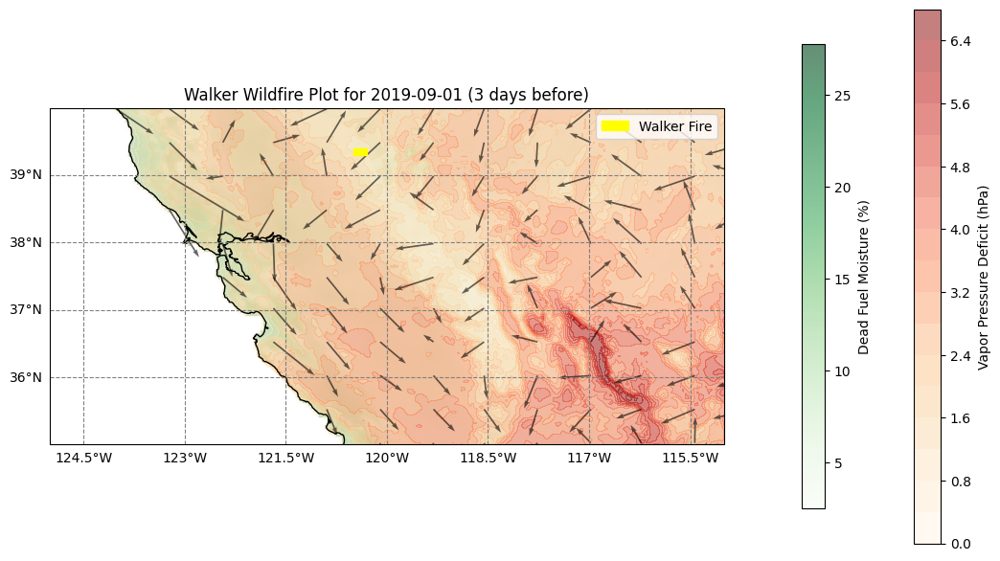

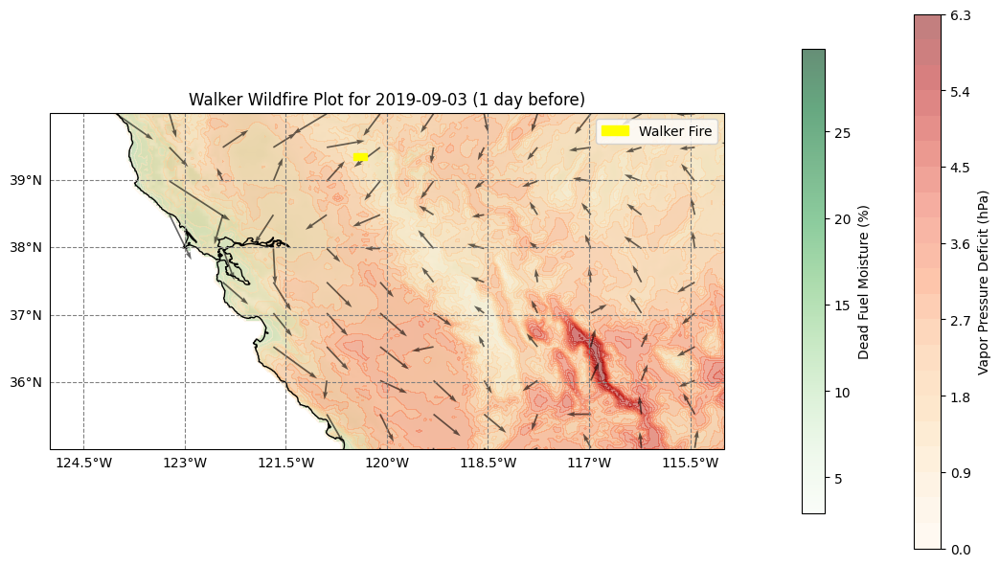

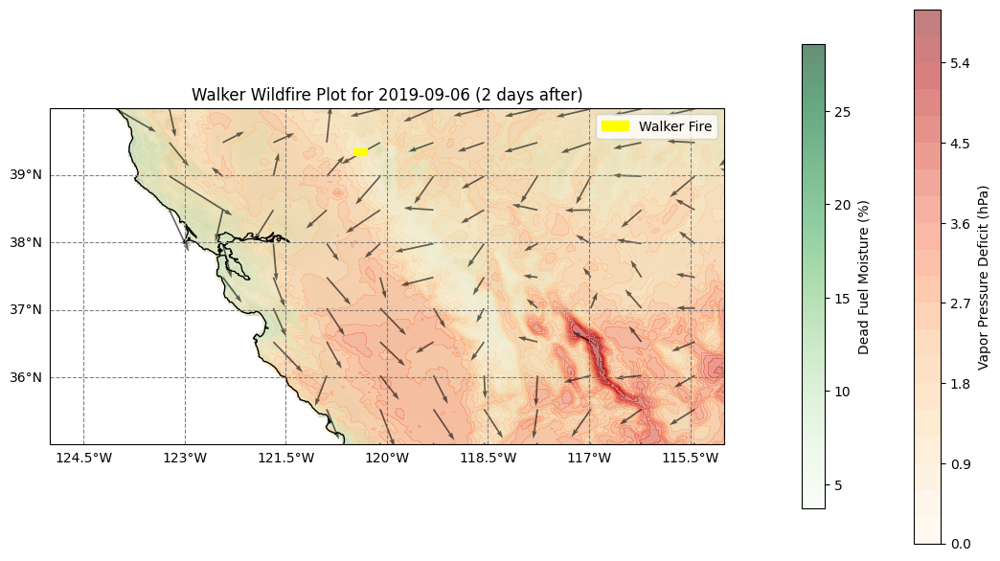

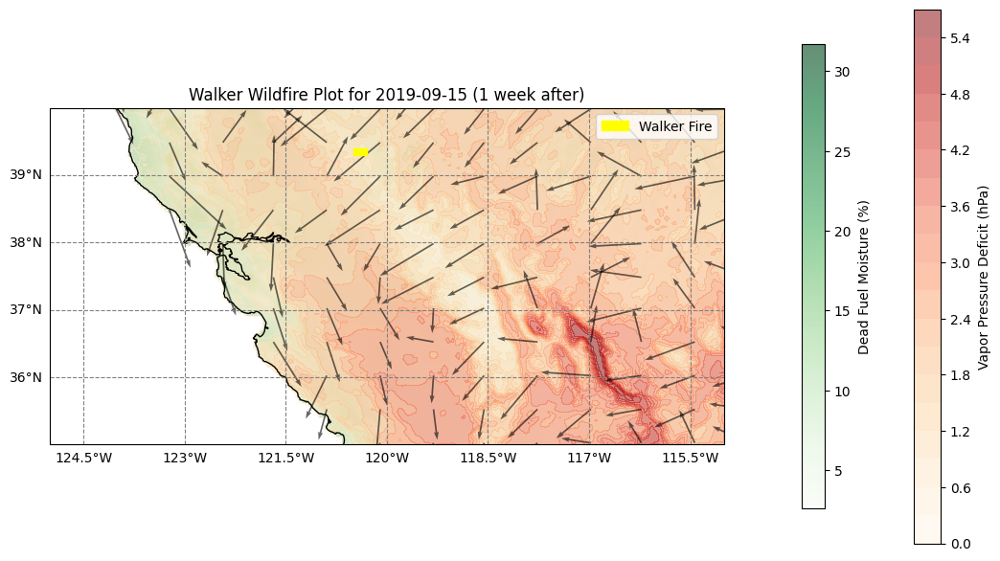

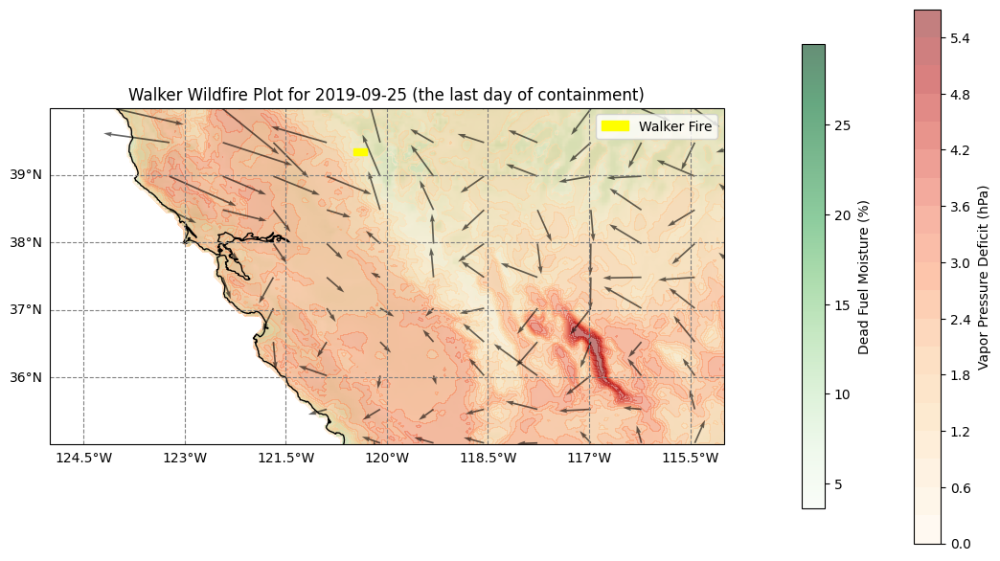

In [ ]:
walkerFireDates = [
    "2019-08-29", # 5 days before
    "2019-09-01", # 3 days before
    "2019-09-03", # 1 day before
    "2019-09-06", # 2 days after
    "2019-09-15", # 1 week after
    "2019-09-25"  # the last day of containment
];
days = ["5 days before",
    "3 days before",
    "1 day before",
    "2 days after",
    "1 week after",
    "the last day of containment"]

for i in range(len(days)):
    forestfire_plot(walkerFireDates[i], days[i])

---
**Creating gifs based on save files**
---

In [ ]:
from PIL import Image
import imageio.v2 as imageio
import numpy as np

In [ ]:
# wind plot balck

frame1 = Image.open('wind_plot_black_2019-07-01.png')
frame2 = Image.open('wind_plot_black_2019-07-15.png')
frame3 = Image.open('wind_plot_black_2019-08-01.png')
frame4 = Image.open('wind_plot_black_2019-08-15.png')
frame5 = Image.open('wind_plot_black_2019-09-01.png')
frame6 = Image.open('wind_plot_black_2019-09-15.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('wind_plot_black.gif', images, duration=1)

In [ ]:
# wind plot plasma

frame1 = Image.open('wind_plot_2019-07-01.png')
frame2 = Image.open('wind_plot_2019-07-15.png')
frame3 = Image.open('wind_plot_2019-08-01.png')
frame4 = Image.open('wind_plot_2019-08-15.png')
frame5 = Image.open('wind_plot_2019-09-01.png')
frame6 = Image.open('wind_plot_2019-09-15.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('wind_plot_plasma.gif', images, duration=1)

In [ ]:
# wind plot viridis

frame1 = Image.open('wind_plot_2019-07-01.png')
frame2 = Image.open('wind_plot_2019-07-15.png')
frame3 = Image.open('wind_plot_2019-08-01.png')
frame4 = Image.open('wind_plot_2019-08-15.png')
frame5 = Image.open('wind_plot_2019-09-01.png')
frame6 = Image.open('wind_plot_2019-09-15.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('wind_plot_viridis.gif', images, duration=1)

In [ ]:
# wind plot continuous

frame1 = Image.open('wind_plot_2019-07-01.png')
frame2 = Image.open('wind_plot_2019-07-15.png')
frame3 = Image.open('wind_plot_2019-08-01.png')
frame4 = Image.open('wind_plot_2019-08-15.png')
frame5 = Image.open('wind_plot_2019-09-01.png')
frame6 = Image.open('wind_plot_2019-09-15.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('wind_plot_continuous.gif', images, duration=1)

In [ ]:
# wind streamline plot lightblue

frame1 = Image.open('/content/wind_streamlines_2019-07-01_lightblue.png')
frame2 = Image.open('/content/wind_streamlines_2019-07-15_lightblue.png')
frame3 = Image.open('/content/wind_streamlines_2019-08-01_lightblue.png')
frame4 = Image.open('/content/wind_streamlines_2019-08-15_lightblue.png')
frame5 = Image.open('/content/wind_streamlines_2019-09-01_lightblue.png')
frame6 = Image.open('/content/wind_streamlines_2019-09-15_lightblue.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('streamline_plot_lightblue.gif', images, duration=1)

In [ ]:
# wind streamline plot darkblue

frame1 = Image.open('/content/wind_streamlines_2019-07-01_darkblue.png')
frame2 = Image.open('/content/wind_streamlines_2019-07-15_darkblue.png')
frame3 = Image.open('/content/wind_streamlines_2019-08-01_darkblue.png')
frame4 = Image.open('/content/wind_streamlines_2019-08-15_darkblue.png')
frame5 = Image.open('/content/wind_streamlines_2019-09-01_darkblue.png')
frame6 = Image.open('/content/wind_streamlines_2019-09-15_darkblue.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('streamline_plot_darkblue.gif', images, duration=1)

In [ ]:
# cowfire plot continuous

frame1 = Image.open('/content/cow_wildfire_plot_2019-07-20.png')
frame2 = Image.open('/content/cow_wildfire_plot_2019-07-22.png')
frame3 = Image.open('/content/cow_wildfire_plot_2019-07-24.png')
frame4 = Image.open('/content/cow_wildfire_plot_2019-07-27.png')
frame5 = Image.open('/content/cow_wildfire_plot_2019-08-05.png')
frame6 = Image.open('/content/cow_wildfire_plot_2019-09-01.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('cow_wildfire.gif', images, duration=1)

In [ ]:
# walker wildfire plot continuous

frame1 = Image.open('/content/walker_wildfire_plot_2019-08-29.png')
frame2 = Image.open('/content/walker_wildfire_plot_2019-09-01.png')
frame3 = Image.open('/content/walker_wildfire_plot_2019-09-03.png')
frame4 = Image.open('/content/walker_wildfire_plot_2019-09-06.png')
frame5 = Image.open('/content/walker_wildfire_plot_2019-09-15.png')
frame6 = Image.open('/content/walker_wildfire_plot_2019-09-25.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('walker_wildfire.gif', images, duration=1)

In [ ]:
# temperature and wind plot global

frame1 = Image.open('/content/temp_wind_plot_2019-07-01_local.png')
frame2 = Image.open('/content/temp_wind_plot_2019-07-21_local.png')
frame3 = Image.open('/content/temp_wind_plot_2019-07-22_local.png')
frame4 = Image.open('/content/temp_wind_plot_2019-07-23_local.png')
frame5 = Image.open('/content/temp_wind_plot_2019-08-01_local.png')
frame6 = Image.open('/content/temp_wind_plot_2019-09-15_local.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('wind_temperature_local.gif', images, duration=1)

In [ ]:
# temperature and wind plot local

frame1 = Image.open('/content/temp_wind_plot_2019-07-01.png')
frame2 = Image.open('/content/temp_wind_plot_2019-07-21.png')
frame3 = Image.open('/content/temp_wind_plot_2019-07-22.png')
frame4 = Image.open('/content/temp_wind_plot_2019-07-23.png')
frame5 = Image.open('/content/temp_wind_plot_2019-08-01.png')
frame6 = Image.open('/content/temp_wind_plot_2019-09-15.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('wind_temperature_global.gif', images, duration=2)

In [ ]:
# used different approach here since it shows error for different sizes of images(thanks to stackoverflow for the suggestion to use Image.LANCZOS)
fixed_size = (1400, 800)
image_paths = [
    '/content/drought_plot_2019-07-01.png',
    '/content/drought_plot_2019-07-20.png',
    '/content/drought_plot_2019-08-01.png',
    '/content/drought_plot_2019-08-20.png',
    '/content/drought_plot_2019-09-01.png',
    '/content/drought_plot_2019-09-20.png'
]

images = []

for file in image_paths:
    with Image.open(file) as img:
        img_r = img.resize(fixed_size, Image.LANCZOS)
        images.append(np.array(img_r))


imageio.mimsave('drought.gif', images, duration=2)

In [ ]:
# making gif for  hurricane Barry
frame1 = Image.open('/content/hurricane_plot_2019-07-10.png')
frame2 = Image.open('/content/hurricane_plot_2019-07-11.png')
frame3 = Image.open('/content/hurricane_plot_2019-07-12.png')
frame4 = Image.open('/content/hurricane_plot_2019-07-13.png')
frame5 = Image.open('/content/hurricane_plot_2019-07-14.png')
frame6 = Image.open('/content/hurricane_plot_2019-07-15.png')

images = [np.array(frame) for frame in [frame1, frame2, frame3, frame4, frame5, frame6]]

imageio.mimsave('hurricane_Barry.gif', images, duration=2)

---
# **Extra Plots (Plotted while doing assignment to observe different variables)**

-> Point to note that some variables need to be handled (might give some error)
---

In [ ]:
rmax_ft = rmax.sel(day=mask)
rmin_ft = rmin.sel(day=mask)
tmmn_ft = tmmn.sel(day=mask)
tmmx_ft = tmmx.sel(day=mask)

In [ ]:
tmmx.head(10)

<xarray.DataArray 'air_temp_max' (day: 10, lat: 10, lon: 10)> Size: 8kB
[1000 values with dtype=float64]
Coordinates:
  * lon      (lon) float64 80B -124.8 -124.7 -124.7 ... -124.5 -124.4 -124.4
  * lat      (lat) float64 80B 49.4 49.36 49.32 49.28 ... 49.11 49.07 49.03
  * day      (day) datetime64[ns] 80B 2019-01-01 2019-01-02 ... 2019-01-10
Attributes:
    units:              K
    description:        Daily Maximum Temperature
    long_name:          tmmx
    standard_name:      tmmx
    dimensions:         lon lat time
    grid_mapping:       crs
    coordinate_system:  WGS84,EPSG:4326

In [ ]:
tmmn = tmmn["air_temperature"].rename('air_temp_min')
tmmx = tmmx["air_temperature"].rename('air_temp_max')



In [ ]:
temp = xr.merge([tmmn,tmmx])
temp['avg_temp'] = (temp['air_temp_min'] + temp['air_temp_max']) / 2

In [ ]:
rmax.head(10)

<xarray.Dataset> Size: 8kB
Dimensions:            (lon: 10, lat: 10, day: 10, crs: 1)
Coordinates:
  * lon                (lon) float64 80B -124.8 -124.7 -124.7 ... -124.4 -124.4
  * lat                (lat) float64 80B 49.4 49.36 49.32 ... 49.11 49.07 49.03
  * day                (day) datetime64[ns] 80B 2019-01-01 ... 2019-01-10
  * crs                (crs) uint16 2B 3
Data variables:
    relative_humidity  (day, lat, lon) float64 8kB ...
Attributes: (12/19)
    geospatial_bounds_crs:      EPSG:4326
    Conventions:                CF-1.6
    geospatial_bounds:          POLYGON((-124.7666666333333 49.40000000000000...
    geospatial_lat_min:         25.066666666666666
    geospatial_lat_max:         49.40000000000000
    geospatial_lon_min:         -124.7666666333333
    ...                         ...
    date:                       26 April 2021
    note1:                      The projection information for this file is: ...
    note2:                      Citation: Abatzoglou, J.T., 2013, Development...
    note3:                      Data in slices after last_permanent_slice (1-...
    note4:                      Data in slices after last_provisional_slice (...
    note5:                      Days correspond approximately to calendar day...

In [ ]:
rmax = rmax["relative_humidity"].rename('humid_max')
rmin = rmin["relative_humidity"].rename('humid_min')

In [ ]:
r = xr.merge([rmax,rmin])

In [ ]:
print(r.head(10))
print(temp.head(10))

<xarray.Dataset> Size: 16kB
Dimensions:    (lon: 10, lat: 10, day: 10)
Coordinates:
  * lon        (lon) float64 80B -124.8 -124.7 -124.7 ... -124.5 -124.4 -124.4
  * lat        (lat) float64 80B 49.4 49.36 49.32 49.28 ... 49.11 49.07 49.03
  * day        (day) datetime64[ns] 80B 2019-01-01 2019-01-02 ... 2019-01-10
Data variables:
    humid_max  (day, lat, lon) float64 8kB ...
    humid_min  (day, lat, lon) float64 8kB ...
Attributes:
    units:              %
    description:        Daily Maximum Relative Humidity
    long_name:          rmax
    standard_name:      rmax
    dimensions:         lon lat time
    grid_mapping:       crs
    coordinate_system:  WGS84,EPSG:4326
<xarray.Dataset> Size: 16kB
Dimensions:       (lon: 10, lat: 10, day: 10)
Coordinates:
  * lon           (lon) float64 80B -124.8 -124.7 -124.7 ... -124.4 -124.4
  * lat           (lat) float64 80B 49.4 49.36 49.32 49.28 ... 49.11 49.07 49.03
  * day           (day) datetime64[ns] 80B 2019-01-01 2019-01-02 ... 201

In [ ]:
temp_humid = xr.merge([temp,r])

In [ ]:
temp_humid_ft = temp_humid.sel(day=mask)

In [ ]:
temp_humid_ft['avg_temp'] = (temp_humid_ft['air_temp_min'] + temp_humid_ft['air_temp_max']) / 2
temp_humid_ft['avg_humidity'] = (temp_humid_ft['humid_min'] + temp_humid_ft['humid_max']) / 2


In [ ]:
def temperature_plot(day_to_plot):
    day = day_to_plot
    selected_day = temp.sel(day=day)

    temp_min = 260  # Set manually after preprocessing and plotting maps
    temp_max = selected_day['avg_temp'].max().values

    fig = plt.figure(figsize=(14, 8))
    gs = fig.add_gridspec(1, 2, width_ratios=[5, 0.1])
    ax = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())

    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    temp_contour = ax.contourf(
        selected_day['lon'],
        selected_day['lat'],
        selected_day['avg_temp'],
        levels=15,
        cmap='seismic', # Can change color
        vmin=temp_min,
        vmax=temp_max,
        alpha=0.6
    )

    cbar = fig.colorbar(temp_contour, cax=fig.add_subplot(gs[0, 1]))
    cbar.set_label('Average Temperature (K)')

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    ax.set_title("Temperature on " + str(day))
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    plt.savefig(f"temperature_plot_{day}.png", dpi=600)
    plt.show()


In [ ]:
#dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01','2019-08-15','2019-09-01', '2019-09-15']
dates_to_plot = ['2019-07-20', '2019-07-21', '2019-07-22','2019-07-23','2019-07-24']

for day in dates_to_plot:
    temperature_plot(day)

In [ ]:
def humidity_plot(day):

  selected_day = temp_humid_ft.sel(day=day)
  fig = plt.figure(figsize=(14, 8))
  gs = fig.add_gridspec(1, 2, width_ratios=[4, 0.1])
  ax = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())

  ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
  ax.coastlines()
  ax.add_feature(cartopy.feature.BORDERS)

  humidity_overlay = ax.imshow(
      selected_day['avg_humidity'],
      extent=[ selected_day['lon'].min(),selected_day['lon'].max() ,
            selected_day['lat'].min(),  selected_day['lat'].max()],
      origin='upper',
      cmap='Blues', # Set color map
      alpha=0.6
  )

  cbar = fig.colorbar(humidity_overlay, ax=ax, orientation="vertical", fraction=0.03, pad=0.04)
  cbar.set_label("Average Humidity (%)")

  gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
  gl.xlabels_top = False
  gl.ylabels_right = False

  plt.title("Average Humidity Overlay"+ str(day))
  ax.set_xlabel("Longitude")
  ax.set_ylabel("Latitude")
  plt.show()

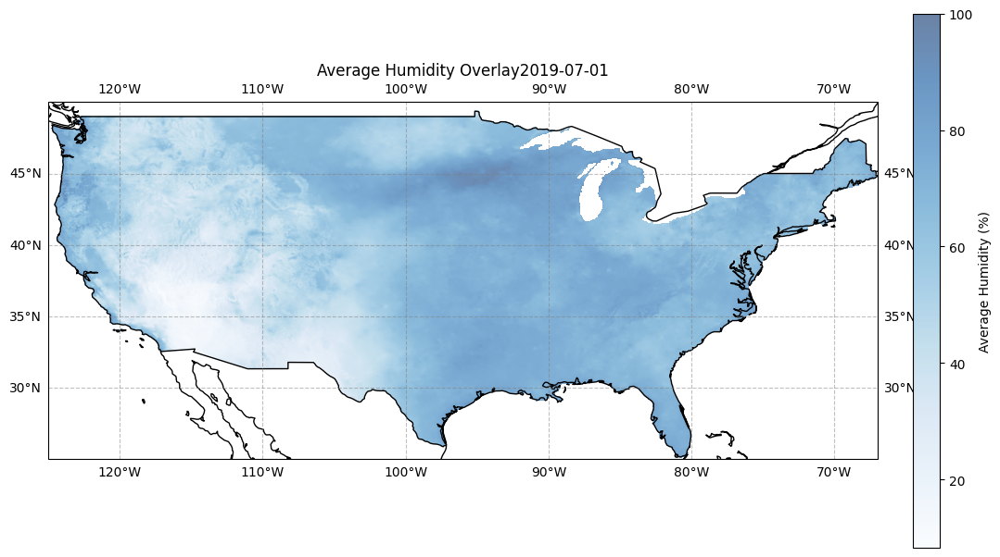

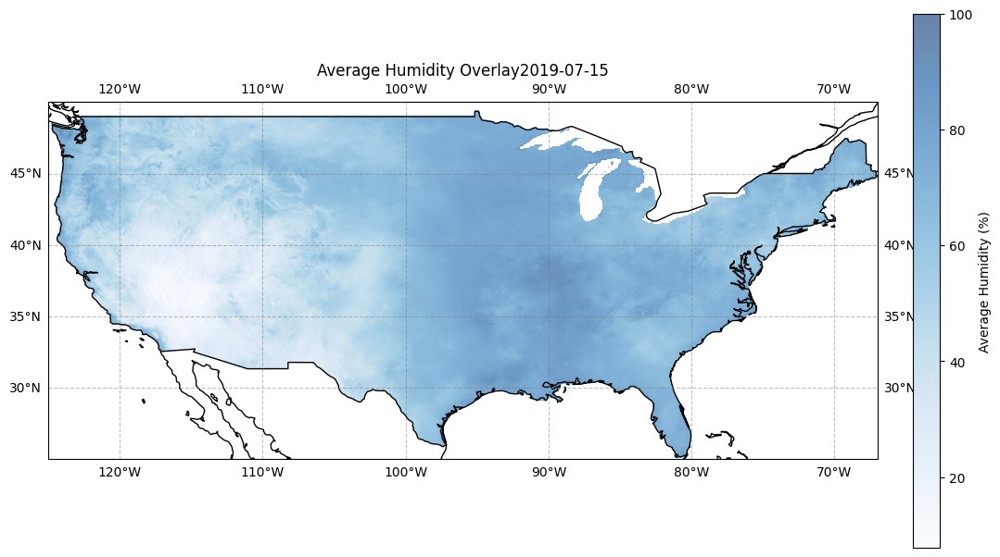

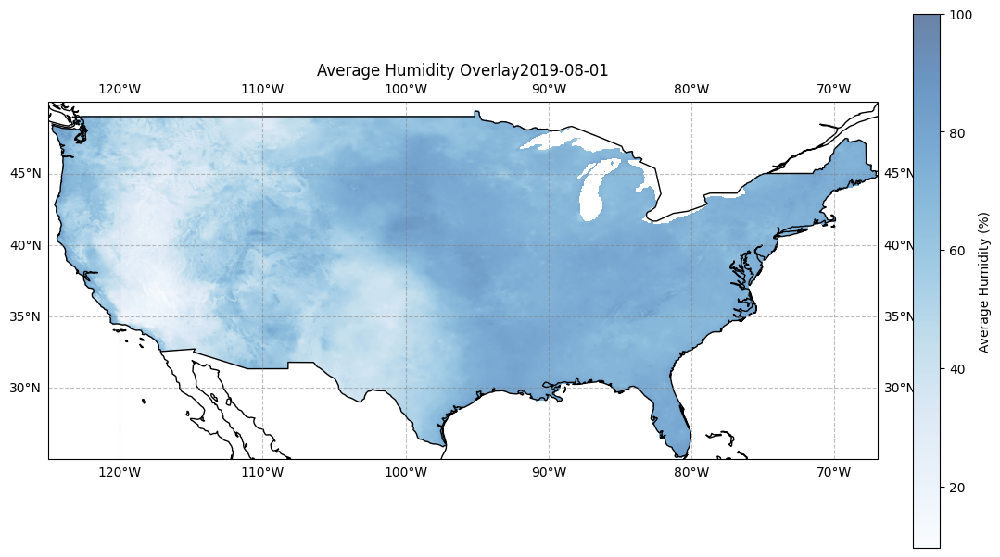

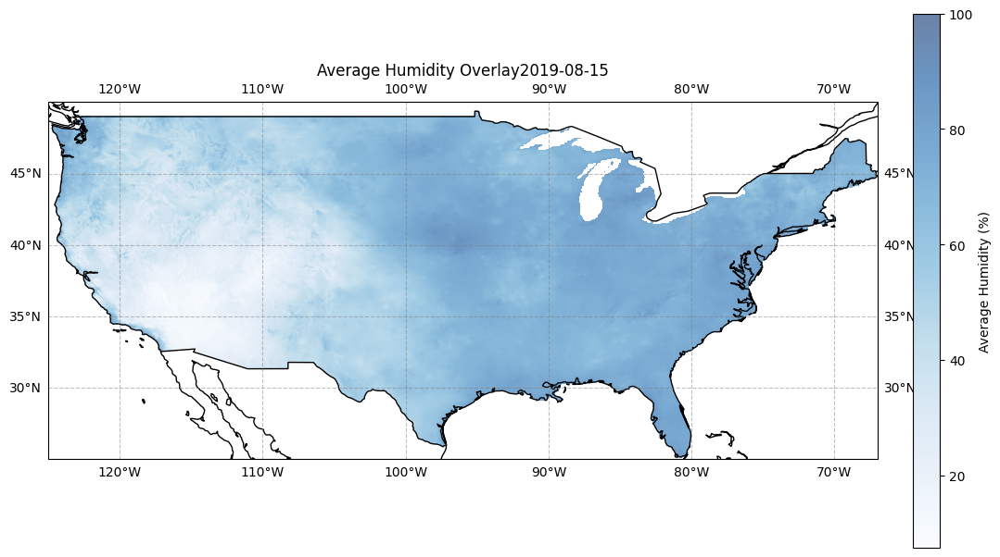

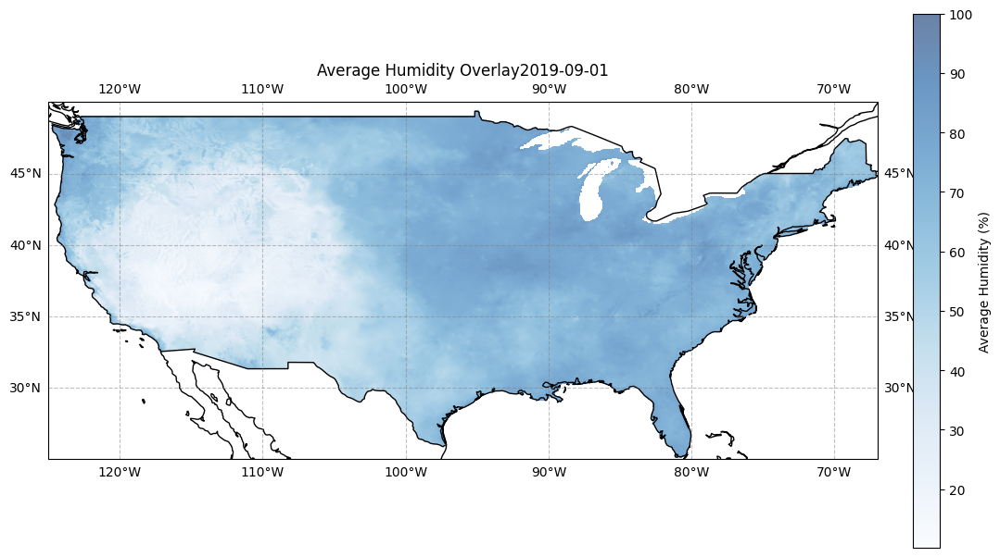

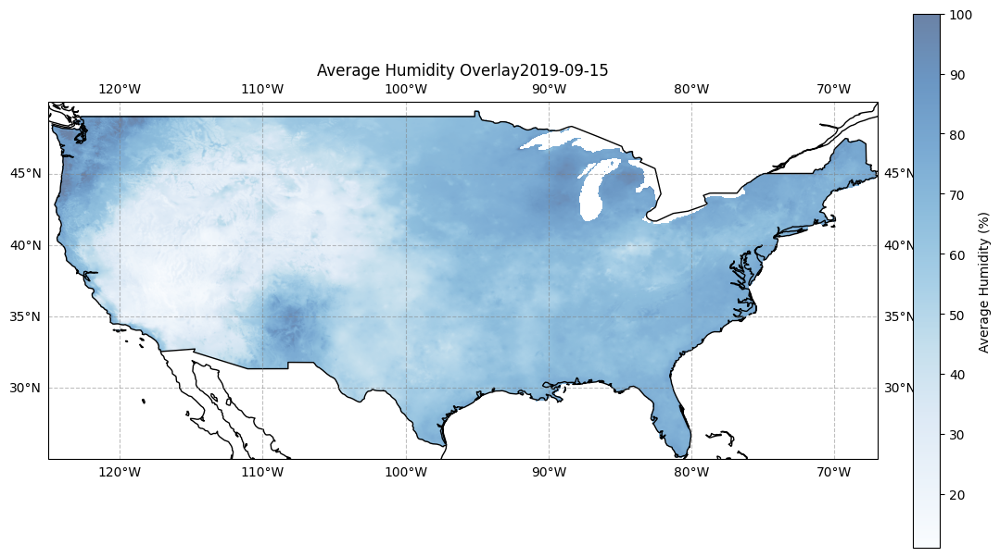

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01','2019-08-15','2019-09-01', '2019-09-15']

for day in dates_to_plot:
    humidity_plot(day)

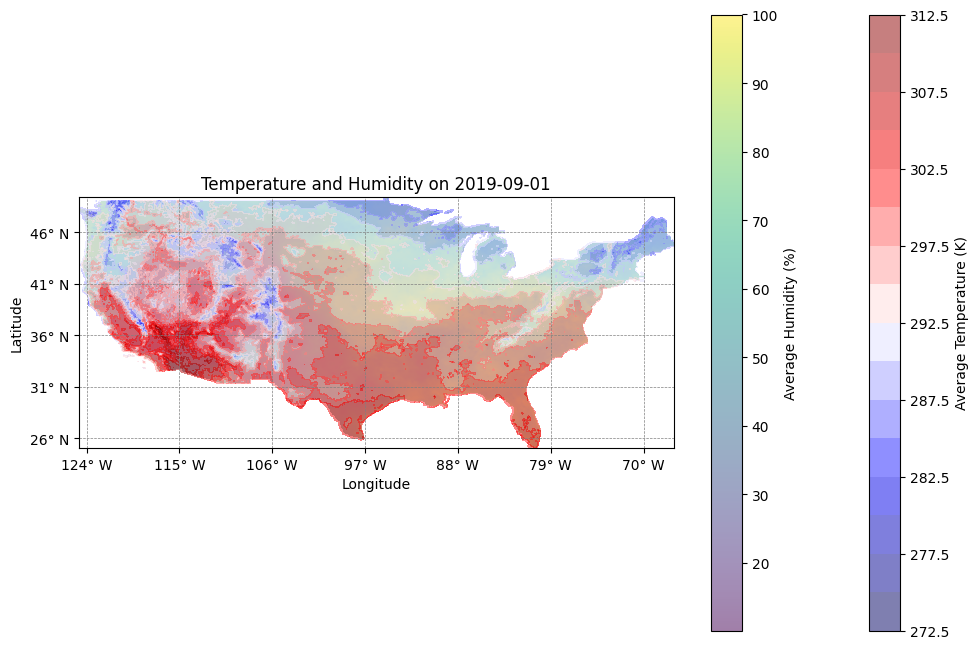

In [ ]:
day = '2019-09-01'
selected_day = temp_humid_ft.sel(day=day)

fig, ax = plt.subplots(figsize=(12, 8))

temp_contour = ax.contourf(
    selected_day['lon'],
    selected_day['lat'],
    selected_day['avg_temp'],
    levels=15,
    cmap='seismic', # Set color
    alpha=0.5
)

humidity_overlay = ax.imshow(
    selected_day['avg_humidity'],
    extent=[selected_day['lon'].min(), selected_day['lon'].max(),
            selected_day['lat'].min(), selected_day['lat'].max()],
    origin='upper',
    cmap='viridis', # Set color
    alpha=0.9
)

fig.colorbar(temp_contour, ax=ax, label='Average Temperature (K)')
plt.colorbar(humidity_overlay, ax=ax, label='Average Humidity (%)', orientation='vertical')

ax.set_title("Temperature and Humidity on " + str(day))
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

lon_min, lon_max = selected_day['lon'].min().item(), selected_day['lon'].max().item()
lat_min, lat_max = selected_day['lat'].min().item(), selected_day['lat'].max().item()

lon_ticks = np.arange(np.ceil(lon_min), np.floor(lon_max) , 9) # change grid ticks shown in map
lat_ticks = np.arange(np.ceil(lat_min), np.floor(lat_max) , 5)

ax.set_xticks(lon_ticks)
ax.set_yticks(lat_ticks)

ax.set_xticklabels([f"{lon:.0f}° E" if lon >= 0 else f"{-lon:.0f}° W" for lon in lon_ticks])
ax.set_yticklabels([f"{lat:.0f}° N" for lat in lat_ticks])

ax.grid(color='gray', linestyle='--', linewidth=0.5)

plt.show()

In [ ]:
pr = xr.open_dataset("pr_2019.nc")
pr.head(10)

<xarray.Dataset> Size: 8kB
Dimensions:               (lon: 10, lat: 10, day: 10, crs: 1)
Coordinates:
  * lon                   (lon) float64 80B -124.8 -124.7 ... -124.4 -124.4
  * lat                   (lat) float64 80B 49.4 49.36 49.32 ... 49.07 49.03
  * day                   (day) datetime64[ns] 80B 2019-01-01 ... 2019-01-10
  * crs                   (crs) uint16 2B 3
Data variables:
    precipitation_amount  (day, lat, lon) float64 8kB ...
Attributes: (12/19)
    geospatial_bounds_crs:      EPSG:4326
    Conventions:                CF-1.6
    geospatial_bounds:          POLYGON((-124.7666666333333 49.40000000000000...
    geospatial_lat_min:         25.066666666666666
    geospatial_lat_max:         49.40000000000000
    geospatial_lon_min:         -124.7666666333333
    ...                         ...
    date:                       05 May 2021
    note1:                      The projection information for this file is: ...
    note2:                      Citation: Abatzoglou, J.T., 2013, Development...
    note3:                      Data in slices after last_permanent_slice (1-...
    note4:                      Data in slices after last_provisional_slice (...
    note5:                      Days correspond approximately to calendar day...

In [ ]:
vpd = xr.open_dataset("vpd_2019.nc")
vpd.head(10)

<xarray.Dataset> Size: 8kB
Dimensions:                      (lon: 10, lat: 10, day: 10, crs: 1)
Coordinates:
  * lon                          (lon) float64 80B -124.8 -124.7 ... -124.4
  * lat                          (lat) float64 80B 49.4 49.36 ... 49.07 49.03
  * day                          (day) datetime64[ns] 80B 2019-01-01 ... 2019...
  * crs                          (crs) uint16 2B 3
Data variables:
    mean_vapor_pressure_deficit  (day, lat, lon) float64 8kB ...
Attributes: (12/19)
    geospatial_bounds_crs:      EPSG:4326
    Conventions:                CF-1.6
    geospatial_bounds:          POLYGON((-124.7666666333333 49.40000000000000...
    geospatial_lat_min:         25.066666666666666
    geospatial_lat_max:         49.40000000000000
    geospatial_lon_min:         -124.7666666333333
    ...                         ...
    date:                       26 April 2021
    note1:                      The projection information for this file is: ...
    note2:                      Citation: Abatzoglou, J.T., 2013, Development...
    note3:                      Data in slices after last_permanent_slice (1-...
    note4:                      Data in slices after last_provisional_slice (...
    note5:                      Days correspond approximately to calendar day...

In [ ]:
def precipitation_plot(day):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    selected_day = pr.sel(day=day)
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    precipitation = ax.contourf(
        selected_day['lon'], selected_day['lat'],
        selected_day['precipitation_amount'],
        transform=ccrs.PlateCarree(),
        cmap='Blues',  # Set color
        alpha=1
    )

    cbar = fig.colorbar(precipitation, ax=ax, orientation="vertical", fraction=0.03, pad=0.04)
    cbar.set_label("Average Precipitation (mm)")

    plt.title("Average Precipitation Overlay for " + day)
    gl = ax.gridlines(draw_labels=True, linestyle="--", color="gray")
    gl.top_labels = False
    gl.right_labels = False

    plt.show()

In [ ]:
def vapour_pressure_plot(day):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    selected_day = vpd.sel(day=day)
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    precipitation = ax.contourf(
        selected_day['lon'], selected_day['lat'],
        selected_day['mean_vapor_pressure_deficit'],
        transform=ccrs.PlateCarree(),
        cmap='Blues', # set color
        alpha=1
    )

    cbar = fig.colorbar(precipitation, ax=ax, orientation="vertical", fraction=0.03, pad=0.04)
    cbar.set_label("Average mean_vapor_pressure_deficit (mm)")

    plt.title("Average mean_vapor_pressure_deficit Overlay for " + day)
    gl = ax.gridlines(draw_labels=True, linestyle="--", color="gray")
    gl.top_labels = gl.right_labels = False

    plt.show()

In [ ]:
def overlay_plot(day):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    selected_vpd = vpd.sel(day=day)
    vpd_contour = ax.contourf(
        selected_vpd['lon'], selected_vpd['lat'],
        selected_vpd['mean_vapor_pressure_deficit'],
        transform=ccrs.PlateCarree(),
        cmap='OrRd',
        alpha=0.6,
        levels=20
    )

    selected_pr = pr.sel(day=day)
    pr_contour = ax.contourf(
        selected_pr['lon'], selected_pr['lat'],
        selected_pr['precipitation_amount'],
        transform=ccrs.PlateCarree(),
        cmap='Blues',
        alpha=0.6,
        levels=20
    )

    cbar_vpd = fig.colorbar(vpd_contour, ax=ax, orientation="vertical", fraction=0.03, pad=0.05, shrink=0.8)
    cbar_vpd.set_label("Mean Vapor Pressure Deficit (hPa)")
    cbar_vpd.ax.set_ylim([0, selected_vpd['mean_vapor_pressure_deficit'].max()])

    cbar_pr = fig.colorbar(pr_contour, ax=ax, orientation="vertical", fraction=0.03, pad=0.15, shrink=0.8)
    cbar_pr.set_label("Total Precipitation (mm)")
    cbar_pr.ax.set_ylim([0, selected_pr['precipitation_amount'].max()])

    plt.title("Vapor Pressure Deficit and Precipitation Overlay for " + day)
    gl = ax.gridlines(draw_labels=True, linestyle="--", color="gray")
    gl.top_labels = gl.right_labels = False

    plt.show()

local

In [ ]:
def overlay_plot(day):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    selected_vpd = vpd.sel(day=day)
    vpd_contour = ax.contourf(
        selected_vpd['lon'], selected_vpd['lat'],
        selected_vpd['mean_vapor_pressure_deficit'],
        transform=ccrs.PlateCarree(),
        cmap='OrRd', # set colot
        alpha=0.6,
        levels=20
    )

    selected_pr = pr.sel(day=day)
    pr_contour = ax.contourf(
        selected_pr['lon'], selected_pr['lat'],
        selected_pr['precipitation_amount'],
        transform=ccrs.PlateCarree(),
        cmap='Blues', # set color
        alpha=0.6,
        levels=20
    )

    cbar_vpd = fig.colorbar(vpd_contour, ax=ax, orientation="vertical", fraction=0.03, pad=0.1)
    cbar_vpd.set_label("Mean Vapor Pressure Deficit (hPa)", labelpad=5)

    cbar_pr = fig.colorbar(pr_contour, ax=ax, orientation="vertical", fraction=0.03, pad=0.1)
    cbar_pr.set_label("Total Precipitation (mm)", labelpad=5)

    plt.title("Vapor Pressure Deficit and Precipitation Overlay for " + day)
    gl = ax.gridlines(draw_labels=True, linestyle="--", color="gray")
    gl.top_labels = gl.right_labels = False
    plt.savefig(f"pr_vpd_plot_{day}.png", dpi=600)
    plt.show()


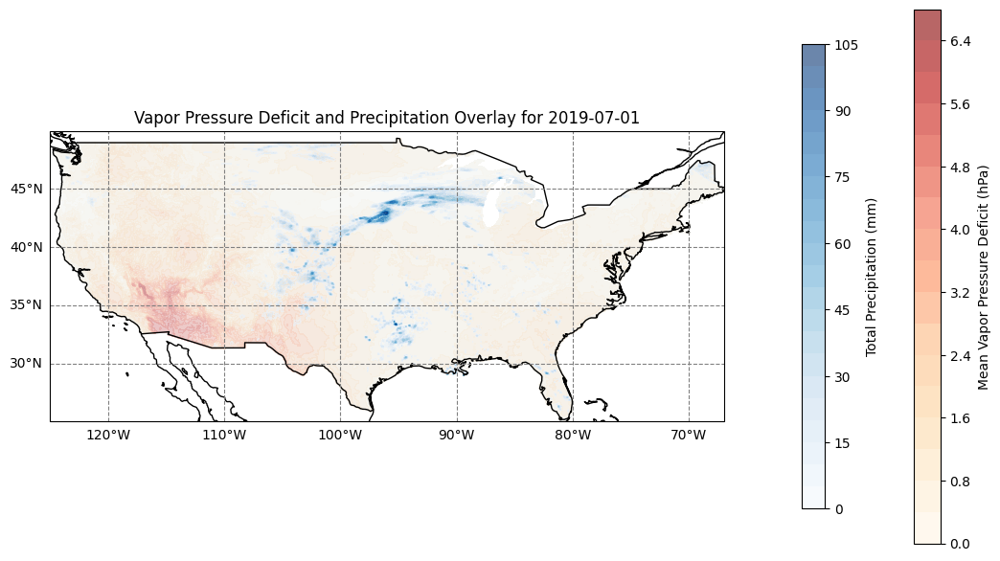

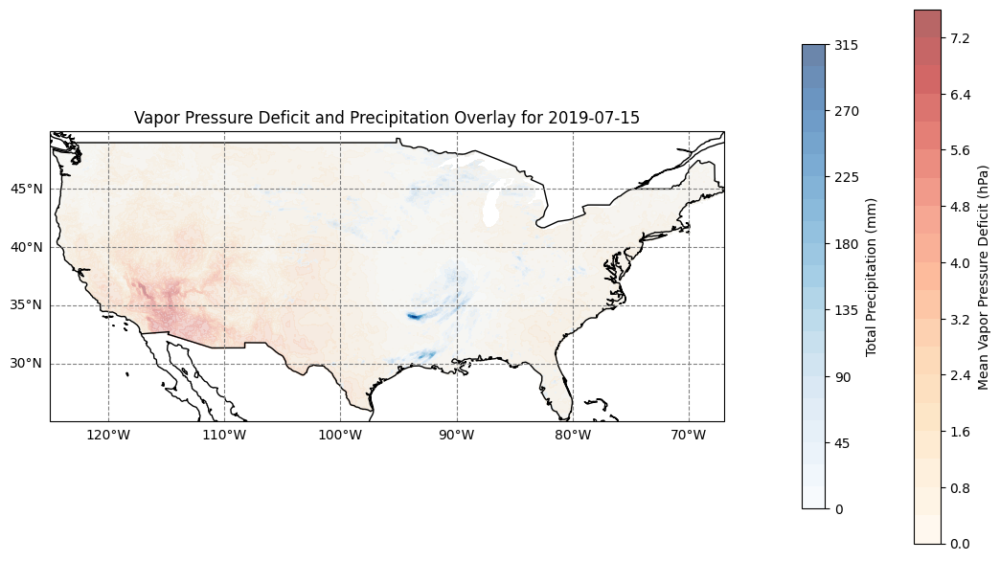

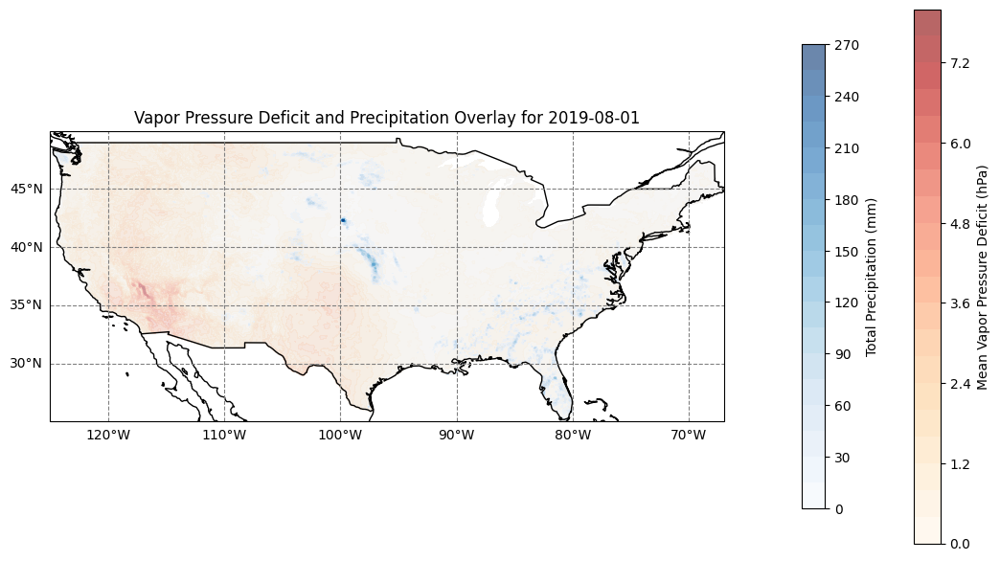

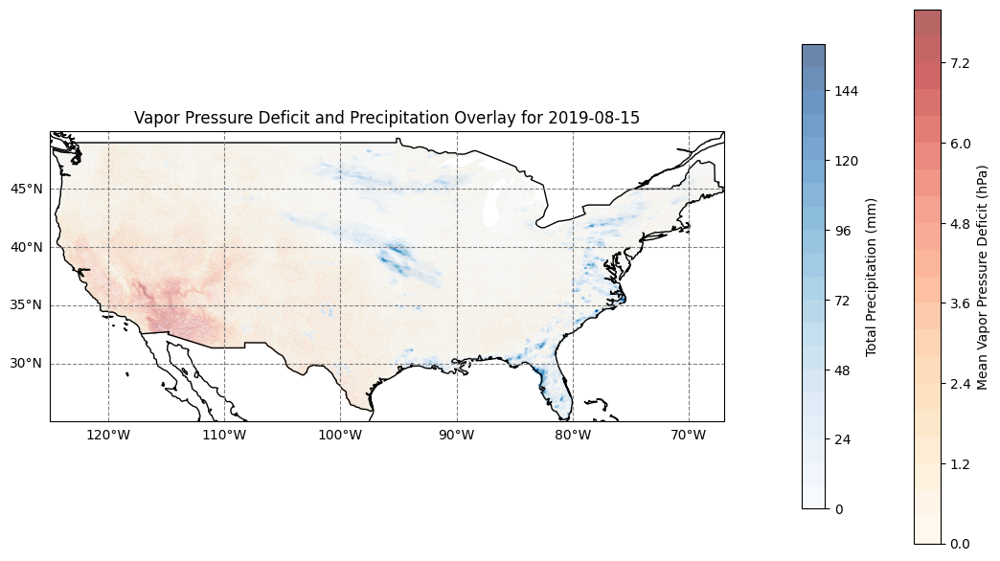

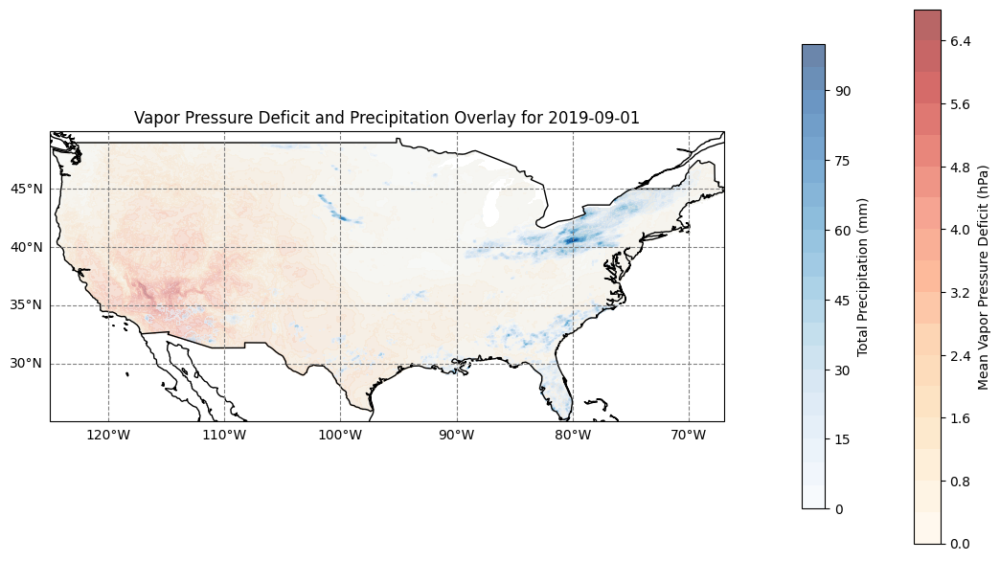

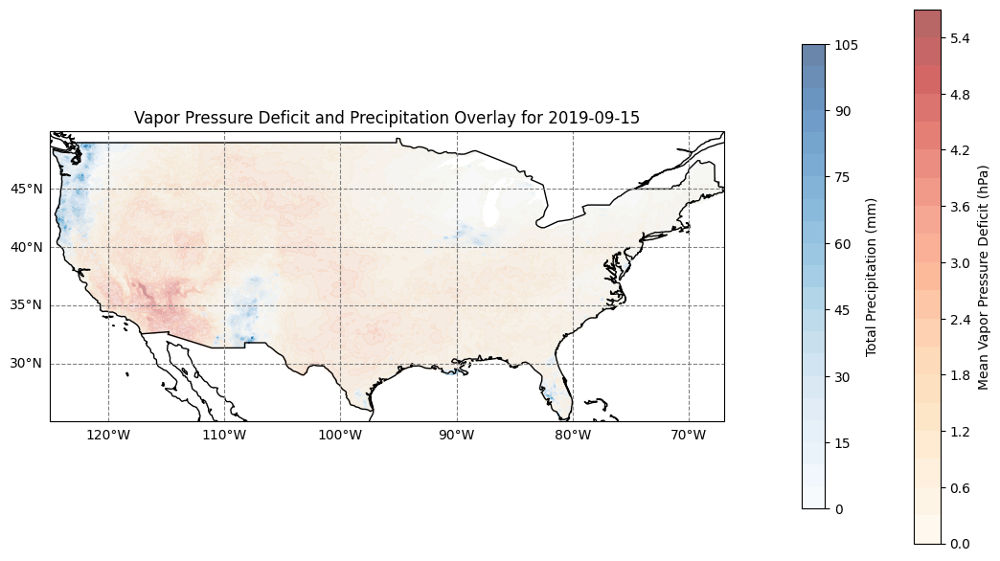

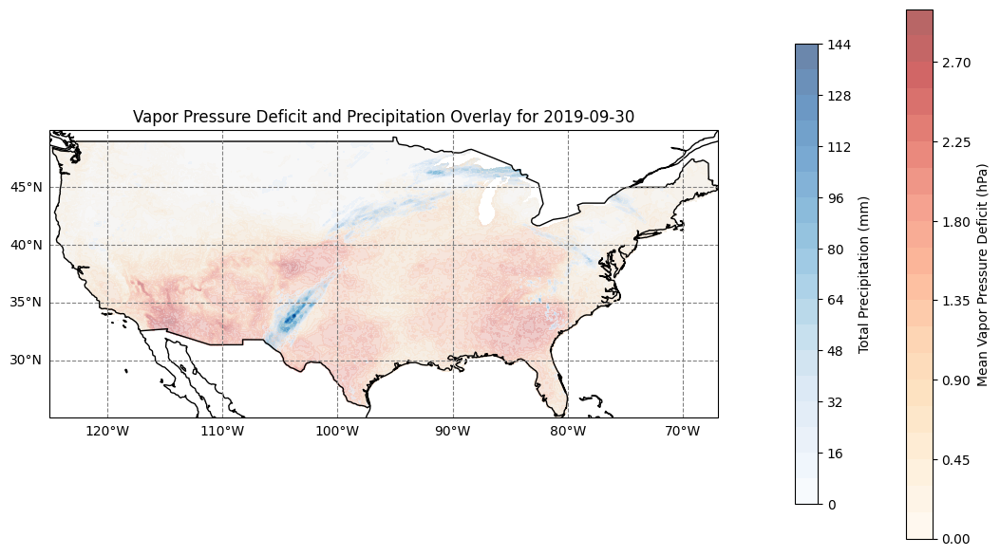

In [ ]:

dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']

for day in dates_to_plot:
    overlay_plot(day)

global


In [ ]:

def overlay_plot(day):
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    selected_vpd = vpd.sel(day=day)
    vpd_contour = ax.contourf(
        selected_vpd['lon'], selected_vpd['lat'],
        selected_vpd['mean_vapor_pressure_deficit'],
        transform=ccrs.PlateCarree(),
        cmap='OrRd', # set color
        alpha=0.8,
        levels=20,
        vmin=global_min_vpd,
        vmax=global_max_vpd
    )

    selected_pr = pr.sel(day=day)
    pr_contour = ax.contourf(
        selected_pr['lon'], selected_pr['lat'],
        selected_pr['precipitation_amount'],
        transform=ccrs.PlateCarree(),
        cmap='Blues', # set color
        alpha=0.8,
        levels=20,
        vmin=global_min_pr,
        vmax=global_max_pr
    )

    cbar_vpd = fig.colorbar(vpd_contour, ax=ax, orientation="vertical", fraction=0.03, pad=0.1)
    cbar_vpd.set_label("Mean Vapor Pressure Deficit (hPa)", labelpad=5)

    cbar_pr = fig.colorbar(pr_contour, ax=ax, orientation="vertical", fraction=0.03, pad=0.1)
    cbar_pr.set_label("Total Precipitation (mm)", labelpad=5)


    plt.title("Vapor Pressure Deficit and Precipitation Overlay for " + day)
    gl = ax.gridlines(draw_labels=True, linestyle="--", color="gray")
    gl.top_labels = gl.right_labels = False
    plt.savefig(f"pr_vpd_plot_{day}.png", dpi=600)
    plt.show()


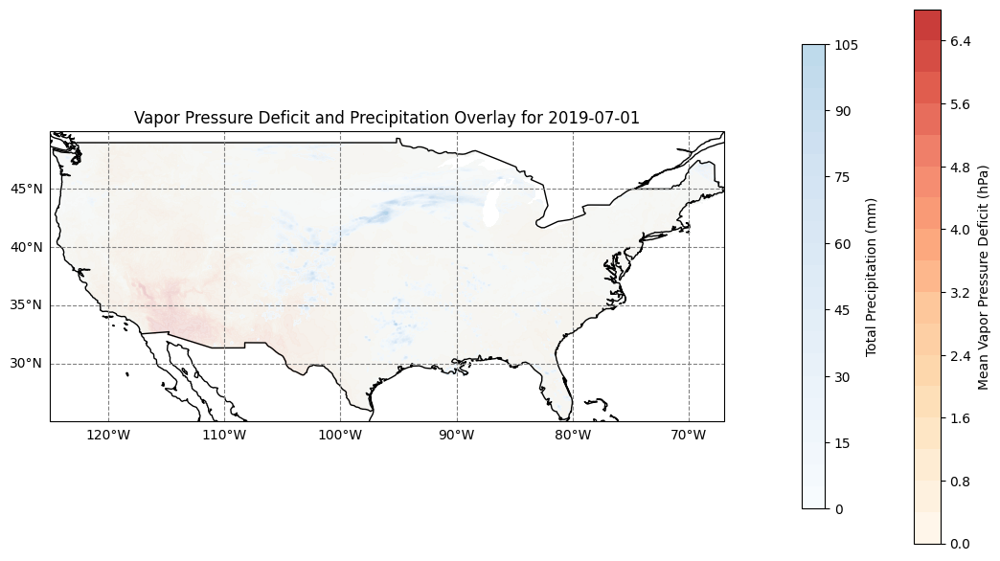

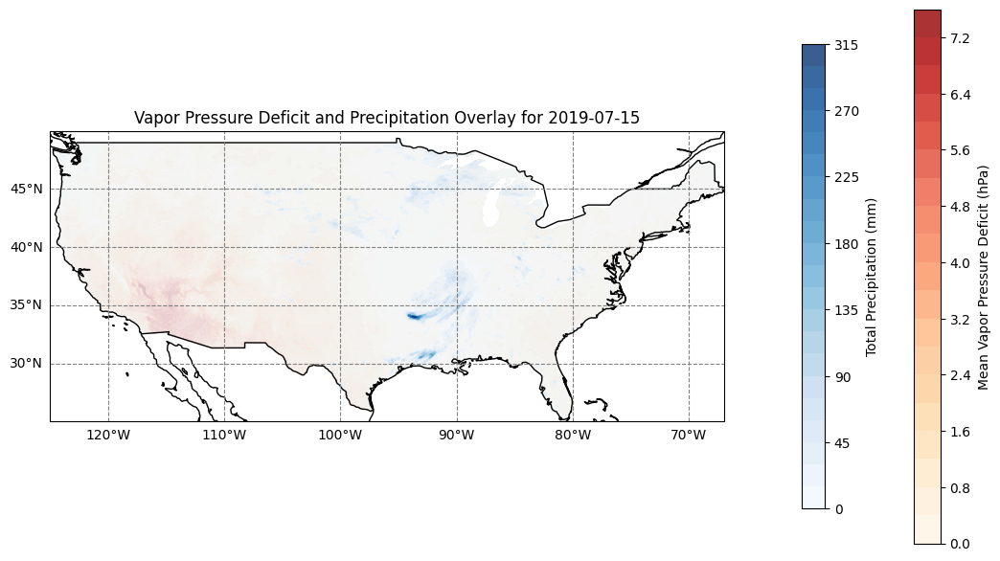

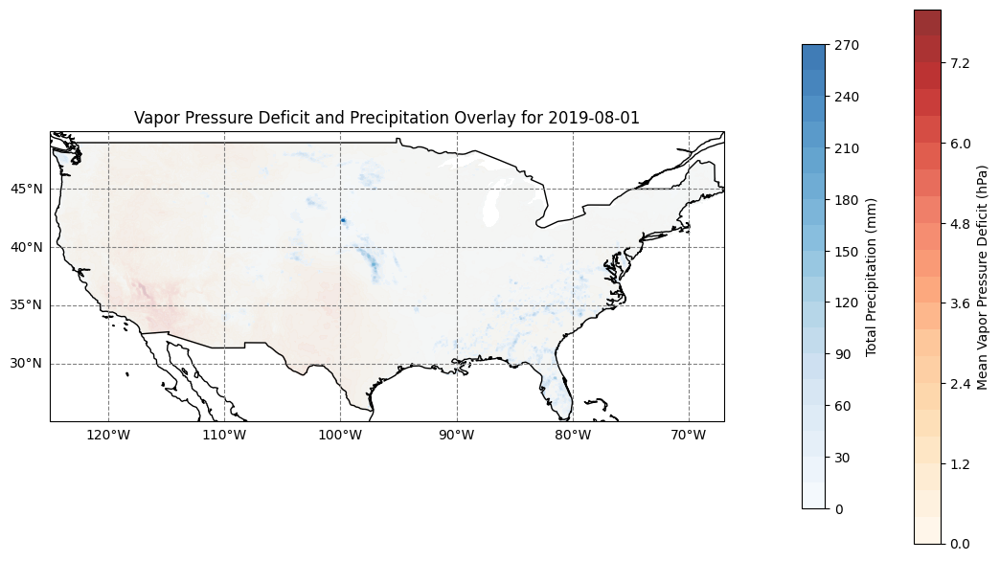

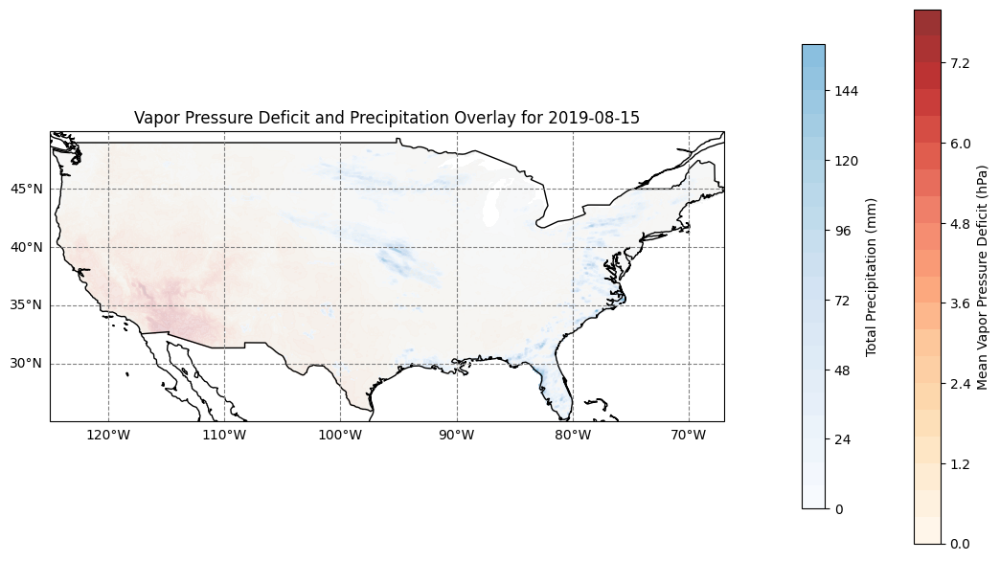

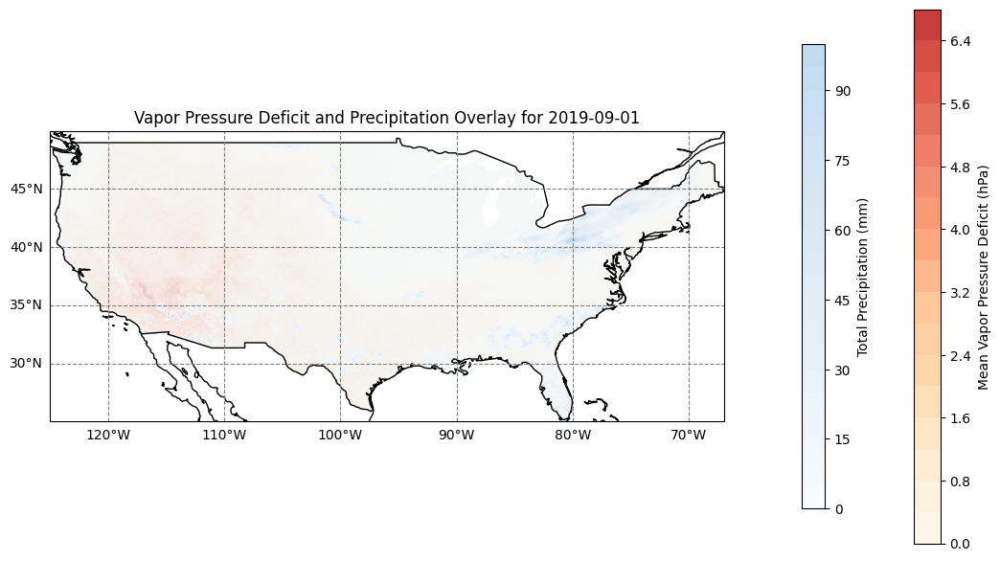

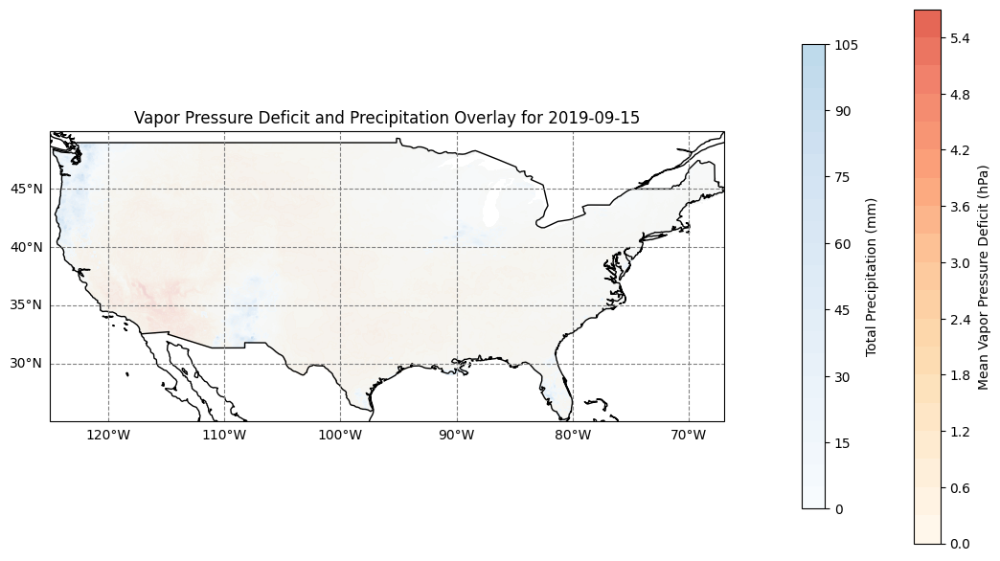

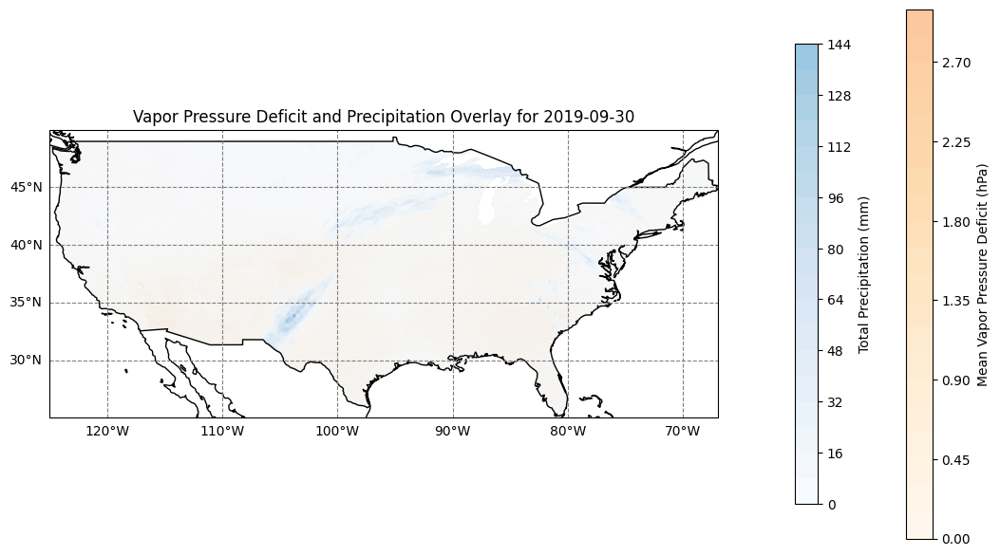

In [ ]:
global_min_vpd = global_max_vpd = global_min_pr =  global_max_pr = 0
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']

for date in dates_to_plot:
    temp_day = pr['precipitation_amount'].sel(day=date)
    day_min = np.nanmin(temp_day)
    day_max = np.nanmax(temp_day)
    global_min_pr = min(global_min_pr, day_min)
    global_max_pr = max(global_max_pr, day_max)
    temp_day = vpd['mean_vapor_pressure_deficit'].sel(day=date)
    day_min = np.nanmin(temp_day)
    day_max = np.nanmax(temp_day)
    global_min_vpd = min(global_min_vpd, day_min)
    global_max_vpd = max(global_max_vpd, day_max)

for day in dates_to_plot:
    overlay_plot(day)

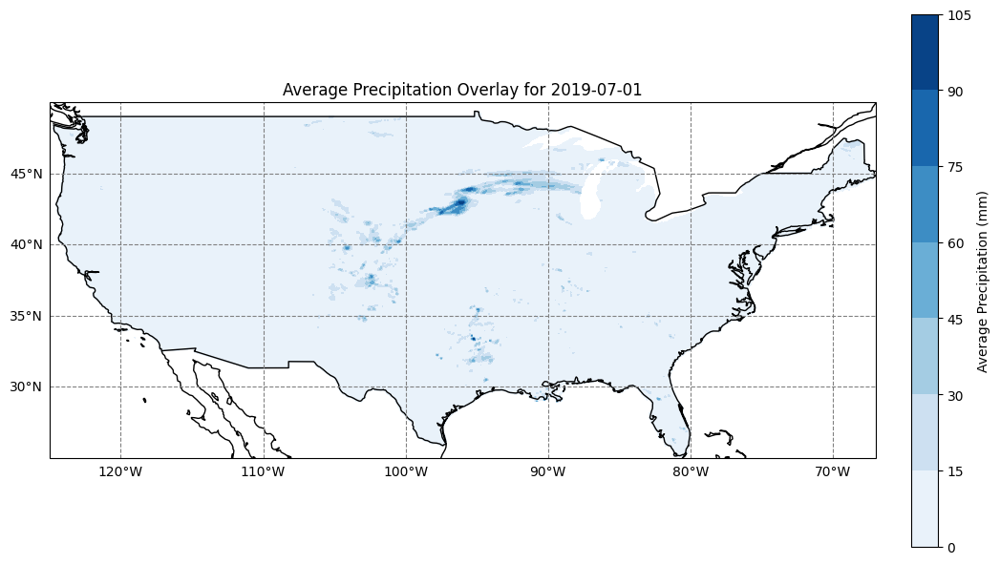

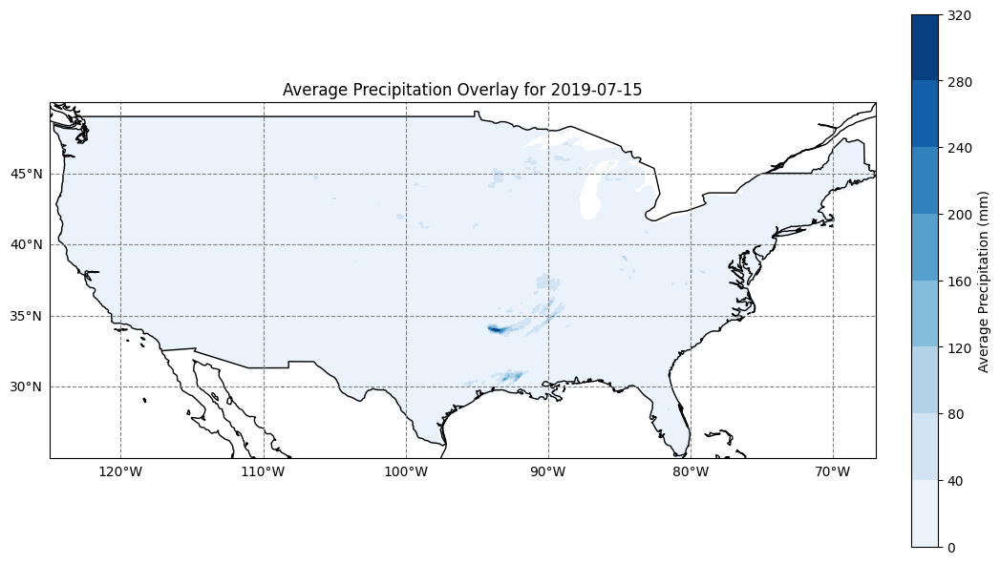

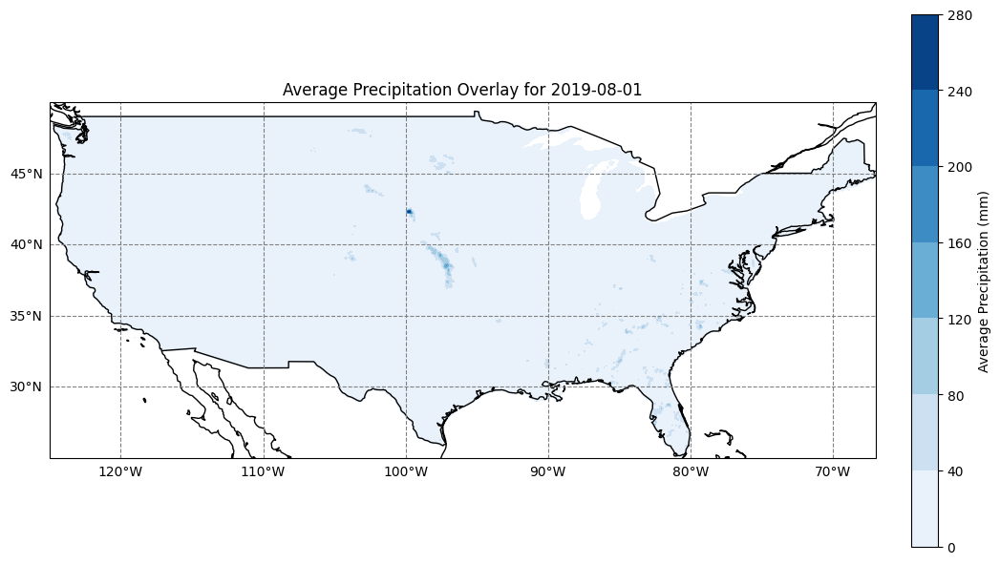

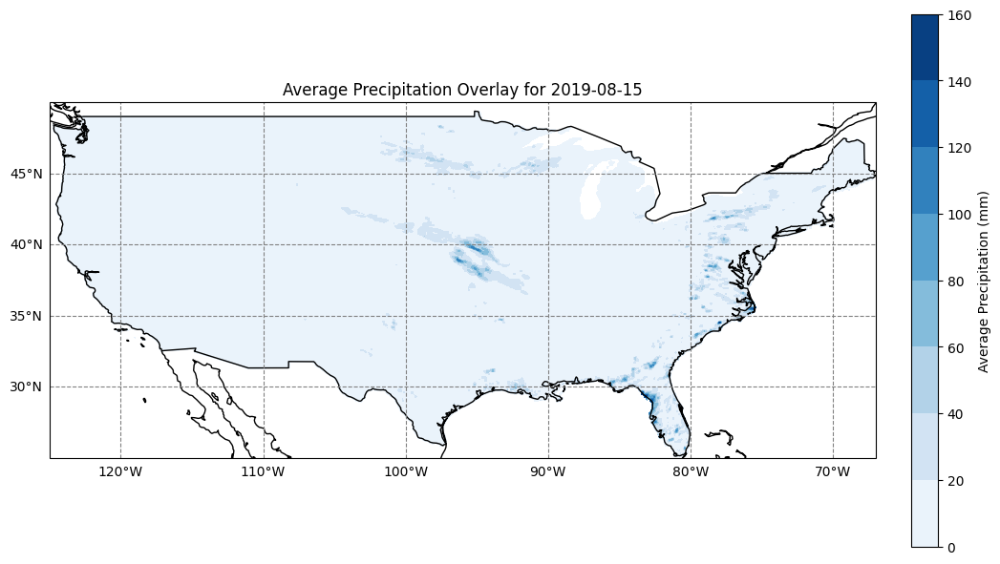

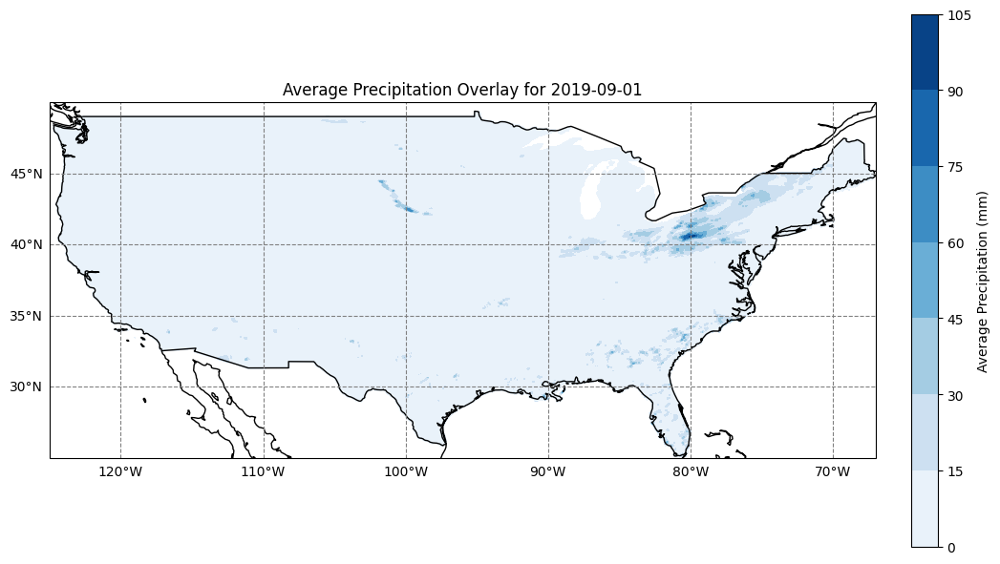

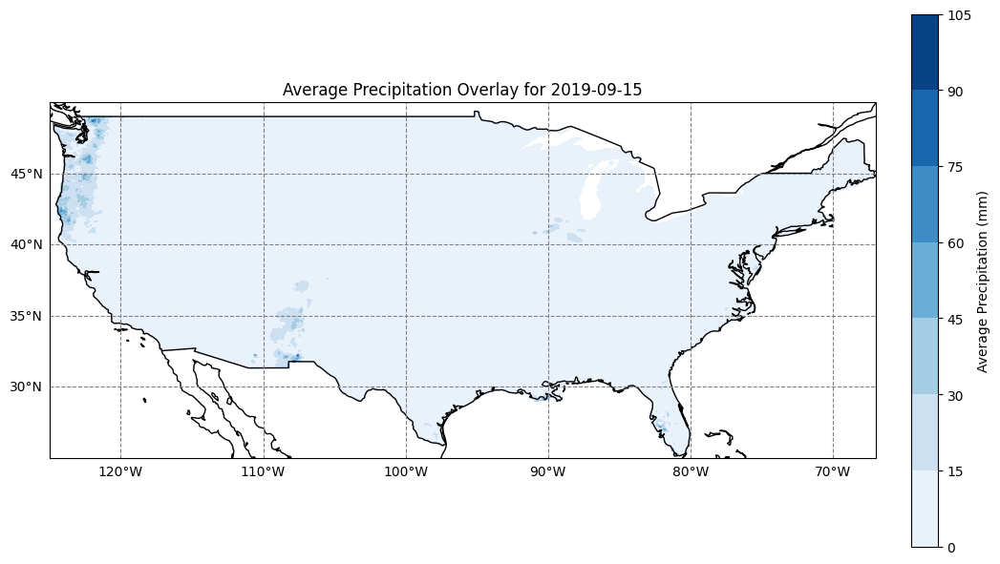

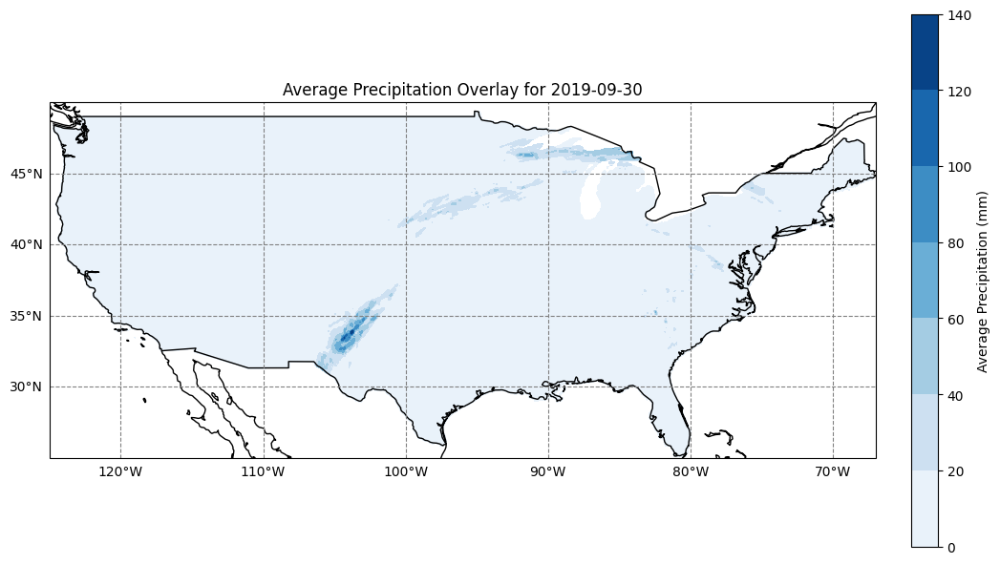

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']

for day in dates_to_plot:
    precipitation_plot(day)

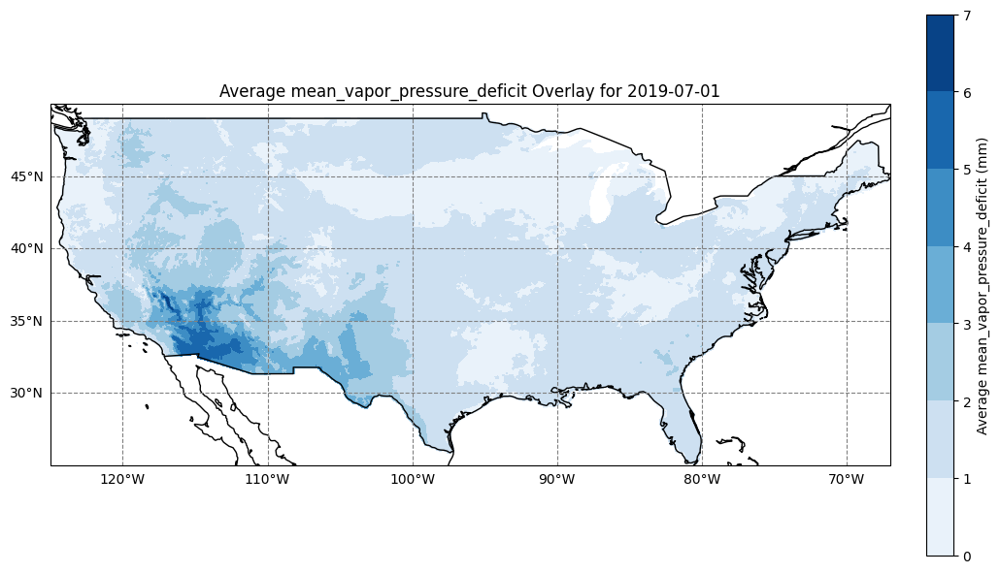

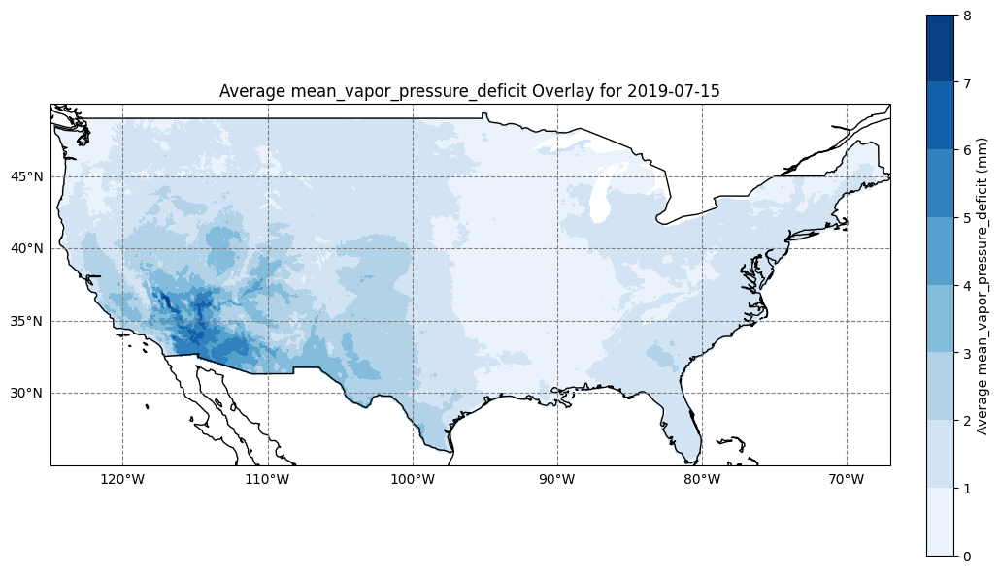

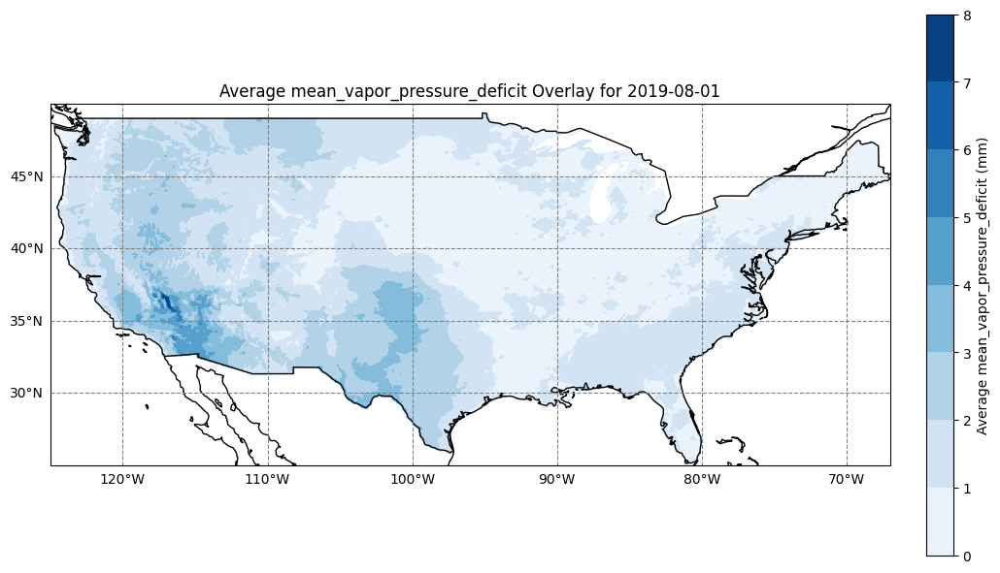

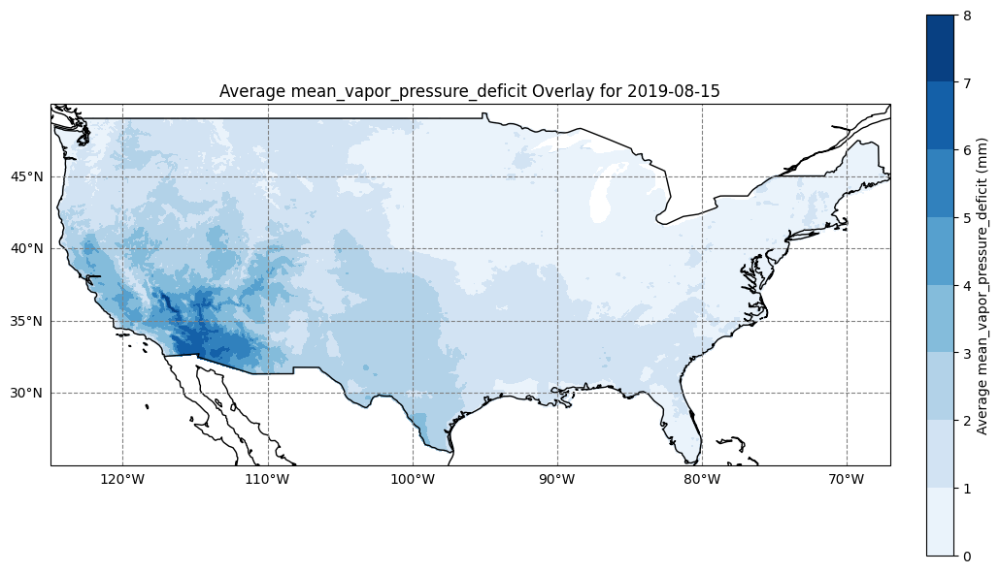

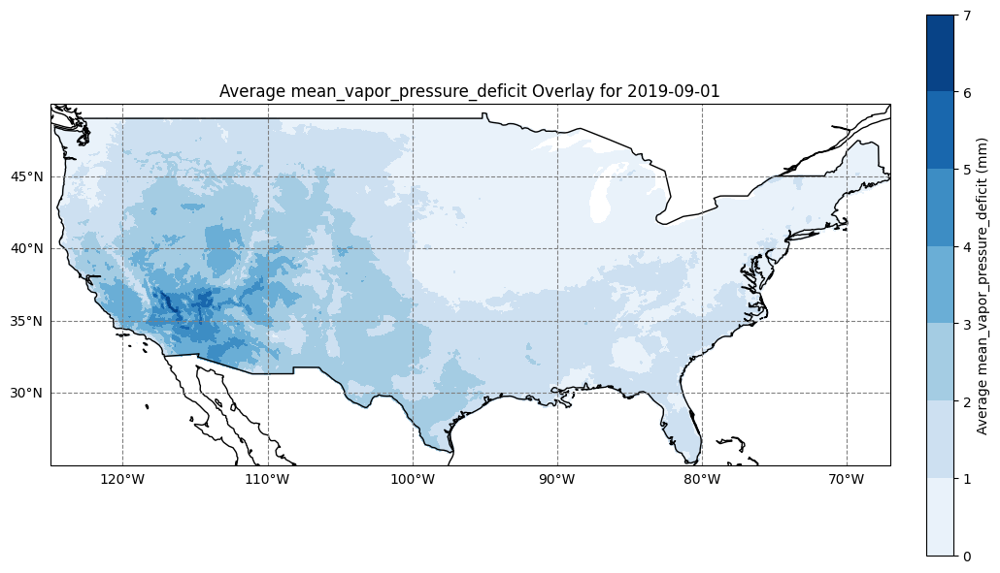

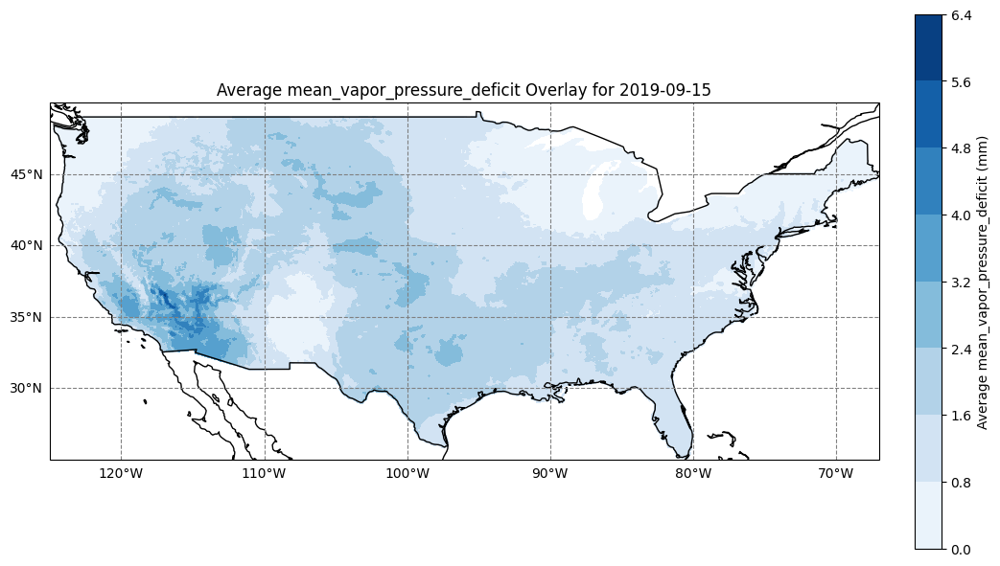

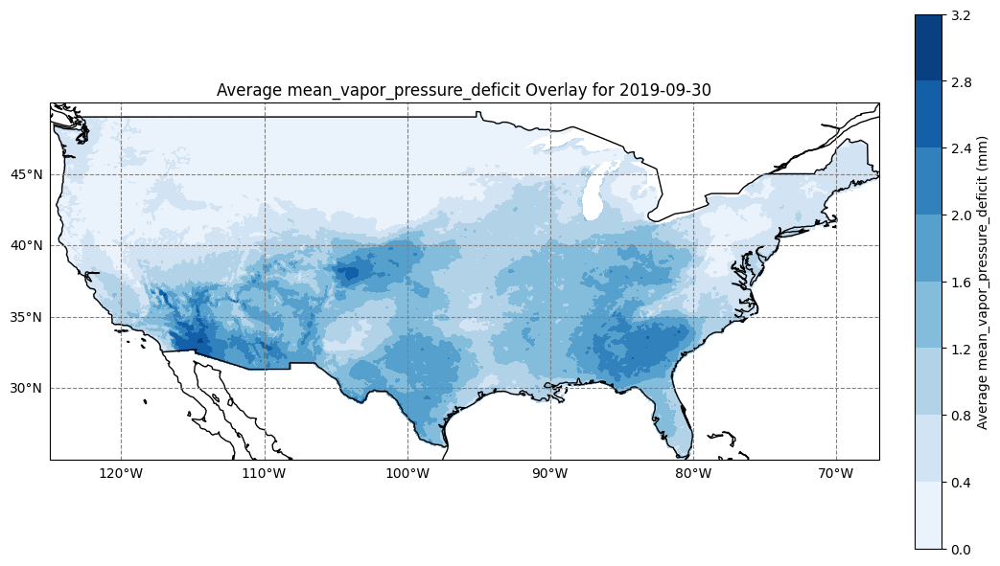

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']

for day in dates_to_plot:
    vapour_pressure_plot(day)

In [ ]:
def plot_dead_fuel_moisture(day):

  selected_day = fm100.sel(day=day)

  fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})
  ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())
  ax.coastlines()
  ax.add_feature(cartopy.feature.BORDERS)

  # Temperature contour fill
  # temp = ax.contourf(
  #     selected_day['lon'],
  #     selected_day['lat'],
  #     selected_day['dead_fuel_moisture_100hr'],
  #     levels=15,
  #     cmap='Greens',
  #     alpha=0.8
  # )
  temp = ax.imshow(
    selected_day['dead_fuel_moisture_100hr'],
    extent=[selected_day['lon'].min(), selected_day['lon'].max(),
            selected_day['lat'].min(), selected_day['lat'].max()],
    origin='upper',
    cmap='Greens',
    alpha=0.8,
    transform=ccrs.PlateCarree()
  )


  fig.colorbar(temp, ax=ax, label='Average Dead Fuel Moisture (%)')

  gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
  gl.xlabels_top = False
  gl.ylabels_right = False

  ax.set_title("Dead Fuel Moisture on " + str(day))
  ax.set_xlabel("Longitude")
  ax.set_ylabel("Latitude")
  plt.savefig(f"dead_fuel_moisture_plot_{day}.png", dpi=600)
  plt.show()

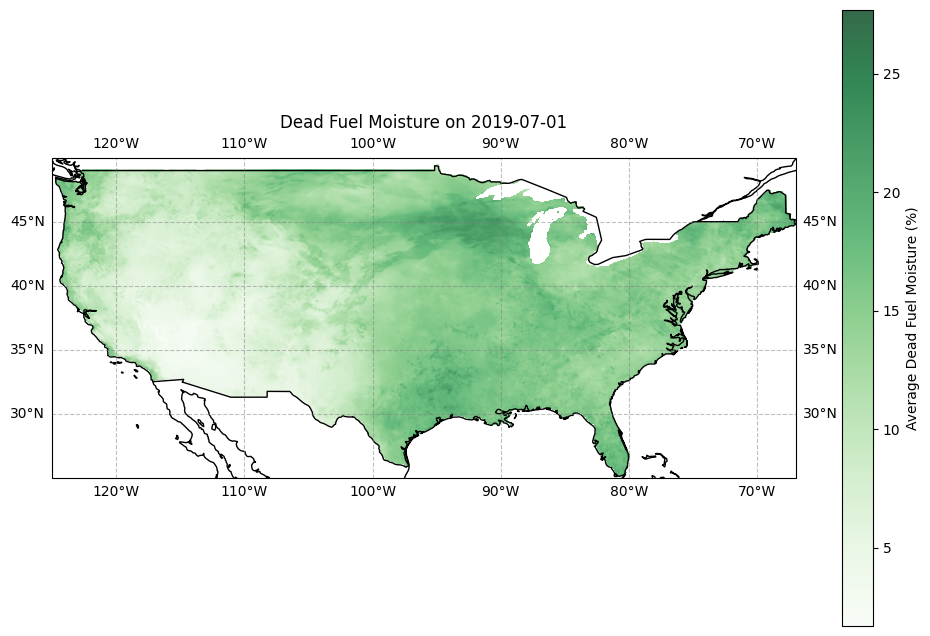

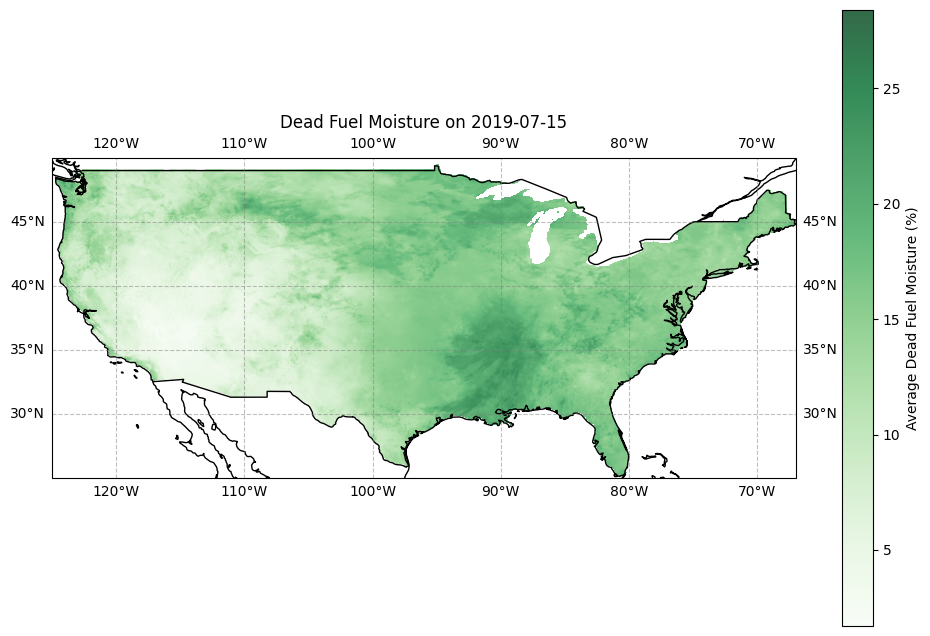

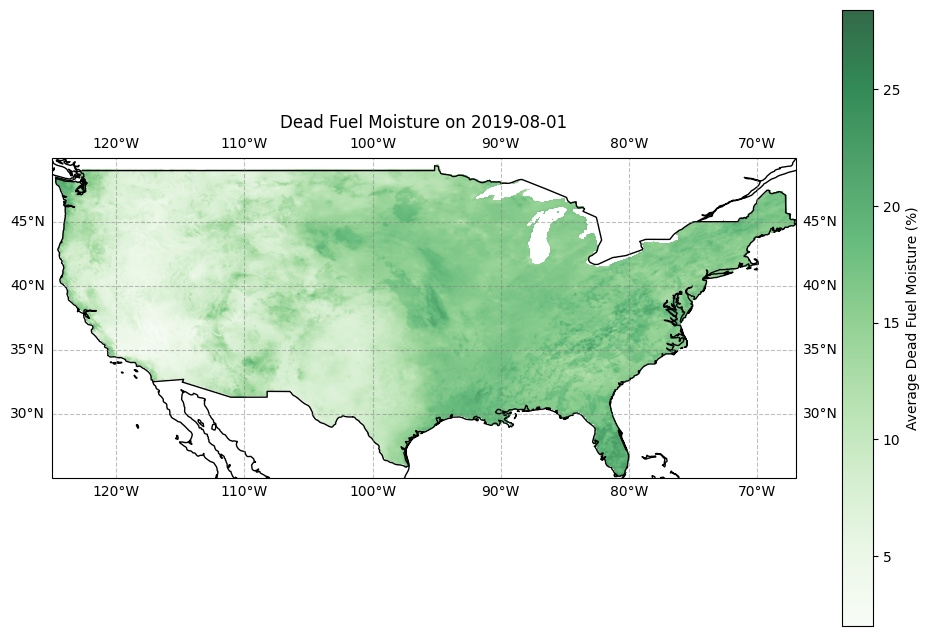

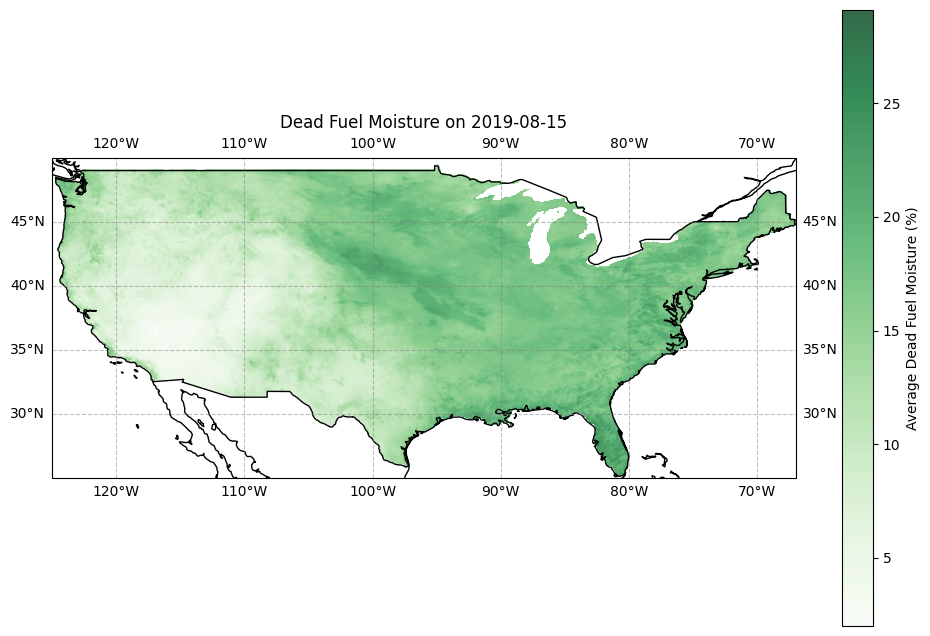

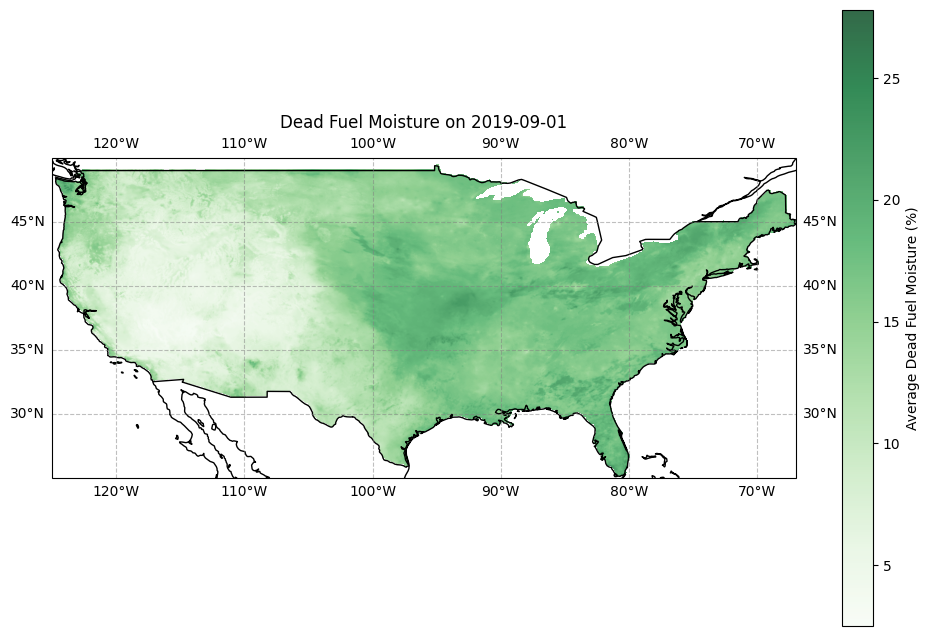

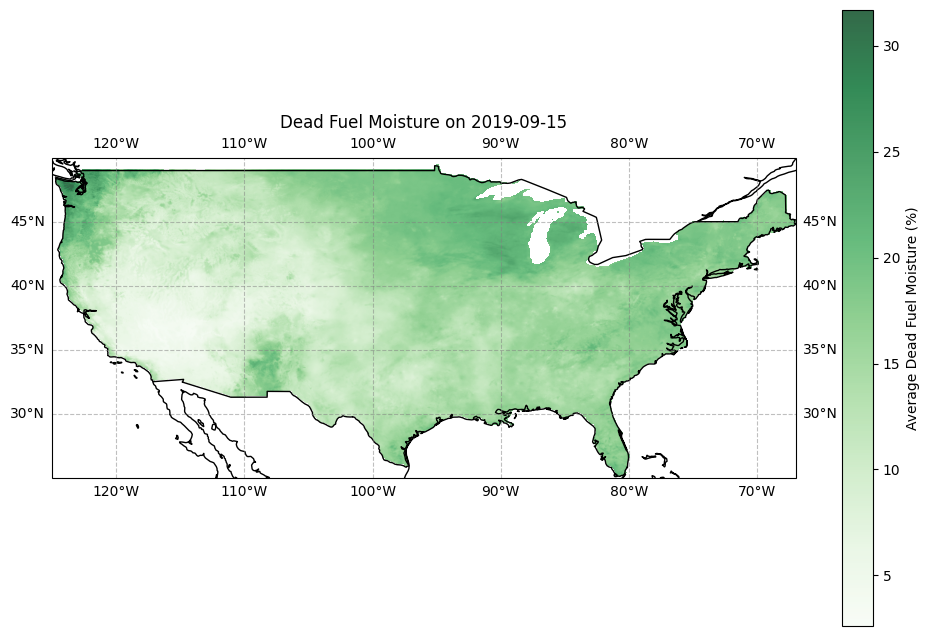

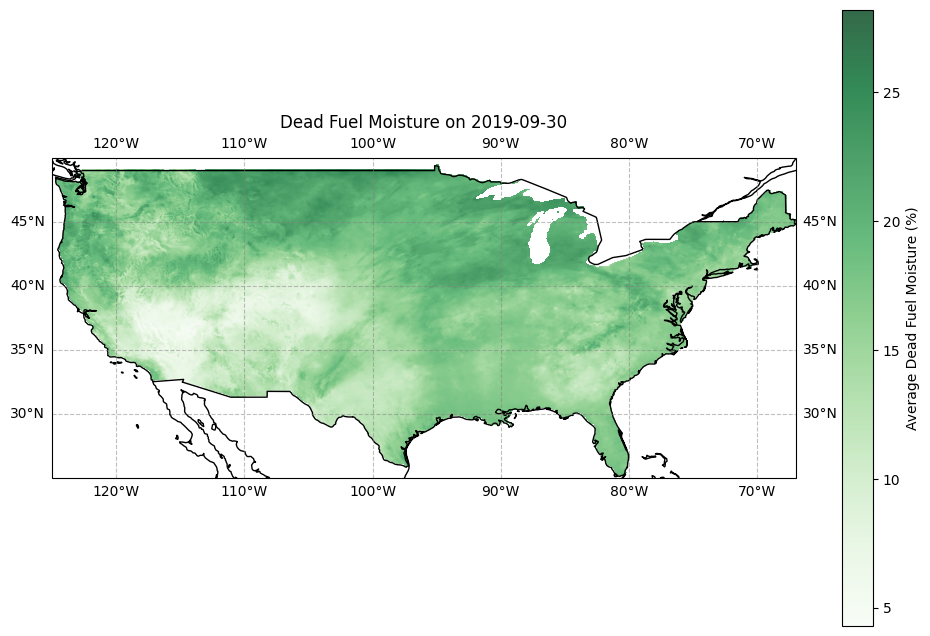

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']

for day in dates_to_plot:
    plot_dead_fuel_moisture(day)

In [ ]:
rmax.head(10)

<xarray.Dataset> Size: 8kB
Dimensions:            (lon: 10, lat: 10, day: 10, crs: 1)
Coordinates:
  * lon                (lon) float64 80B -124.8 -124.7 -124.7 ... -124.4 -124.4
  * lat                (lat) float64 80B 49.4 49.36 49.32 ... 49.11 49.07 49.03
  * day                (day) datetime64[ns] 80B 2019-01-01 ... 2019-01-10
  * crs                (crs) uint16 2B 3
Data variables:
    relative_humidity  (day, lat, lon) float64 8kB ...
Attributes: (12/19)
    geospatial_bounds_crs:      EPSG:4326
    Conventions:                CF-1.6
    geospatial_bounds:          POLYGON((-124.7666666333333 49.40000000000000...
    geospatial_lat_min:         25.066666666666666
    geospatial_lat_max:         49.40000000000000
    geospatial_lon_min:         -124.7666666333333
    ...                         ...
    date:                       26 April 2021
    note1:                      The projection information for this file is: ...
    note2:                      Citation: Abatzoglou, J.T., 2013, Development...
    note3:                      Data in slices after last_permanent_slice (1-...
    note4:                      Data in slices after last_provisional_slice (...
    note5:                      Days correspond approximately to calendar day...

In [ ]:
def plot_max_relative_humidity(day):

  selected_day = rmax.sel(day=day)

  fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

  ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

  ax.coastlines()
  ax.add_feature(cartopy.feature.BORDERS)

  #temp = ax.contourf(
  #   selected_day['lon'],
  #    selected_day['lat'],
  #    selected_day['relative_humidity'],
  #    levels=15,
  #   cmap='seismic_r',
  #    alpha=0.8
  #)
  temp = ax.imshow(
    selected_day['relative_humidity'],
    extent=[selected_day['lon'].min(), selected_day['lon'].max(),
            selected_day['lat'].min(), selected_day['lat'].max()],
    origin='upper',
    cmap='cool', # set color
    alpha=0.8,
    transform=ccrs.PlateCarree()
  )

  fig.colorbar(temp, ax=ax, label='Average Max Relative Humidity')

  gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
  gl.xlabels_top = False
  gl.ylabels_right = False

  ax.set_title("Max Relative Humidity on " + str(day))
  ax.set_xlabel("Longitude")
  ax.set_ylabel("Latitude")
  plt.savefig(f"humidity_plot_{day}.png", dpi=600)
  plt.show()

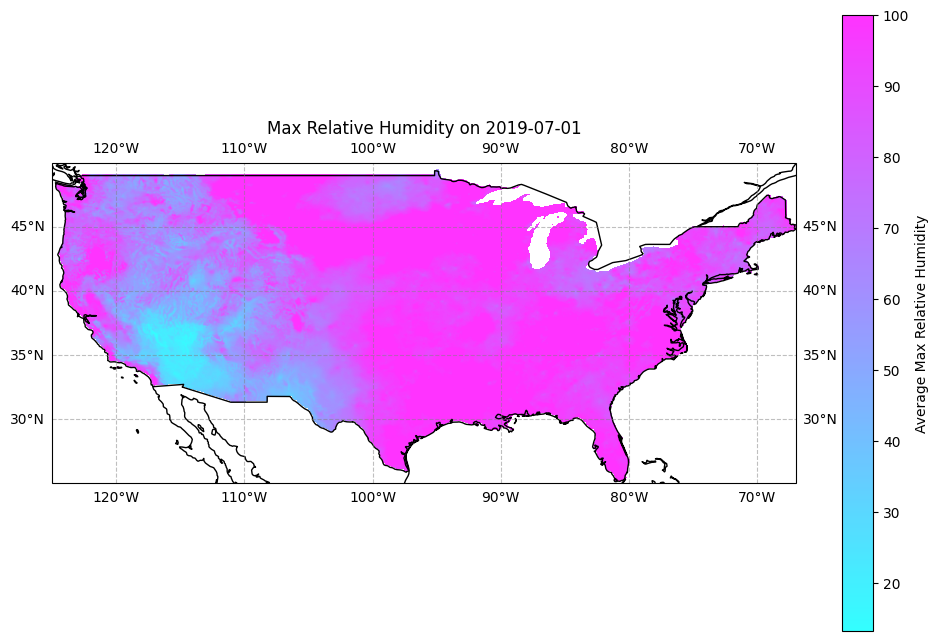

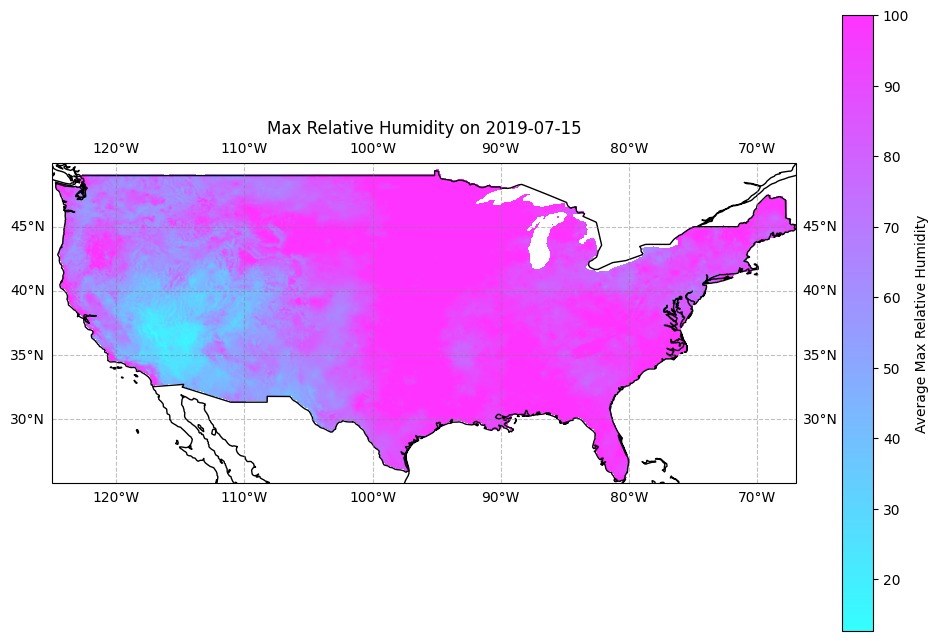

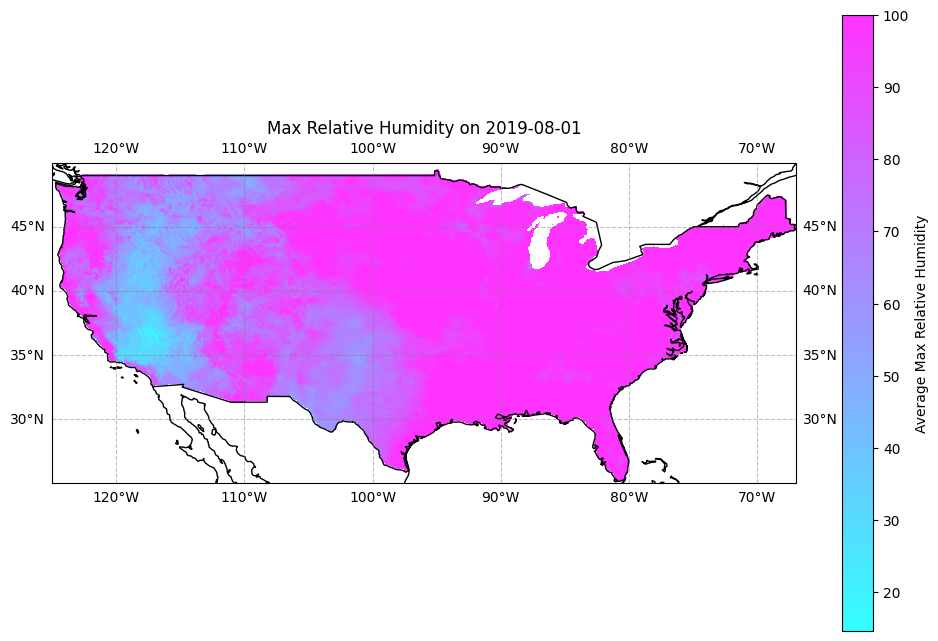

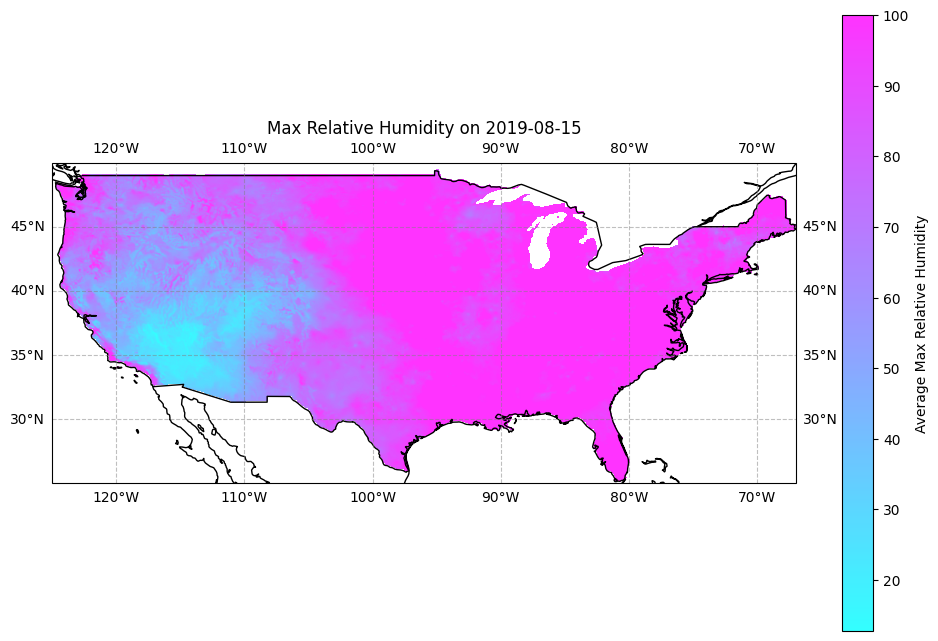

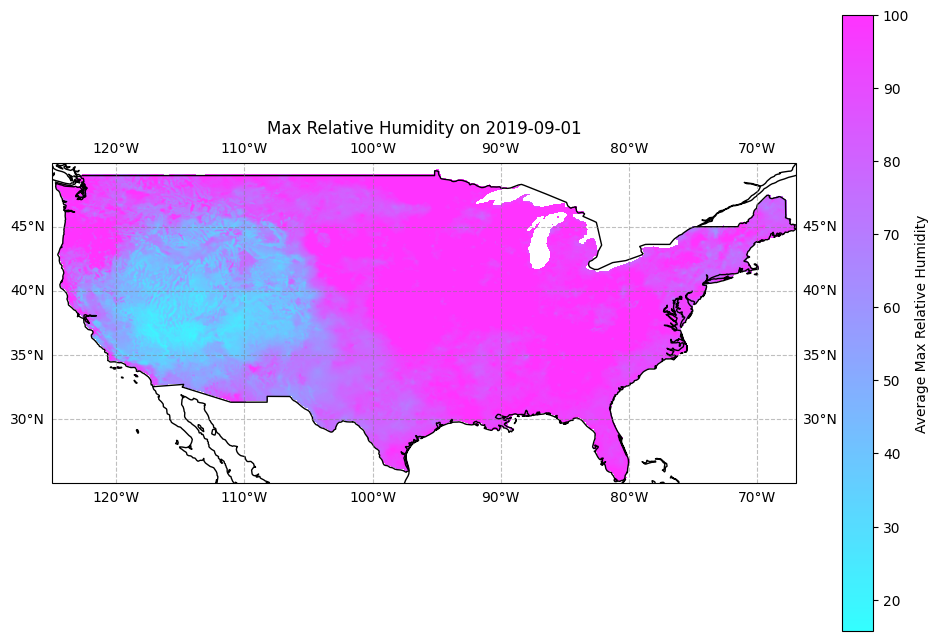

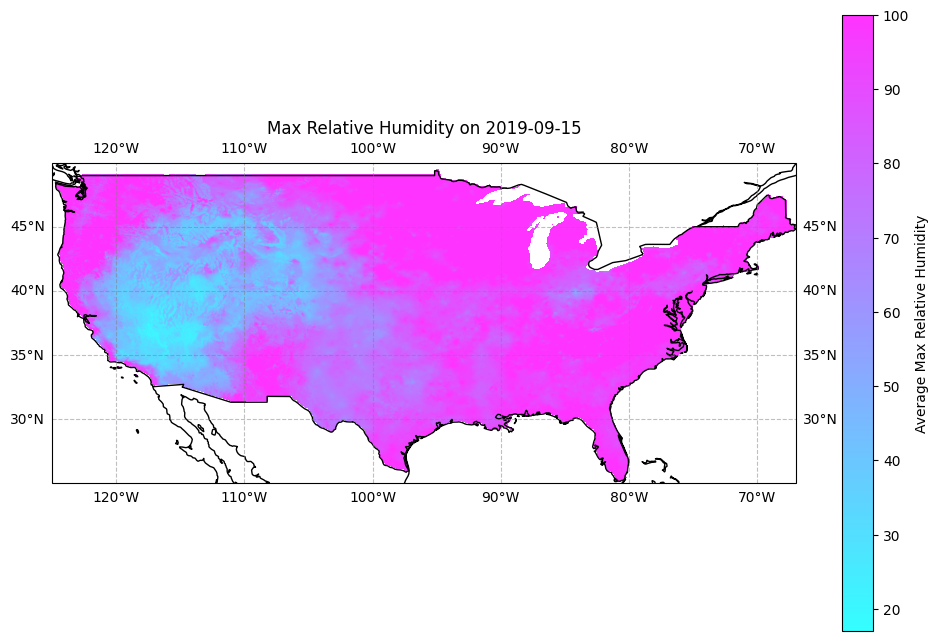

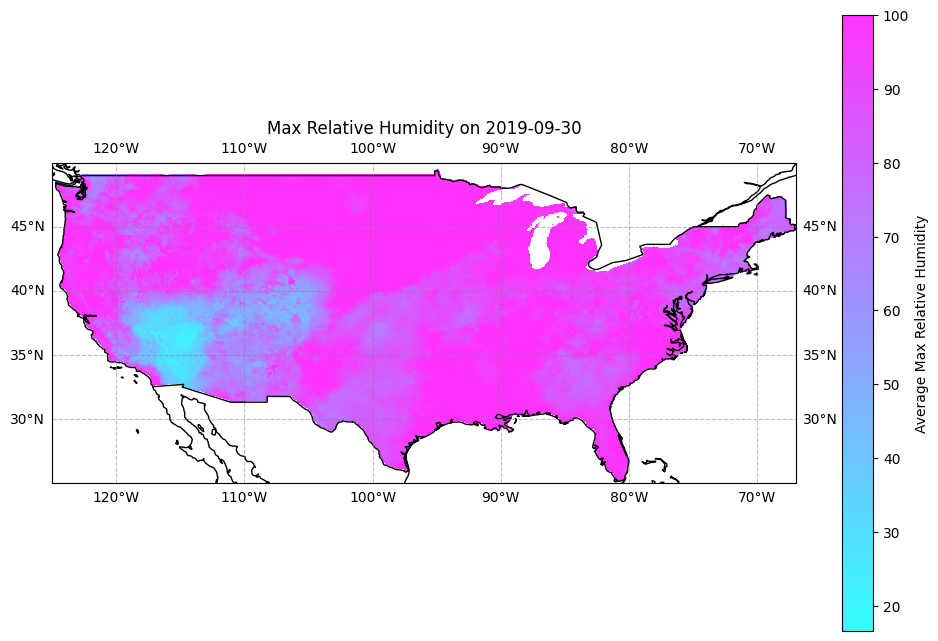

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']

for day in dates_to_plot:
    plot_max_relative_humidity(day)

In [ ]:
def plot_min_relative_humidity(day):

  selected_day = rmin.sel(day=day)

  fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

  ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

  ax.coastlines()
  ax.add_feature(cartopy.feature.BORDERS)

  # Temperature contour fill
  #temp = ax.contourf(
  #   selected_day['lon'],
  #    selected_day['lat'],
  #    selected_day['relative_humidity'],
  #    levels=15,
  #   cmap='seismic_r',
  #    alpha=0.8
  #)
  temp = ax.imshow(
    selected_day['relative_humidity'],
    extent=[selected_day['lon'].min(), selected_day['lon'].max(),
            selected_day['lat'].min(), selected_day['lat'].max()],
    origin='upper',
    cmap='cool',
    alpha=0.8,
    transform=ccrs.PlateCarree()
  )

  fig.colorbar(temp, ax=ax, label='Average Min Relative Humidity')

  gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
  gl.xlabels_top = False
  gl.ylabels_right = False

  ax.set_title("Min Relative Humidity on " + str(day))
  ax.set_xlabel("Longitude")
  ax.set_ylabel("Latitude")
  plt.savefig(f"humidity_plot_{day}.png", dpi=600)
  plt.show()

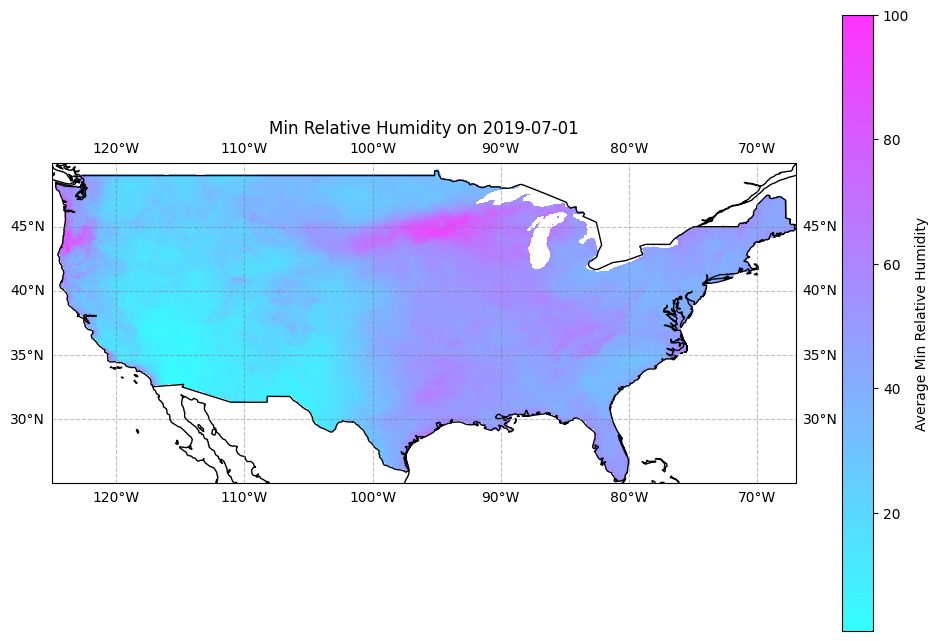

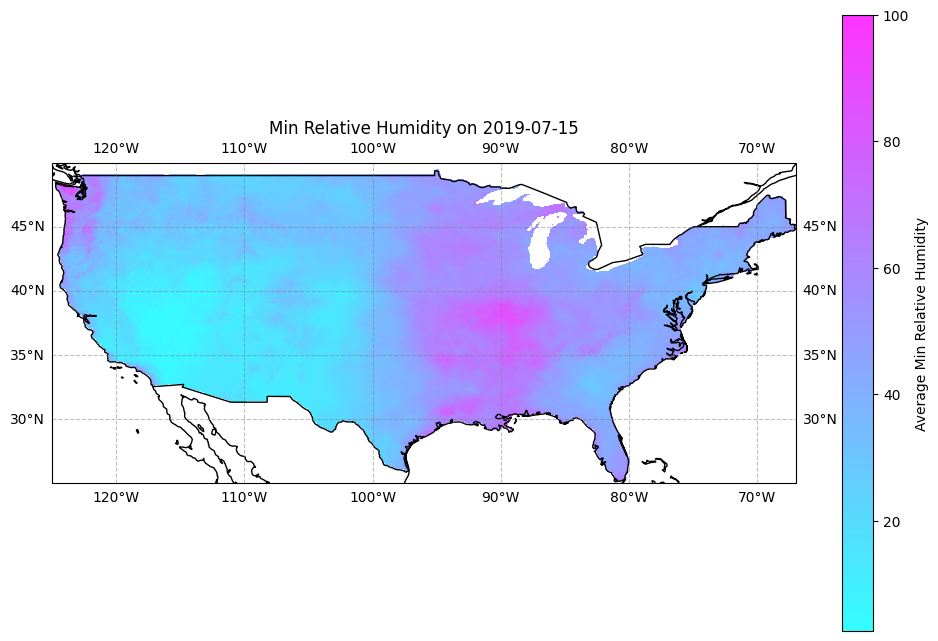

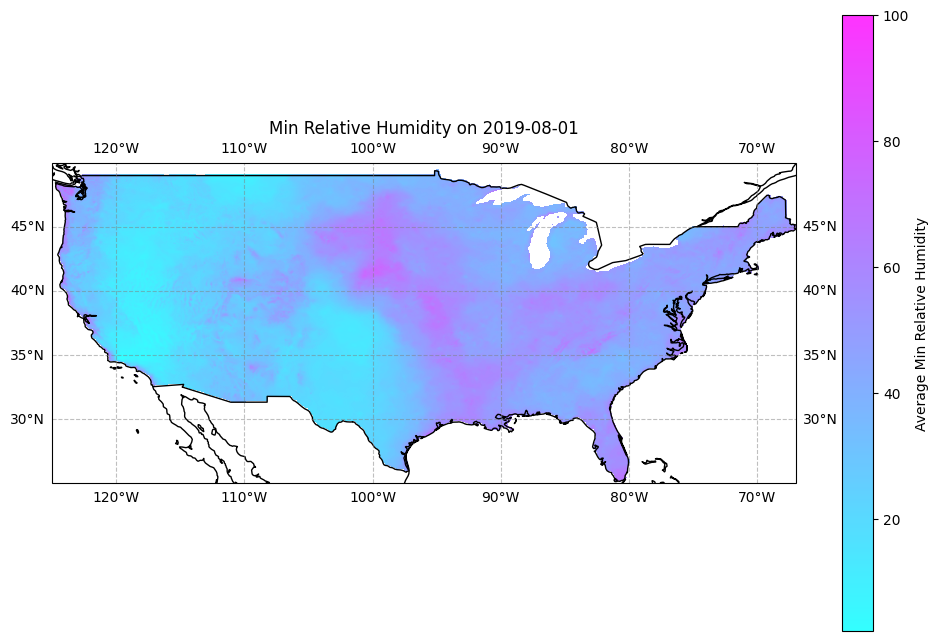

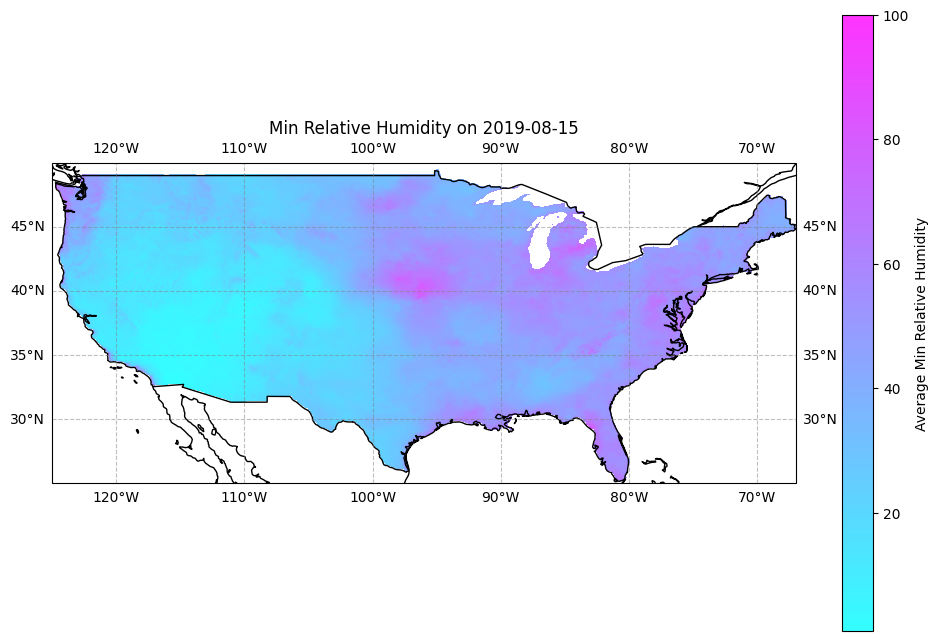

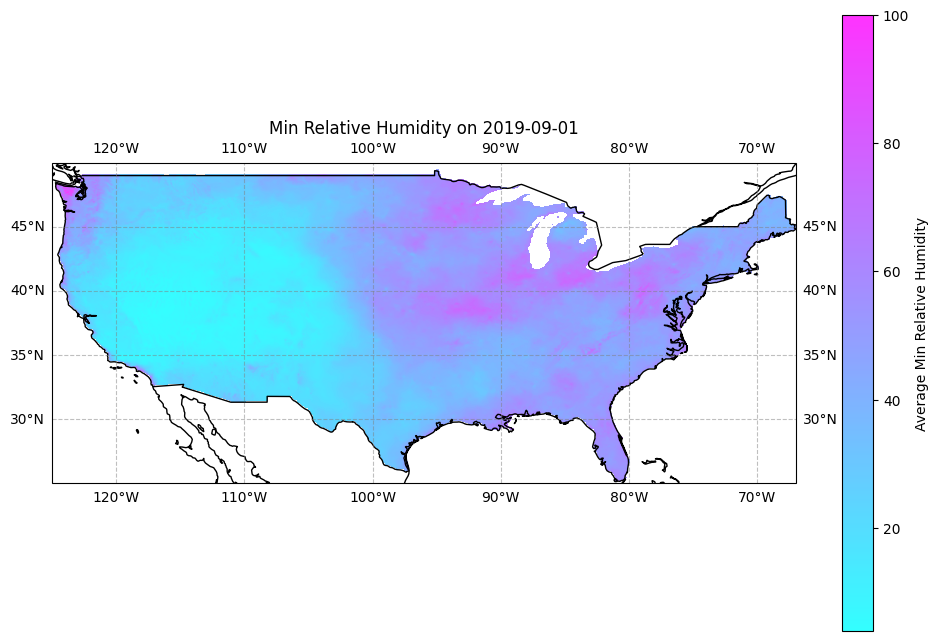

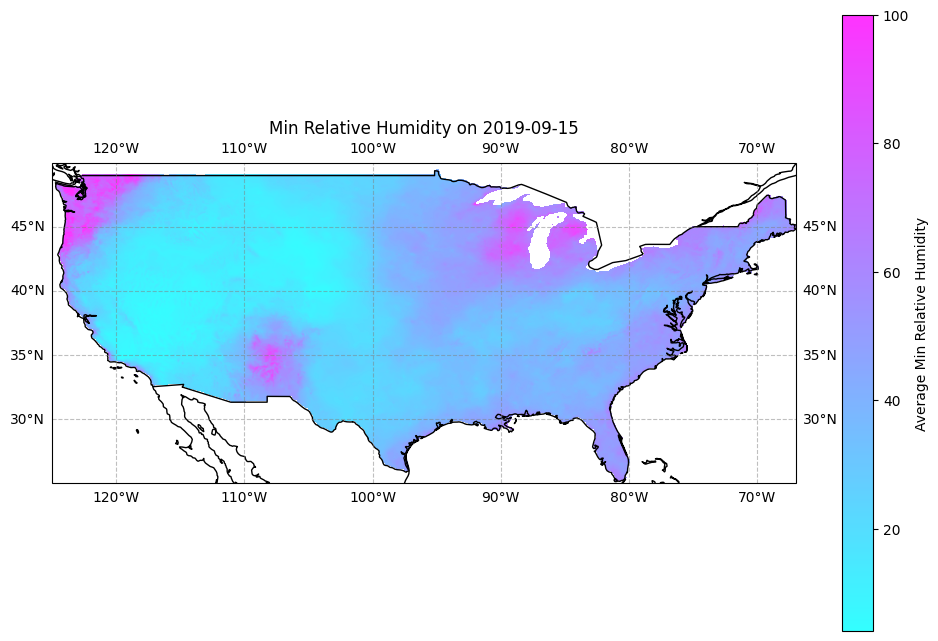

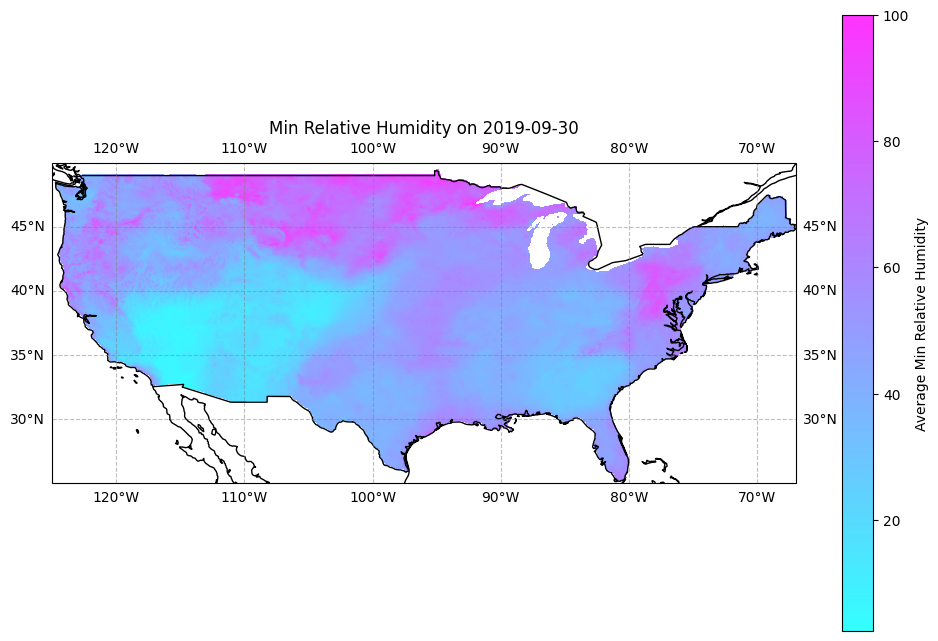

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01', '2019-08-15', '2019-09-01', '2019-09-15','2019-09-30']

for day in dates_to_plot:
    plot_min_relative_humidity(day)

---
**Temperature**
---

In [ ]:
tmmx.head(10)

In [ ]:
def plot_wind_and_climate_for_day(day):
    fig = plt.figure(figsize=(14, 8))
    gs = fig.add_gridspec(1, 2, width_ratios=[5, 0.1])
    ax = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
    ax.set_extent([-125, -67, 25, 50], crs=ccrs.PlateCarree())

    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS)

    day_to_plot = day
    wind_speed_day = wind_ft['wind_speed'].sel(day=day_to_plot)
    wind_direction_day = wind_ft['wind_from_direction'].sel(day=day_to_plot)

    valid_mask = ~np.isnan(wind_speed_day) & ~np.isnan(wind_direction_day)
    lat_values = wind_speed_day.lat.values
    lon_values = wind_speed_day.lon.values
    valid_lats, valid_lons = np.meshgrid(lat_values, lon_values, indexing='ij')

    lon_valid = valid_lons[valid_mask]
    lat_valid = valid_lats[valid_mask]
    wind_speed_valid = wind_speed_day.values[valid_mask]
    wind_direction_valid = wind_direction_day.values[valid_mask]

    lon_grid = np.linspace(-125, -67, 30) # 30 points in longitude range
    lat_grid = np.linspace(25, 50, 25) # 250 points in latitude range
    lon_grid, lat_grid = np.meshgrid(lon_grid, lat_grid)

    grid_speed = griddata((lon_valid, lat_valid), wind_speed_valid, (lon_grid, lat_grid), method='linear')
    grid_direction = griddata((lon_valid, lat_valid), wind_direction_valid, (lon_grid, lat_grid), method='linear')

    u = np.cos(np.deg2rad(grid_direction))
    v = np.sin(np.deg2rad(grid_direction))
    q = ax.quiver(lon_grid, lat_grid, u, v, color='blue', scale_units='xy', scale=0.7)
    temp_day = tmmx['air_temperature'].sel(day=day_to_plot)
    temp_valid_mask = ~np.isnan(temp_day)
    temp_grid = griddata((lon_valid, lat_valid), temp_day.values[temp_valid_mask], (lon_grid, lat_grid), method='linear')
    temp_contour = ax.contourf(lon_grid, lat_grid, temp_grid, cmap='hot', alpha=0.5, levels=15)
    plt.colorbar(temp_contour, ax=ax, orientation='vertical', label='Temperature (°C)')

    gl = ax.gridlines(draw_labels=True, alpha=0.5, color='gray', linestyle='--')
    gl.xlabels_top = False
    gl.ylabels_right = False

    plt.title(f'Wind Speed and Direction with Climate Variables on {day_to_plot}')
    plt.show()

In [ ]:
dates_to_plot = ['2019-07-01', '2019-07-15', '2019-08-01','2019-08-15','2019-09-01', '2019-09-15']
for day in dates_to_plot:
  plot_wind_and_climate_for_day(day)